In [1]:
# https://www.kaggle.com/competitions/hackathon-online-data-science-mini-epidemiology/submissions

In [2]:
!pip install -q kaggle
import json

data = {"username":"tunkedsaro","key":"ff3d00dc680ff94caf6f8d4d9bcd3168"}
json_data = json.dumps(data)

# Write the JSON string to a file
file_path = "/content/kaggle.json"
with open(file_path, 'w') as json_file:
    json_file.write(json_data)

!mkdir ~/.kaggle
!cp /content/kaggle.json ~/.kaggle/ #copy api key ---- depend on your directory -- my directory is .../colab/..
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets list
!kaggle competitions download -c hackathon-online-data-science-mini-epidemiology
!unzip -q /content/hackathon-online-data-science-mini-epidemiology.zip

!pip -q install autogluon.tabular

from autogluon.tabular import TabularDataset, TabularPredictor
import time
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

ref                                                    title                                        size  lastUpdated          downloadCount  voteCount  usabilityRating  
-----------------------------------------------------  ------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
waqi786/cats-dataset                                   🐾 Cats Dataset                                6KB  2024-07-31 06:12:49           1235         24  1.0              
patricklford/global-ev-sales-2010-2024                 Global EV Sales: 2010-2024                   83KB  2024-07-19 13:40:22           2083         29  1.0              
rabieelkharoua/students-performance-dataset            📚 Students Performance Dataset 📚             66KB  2024-06-12 23:09:20          26253        525  1.0              
ihelon/coffee-sales                                    Coffee Sales                                 13KB  2024-08-01 07:55:34           9096     

In [3]:
from sklearn.metrics import mean_squared_error
import numpy as np

# Define a custom RMSE metric
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def pplot(train_df,province:str):
    # province = "Bangkok"
    Songkhla_df = train_df[train_df['PROVINCE']==province]
    plt.figure(figsize=(14,7))
    for year in Songkhla_df['Year'].unique():
        yearly_data = Songkhla_df[Songkhla_df['Year'] == year]
        plt.plot(yearly_data['Week_no'], yearly_data['Count'], label=f'Year {year}')

    plt.xlabel('Week Number')
    plt.ylabel('Count')
    plt.title(f'{province}')
    plt.legend()
    plt.grid(True)
    plt.show()

In [4]:
train_df  = pd.read_csv("/content/Train_set.csv")
test_df   = pd.read_csv("/content/Test_set.csv")
submit_df = pd.read_csv("/content/sample_submission.csv")

In [5]:
pvrecord = {i:0 for i in list(train_df['PROVINCE'].unique())}

<hr>

# Bangkok

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_193202"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.32 GB / 12.67 GB (81.4%)
Disk Space Avail:   74.89 GB / 107.72 GB (69.5%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 38.8142
[2000]	valid_set's rmse: 37.4514
[3000]	valid_set's rmse: 37.4715


	-37.1831	 = Validation score   (-root_mean_squared_error)
	1.4s	 = Training   runtime
	0.03s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's rmse: 32.1916
[2000]	valid_set's rmse: 30.9499
[3000]	valid_set's rmse: 29.9471
[4000]	valid_set's rmse: 29.3834
[5000]	valid_set's rmse: 29.0686
[6000]	valid_set's rmse: 28.9755
[7000]	valid_set's rmse: 29.0519


	-28.93	 = Validation score   (-root_mean_squared_error)
	4.94s	 = Training   runtime
	0.05s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-25.6752	 = Validation score   (-root_mean_squared_error)
	1.35s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-25.6129	 = Validation score   (-root_mean_squared_error)
	1.01s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-32.9958	 = Validation score   (-root_mean_squared_error)
	0.97s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-25.7743	 = Validation score   (-root_mean_squared_error)
	0.67s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-22.9941	 = Validation score   (-root_mean_squared_error)
	4.16s	 = Training   runtime
	0.03s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-28.5942	 = Validation score   (-root_mean_squared_error)
	1.16s	 = Tra

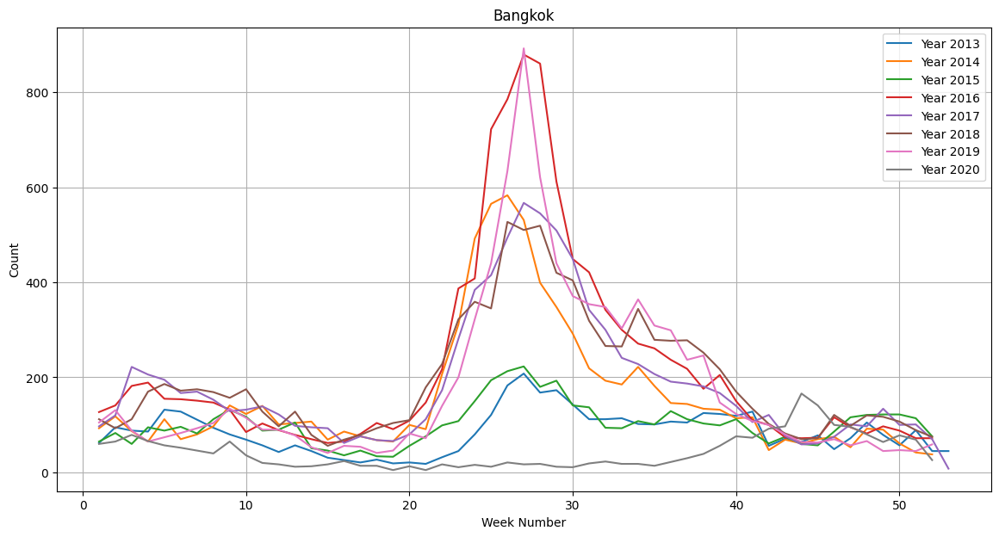


RMSE: 21.6155148122598


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,KNeighborsDist,-15.473326,-15.473326,-27.486195,root_mean_squared_error,0.021544,0.013888,0.011185,0.021544,0.013888,0.011185,1,True,2
1,KNeighborsUnif,-16.275229,-16.275229,-28.409287,root_mean_squared_error,0.030822,0.020427,0.018427,0.030822,0.020427,0.018427,1,True,1
2,LightGBMLarge,-17.501636,-17.501636,-28.594192,root_mean_squared_error,0.037947,0.002228,1.163141,0.037947,0.002228,1.163141,1,True,10
3,NeuralNetTorch,-17.891524,-17.891524,-22.994124,root_mean_squared_error,0.103731,0.028651,4.161331,0.103731,0.028651,4.161331,1,True,9
4,RandomForestMSE,-18.219821,-18.219821,-25.675177,root_mean_squared_error,0.175060,0.075589,1.353892,0.175060,0.075589,1.353892,1,True,5
5,ExtraTreesMSE,-20.130535,-20.130535,-25.612906,root_mean_squared_error,0.359938,0.066908,1.012593,0.359938,0.066908,1.012593,1,True,6
6,WeightedEnsemble_L2,-21.615515,-21.615515,-21.745498,root_mean_squared_error,0.523448,0.106572,10.104607,0.030227,0.000685,0.022599,2,True,11
7,XGBoost,-33.056450,-33.056450,-25.774299,root_mean_squared_error,0.103199,0.005541,0.674053,0.103199,0.005541,0.674053,1,True,8
8,LightGBM,-40.309075,-40.309075,-28.929999,root_mean_squared_error,0.239998,0.051233,4.937171,0.239998,0.051233,4.937171,1,True,4
9,LightGBMXT,-40.614224,-40.614224,-37.183092,root_mean_squared_error,0.109808,0.032512,1.401229,0.109808,0.032512,1.401229,1,True,3


In [85]:
province = "Bangkok"
province_df = train_df[train_df['PROVINCE']==province]
# Split data into train and validation based on the years
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()

# Feature engineering: Create lag features and moving averages
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)

province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()

# Fill NaN values created by lag features
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)

# Select features and target for training
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']

# Select features and target for validation
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']

# Prepare the data for AutoGluon
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val

# Train the AutoGluon model
Bangkok = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)

# Evaluate the model on the validation data
leaderboard = Bangkok.leaderboard(val_data, extra_metrics=['rmse'])

# Get predictions on validation data
y_pred = Bangkok.predict(X_val)

# Calculate and print RMSE on validation data
rmse_value = rmse(y_val, y_pred)

pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
# Update the RMSE value for the province
pvrecord[province] = rmse_value
leaderboard

<hr>

## Samut Prakan

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191258"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.64 GB / 12.67 GB (84.0%)
Disk Space Avail:   76.66 GB / 107.72 GB (71.2%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 7.2243
[2000]	valid_set's rmse: 6.62413
[3000]	valid_set's rmse: 6.34701
[4000]	valid_set's rmse: 6.2017
[5000]	valid_set's rmse: 6.09723
[6000]	valid_set's rmse: 6.00527
[7000]	valid_set's rmse: 5.95087
[8000]	valid_set's rmse: 5.89061
[9000]	valid_set's rmse: 5.85235
[10000]	valid_set's rmse: 5.84428


	-5.8358	 = Validation score   (-root_mean_squared_error)
	8.06s	 = Training   runtime
	0.15s	 = Validation runtime
Fitting model: LightGBM ...
	-6.4473	 = Validation score   (-root_mean_squared_error)
	1.49s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-6.8749	 = Validation score   (-root_mean_squared_error)
	2.2s	 = Training   runtime
	0.15s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-6.756	 = Validation score   (-root_mean_squared_error)
	1.9s	 = Training   runtime
	0.15s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-6.4136	 = Validation score   (-root_mean_squared_error)
	4.18s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: XGBoost ...
	-6.3158	 = Validation score   (-root_mean_squared_error)
	2.26s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-5.2393	 = Validation score   (-root_mean_squared_error)
	23.85s	 = Training   runt

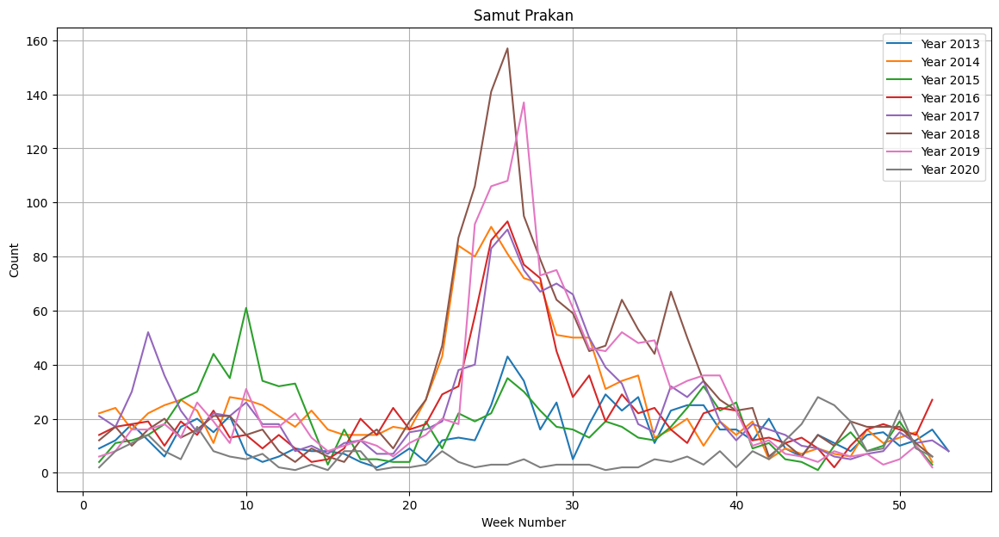


RMSE: 3.3944466442966936


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetTorch,-1.800281,-1.800281,-5.239304,root_mean_squared_error,0.023837,0.032597,23.847473,0.023837,0.032597,23.847473,1,True,9
1,XGBoost,-3.035099,-3.035099,-6.315822,root_mean_squared_error,0.070501,0.015084,2.261692,0.070501,0.015084,2.261692,1,True,8
2,WeightedEnsemble_L2,-3.394447,-3.394447,-4.721723,root_mean_squared_error,1.368957,0.250993,37.721450,0.008703,0.003449,0.145155,2,True,11
3,RandomForestMSE,-3.522516,-3.522516,-6.874888,root_mean_squared_error,0.241991,0.147580,2.200414,0.241991,0.147580,2.200414,1,True,5
4,ExtraTreesMSE,-3.757529,-3.757529,-6.756008,root_mean_squared_error,0.249388,0.153617,1.899887,0.249388,0.153617,1.899887,1,True,6
5,LightGBMLarge,-4.297267,-4.297267,-6.471396,root_mean_squared_error,0.034848,0.003811,2.250866,0.034848,0.003811,2.250866,1,True,10
6,LightGBMXT,-4.972885,-4.972885,-5.835799,root_mean_squared_error,1.175703,0.146880,8.061322,1.175703,0.146880,8.061322,1,True,3
7,LightGBM,-5.597596,-5.597596,-6.447286,root_mean_squared_error,0.099413,0.010069,1.488693,0.099413,0.010069,1.488693,1,True,4
8,KNeighborsUnif,-5.794892,-5.794892,-9.352525,root_mean_squared_error,0.034713,0.051654,0.017385,0.034713,0.051654,0.017385,1,True,1
9,KNeighborsDist,-5.807938,-5.807938,-9.164877,root_mean_squared_error,0.046960,0.063038,0.012725,0.046960,0.063038,0.012725,1,True,2


In [7]:
province = "Samut Prakan"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Samut_Prakan = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Samut_Prakan.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Samut_Prakan.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Nonthaburi

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191353"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.13 GB / 12.67 GB (79.9%)
Disk Space Avail:   76.64 GB / 107.72 GB (71.1%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 4.20566
[2000]	valid_set's rmse: 4.01761
[3000]	valid_set's rmse: 4.00522


	-3.9973	 = Validation score   (-root_mean_squared_error)
	2.21s	 = Training   runtime
	0.04s	 = Validation runtime
Fitting model: LightGBM ...
	-3.468	 = Validation score   (-root_mean_squared_error)
	0.92s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.8675	 = Validation score   (-root_mean_squared_error)
	1.81s	 = Training   runtime
	0.15s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.807	 = Validation score   (-root_mean_squared_error)
	2.73s	 = Training   runtime
	0.19s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-3.4807	 = Validation score   (-root_mean_squared_error)
	2.78s	 = Training   runtime
	0.03s	 = Validation runtime
Fitting model: XGBoost ...
	-3.6296	 = Validation score   (-root_mean_squared_error)
	1.11s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-3.3416	 = Validation score   (-root_mean_squared_error)
	15.49s	 = Training   runt

[1000]	valid_set's rmse: 3.74918
[2000]	valid_set's rmse: 3.7479


	-3.7474	 = Validation score   (-root_mean_squared_error)
	4.16s	 = Training   runtime
	0.05s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetFastAI': 0.391, 'LightGBM': 0.348, 'NeuralNetTorch': 0.261}
	-2.884	 = Validation score   (-root_mean_squared_error)
	0.06s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 34.71s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 1562.9 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_191353")


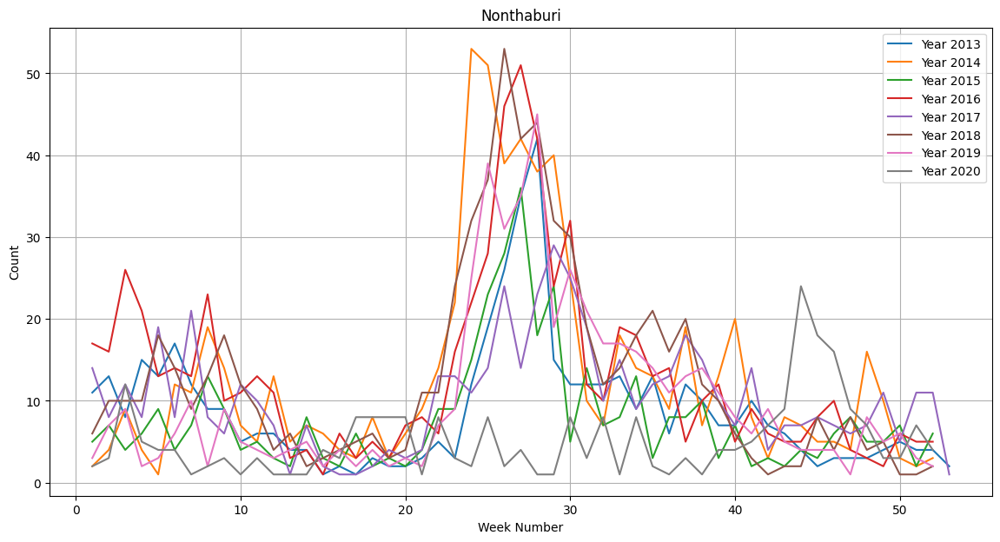


RMSE: 2.023187642429028


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetTorch,-1.643399,-1.643399,-3.341557,root_mean_squared_error,0.035846,0.018961,15.489923,0.035846,0.018961,15.489923,1,True,9
1,LightGBMXT,-1.788811,-1.788811,-3.997331,root_mean_squared_error,0.133836,0.040901,2.208079,0.133836,0.040901,2.208079,1,True,3
2,LightGBMLarge,-1.970123,-1.970123,-3.747358,root_mean_squared_error,0.386228,0.053490,4.163694,0.386228,0.053490,4.163694,1,True,10
3,LightGBM,-2.005725,-2.005725,-3.467993,root_mean_squared_error,0.017350,0.002132,0.923423,0.017350,0.002132,0.923423,1,True,4
4,WeightedEnsemble_L2,-2.023188,-2.023188,-2.884004,root_mean_squared_error,0.144374,0.047347,19.248416,0.031002,0.000925,0.057943,2,True,11
5,ExtraTreesMSE,-2.170151,-2.170151,-3.807009,root_mean_squared_error,0.240471,0.194086,2.725308,0.240471,0.194086,2.725308,1,True,6
6,RandomForestMSE,-2.416611,-2.416611,-3.867503,root_mean_squared_error,0.250480,0.145804,1.808989,0.250480,0.145804,1.808989,1,True,5
7,XGBoost,-2.594912,-2.594912,-3.629600,root_mean_squared_error,0.118572,0.009176,1.105310,0.118572,0.009176,1.105310,1,True,8
8,NeuralNetFastAI,-2.945555,-2.945555,-3.480731,root_mean_squared_error,0.060176,0.025330,2.777128,0.060176,0.025330,2.777128,1,True,7
9,KNeighborsDist,-3.840091,-3.840091,-5.456909,root_mean_squared_error,0.038600,0.048515,0.034514,0.038600,0.048515,0.034514,1,True,2


In [8]:
province = "Nonthaburi"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Nonthaburi = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Nonthaburi.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Nonthaburi.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

# Pathum Thani

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191432"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.08 GB / 12.67 GB (79.5%)
Disk Space Avail:   76.62 GB / 107.72 GB (71.1%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 6.06683
[2000]	valid_set's rmse: 5.9545
[3000]	valid_set's rmse: 5.89554
[4000]	valid_set's rmse: 5.88901
[5000]	valid_set's rmse: 5.8789
[6000]	valid_set's rmse: 5.87373
[7000]	valid_set's rmse: 5.87159
[8000]	valid_set's rmse: 5.87051
[9000]	valid_set's rmse: 5.87009
[10000]	valid_set's rmse: 5.8699


	-5.8699	 = Validation score   (-root_mean_squared_error)
	12.52s	 = Training   runtime
	0.29s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetFastAI': 0.857, 'XGBoost': 0.143}
	-4.5856	 = Validation score   (-root_mean_squared_error)
	0.02s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 35.89s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 1132.1 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_191432")


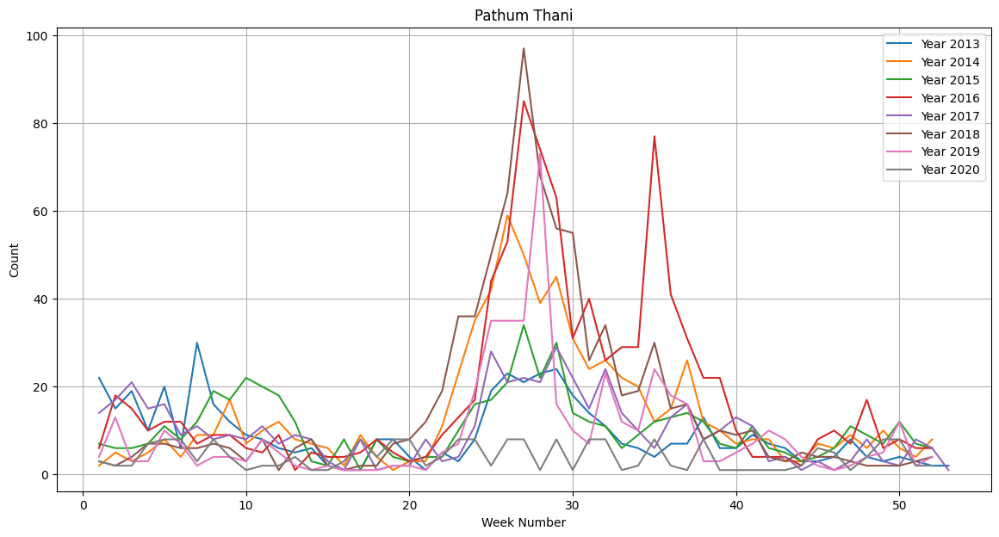


RMSE: 2.1304585961683307


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetTorch,-1.175893,-1.175893,-5.714275,root_mean_squared_error,0.016315,0.011878,7.685005,0.016315,0.011878,7.685005,1,True,9
1,WeightedEnsemble_L2,-2.130459,-2.130459,-4.585561,root_mean_squared_error,0.072141,0.065367,4.546904,0.024504,0.000737,0.024239,2,True,11
2,NeuralNetFastAI,-2.221608,-2.221608,-4.615114,root_mean_squared_error,0.021264,0.036273,2.662786,0.021264,0.036273,2.662786,1,True,7
3,ExtraTreesMSE,-2.297721,-2.297721,-6.046979,root_mean_squared_error,0.087006,0.128774,1.735409,0.087006,0.128774,1.735409,1,True,6
4,LightGBM,-2.407214,-2.407214,-6.218864,root_mean_squared_error,0.003401,0.001498,0.676645,0.003401,0.001498,0.676645,1,True,4
5,LightGBMLarge,-2.711696,-2.711696,-5.869901,root_mean_squared_error,1.010995,0.289661,12.516700,1.010995,0.289661,12.516700,1,True,10
6,LightGBMXT,-2.714308,-2.714308,-7.404415,root_mean_squared_error,0.003516,0.010599,0.900787,0.003516,0.010599,0.900787,1,True,3
7,RandomForestMSE,-3.131820,-3.131820,-6.569036,root_mean_squared_error,0.084676,0.123078,1.896337,0.084676,0.123078,1.896337,1,True,5
8,KNeighborsDist,-3.840310,-3.840310,-6.426449,root_mean_squared_error,0.015842,0.047805,0.018831,0.015842,0.047805,0.018831,1,True,2
9,KNeighborsUnif,-3.861347,-3.861347,-6.630071,root_mean_squared_error,0.030342,0.092519,0.019583,0.030342,0.092519,0.019583,1,True,1


In [9]:
province = "Pathum Thani"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Pathum_Thani = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Pathum_Thani.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Pathum_Thani.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<hr>

## Phra Nakhon Si Ayutthaya

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191510"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.69 GB / 12.67 GB (84.4%)
Disk Space Avail:   76.56 GB / 107.72 GB (71.1%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 4.67672


	-4.2557	 = Validation score   (-root_mean_squared_error)
	0.42s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-5.3054	 = Validation score   (-root_mean_squared_error)
	1.22s	 = Training   runtime
	0.1s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-4.3838	 = Validation score   (-root_mean_squared_error)
	1.41s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-4.196	 = Validation score   (-root_mean_squared_error)
	1.73s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-5.1893	 = Validation score   (-root_mean_squared_error)
	0.57s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-4.0781	 = Validation score   (-root_mean_squared_error)
	3.63s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-4.1131	 = Validation score   (-root_mean_squared_error)
	0.78s	 = Training   

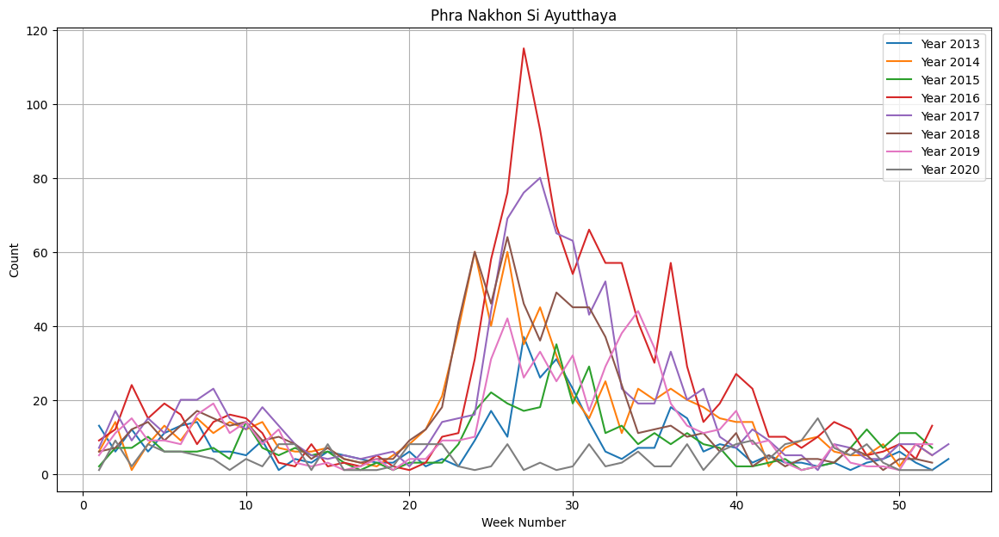


RMSE: 2.123290632423773


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,LightGBM,-1.820915,-1.820915,-4.255743,root_mean_squared_error,0.007020,0.002410,0.417241,0.007020,0.002410,0.417241,1,True,4
1,XGBoost,-2.050349,-2.050349,-5.189314,root_mean_squared_error,0.031199,0.008041,0.573254,0.031199,0.008041,0.573254,1,True,8
2,RandomForestMSE,-2.070369,-2.070369,-5.305367,root_mean_squared_error,0.094193,0.097519,1.221318,0.094193,0.097519,1.221318,1,True,5
3,ExtraTreesMSE,-2.109438,-2.109438,-4.383778,root_mean_squared_error,0.087273,0.076825,1.405377,0.087273,0.076825,1.405377,1,True,6
4,WeightedEnsemble_L2,-2.123291,-2.123291,-3.336183,root_mean_squared_error,0.075863,0.032948,6.579948,0.005775,0.000751,0.023757,2,True,11
5,NeuralNetTorch,-2.141211,-2.141211,-4.078104,root_mean_squared_error,0.015960,0.012372,3.628700,0.015960,0.012372,3.628700,1,True,9
6,LightGBMLarge,-2.177033,-2.177033,-4.113096,root_mean_squared_error,0.025924,0.004963,0.777941,0.025924,0.004963,0.777941,1,True,10
7,LightGBMXT,-2.683909,-2.683909,-4.662287,root_mean_squared_error,0.023786,0.006595,0.561898,0.023786,0.006595,0.561898,1,True,3
8,NeuralNetFastAI,-2.898651,-2.898651,-4.195950,root_mean_squared_error,0.021185,0.012451,1.732309,0.021185,0.012451,1.732309,1,True,7
9,KNeighborsUnif,-4.004805,-4.004805,-4.941714,root_mean_squared_error,0.014688,0.031037,0.030030,0.014688,0.031037,0.030030,1,True,1


In [10]:
province = "Phra Nakhon Si Ayutthaya"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Phra_Nakhon_Si_Ayutthaya = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Phra_Nakhon_Si_Ayutthaya.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Phra_Nakhon_Si_Ayutthaya.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<hr>

## Ang Thong

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191523"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.68 GB / 12.67 GB (84.3%)
Disk Space Avail:   76.54 GB / 107.72 GB (71.1%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.36736
[2000]	valid_set's rmse: 2.10152
[3000]	valid_set's rmse: 1.9645
[4000]	valid_set's rmse: 1.87314
[5000]	valid_set's rmse: 1.81346
[6000]	valid_set's rmse: 1.79634
[7000]	valid_set's rmse: 1.76076
[8000]	valid_set's rmse: 1.75717
[9000]	valid_set's rmse: 1.75492
[10000]	valid_set's rmse: 1.75859


	-1.7487	 = Validation score   (-root_mean_squared_error)
	2.65s	 = Training   runtime
	0.05s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's rmse: 2.63633
[2000]	valid_set's rmse: 2.33214
[3000]	valid_set's rmse: 2.21025
[4000]	valid_set's rmse: 2.20057


	-2.1972	 = Validation score   (-root_mean_squared_error)
	2.78s	 = Training   runtime
	0.04s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.2537	 = Validation score   (-root_mean_squared_error)
	1.22s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-1.9853	 = Validation score   (-root_mean_squared_error)
	0.94s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.0849	 = Validation score   (-root_mean_squared_error)
	0.95s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-1.7928	 = Validation score   (-root_mean_squared_error)
	0.36s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.5851	 = Validation score   (-root_mean_squared_error)
	4.29s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-1.7943	 = Validation score   (-root_mean_squared_error)
	0.71s	 = Training

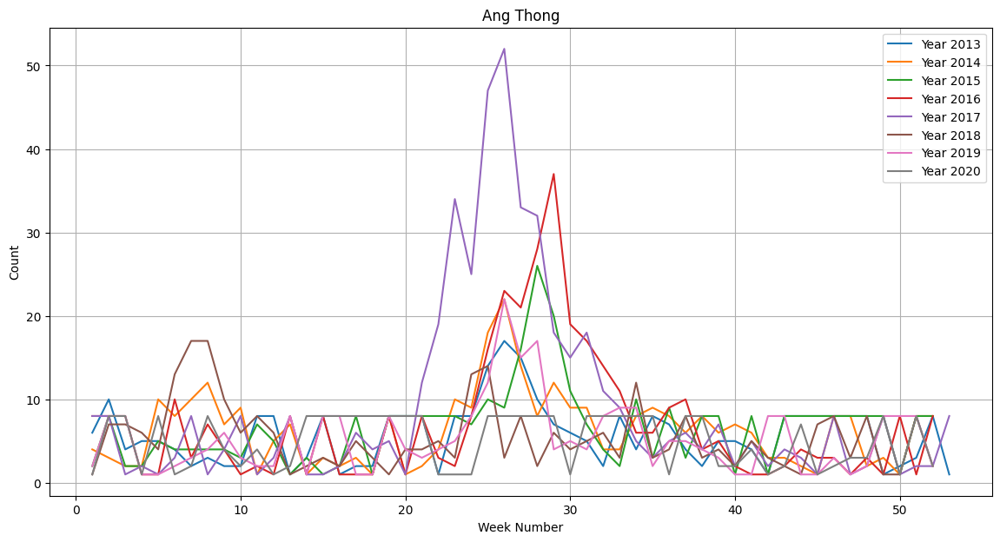


RMSE: 0.9670711168195607


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,ExtraTreesMSE,-0.898763,-0.898763,-1.985265,root_mean_squared_error,0.098290,0.066949,0.935555,0.098290,0.066949,0.935555,1,True,6
1,RandomForestMSE,-0.923095,-0.923095,-2.253686,root_mean_squared_error,0.083745,0.055818,1.219733,0.083745,0.055818,1.219733,1,True,5
2,XGBoost,-0.928872,-0.928872,-1.792782,root_mean_squared_error,0.018413,0.015035,0.357370,0.018413,0.015035,0.357370,1,True,8
3,WeightedEnsemble_L2,-0.967071,-0.967071,-1.231063,root_mean_squared_error,0.253316,0.095244,8.266817,0.005952,0.000747,0.023528,2,True,11
4,LightGBMLarge,-1.074854,-1.074854,-1.794258,root_mean_squared_error,0.023907,0.004129,0.708183,0.023907,0.004129,0.708183,1,True,10
5,LightGBMXT,-1.374689,-1.374689,-1.748661,root_mean_squared_error,0.189849,0.054521,2.646695,0.189849,0.054521,2.646695,1,True,3
6,LightGBM,-1.413494,-1.413494,-2.197248,root_mean_squared_error,0.105439,0.036533,2.775462,0.105439,0.036533,2.775462,1,True,4
7,NeuralNetTorch,-1.930654,-1.930654,-1.585061,root_mean_squared_error,0.015698,0.012809,4.287461,0.015698,0.012809,4.287461,1,True,9
8,NeuralNetFastAI,-1.982171,-1.982171,-2.084902,root_mean_squared_error,0.023404,0.012132,0.951764,0.023404,0.012132,0.951764,1,True,7
9,KNeighborsDist,-3.000534,-3.000534,-3.163184,root_mean_squared_error,0.014494,0.016230,0.011501,0.014494,0.016230,0.011501,1,True,2


In [11]:
province = "Ang Thong"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Ang_Thong = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Ang_Thong.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Ang_Thong.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Lopburi

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191542"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.68 GB / 12.67 GB (84.3%)
Disk Space Avail:   76.52 GB / 107.72 GB (71.0%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 4.44194
[2000]	valid_set's rmse: 4.17129


	-4.1437	 = Validation score   (-root_mean_squared_error)
	1.7s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-5.6389	 = Validation score   (-root_mean_squared_error)
	0.74s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-4.5498	 = Validation score   (-root_mean_squared_error)
	1.29s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-4.7881	 = Validation score   (-root_mean_squared_error)
	0.97s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-4.9862	 = Validation score   (-root_mean_squared_error)
	0.96s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-4.3408	 = Validation score   (-root_mean_squared_error)
	0.52s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-3.752	 = Validation score   (-root_mean_squared_error)
	5.14s	 = Training   runt

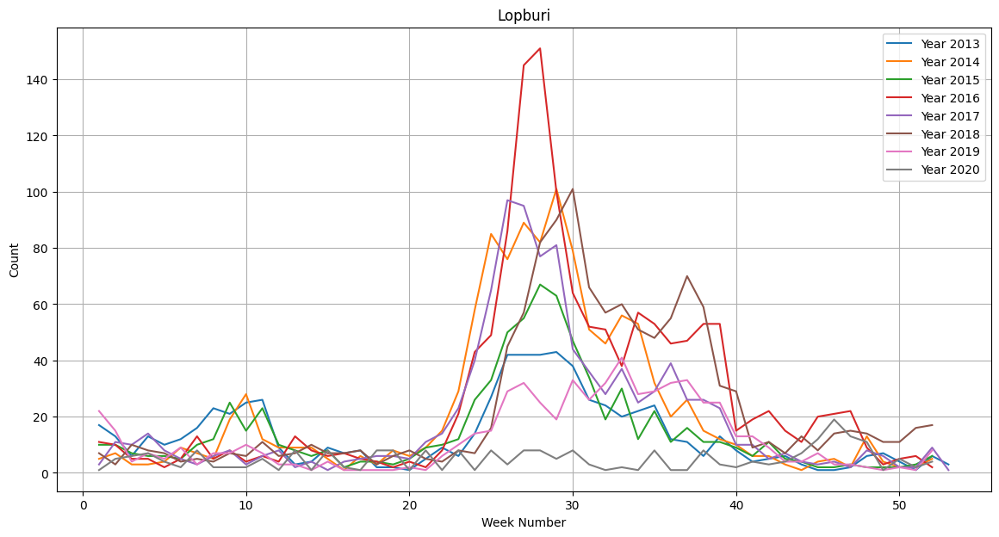


RMSE: 1.7906862385845088


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-1.790686,-1.790686,-3.182536,root_mean_squared_error,0.154063,0.048104,7.836348,0.004519,0.000840,0.034418,2,True,11
1,NeuralNetTorch,-1.852639,-1.852639,-3.751955,root_mean_squared_error,0.026678,0.012085,5.138313,0.026678,0.012085,5.138313,1,True,9
2,LightGBMXT,-2.061666,-2.061666,-4.143743,root_mean_squared_error,0.081661,0.023548,1.704634,0.081661,0.023548,1.704634,1,True,3
3,LightGBM,-2.288051,-2.288051,-5.638938,root_mean_squared_error,0.006365,0.007184,0.738217,0.006365,0.007184,0.738217,1,True,4
4,ExtraTreesMSE,-2.627673,-2.627673,-4.788104,root_mean_squared_error,0.147288,0.066720,0.973089,0.147288,0.066720,0.973089,1,True,6
5,RandomForestMSE,-2.819446,-2.819446,-4.549764,root_mean_squared_error,0.123703,0.066724,1.288859,0.123703,0.066724,1.288859,1,True,5
6,LightGBMLarge,-3.070497,-3.070497,-5.062736,root_mean_squared_error,0.007922,0.001900,0.538408,0.007922,0.001900,0.538408,1,True,10
7,NeuralNetFastAI,-3.186573,-3.186573,-4.986151,root_mean_squared_error,0.041204,0.011631,0.958983,0.041204,0.011631,0.958983,1,True,7
8,XGBoost,-3.381407,-3.381407,-4.340811,root_mean_squared_error,0.050300,0.006185,0.518635,0.050300,0.006185,0.518635,1,True,8
9,KNeighborsUnif,-3.923009,-3.923009,-6.180790,root_mean_squared_error,0.020618,0.026493,0.018679,0.020618,0.026493,0.018679,1,True,1


In [12]:
province = "Lopburi"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Lopburi = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Lopburi.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Lopburi.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Sing Buri

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191557"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.65 GB / 12.67 GB (84.1%)
Disk Space Avail:   76.50 GB / 107.72 GB (71.0%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 4.09638
[2000]	valid_set's rmse: 4.08406


	-4.0638	 = Validation score   (-root_mean_squared_error)
	1.56s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-4.0747	 = Validation score   (-root_mean_squared_error)
	0.73s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-4.0675	 = Validation score   (-root_mean_squared_error)
	1.09s	 = Training   runtime
	0.11s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-4.1383	 = Validation score   (-root_mean_squared_error)
	1.45s	 = Training   runtime
	0.15s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.9835	 = Validation score   (-root_mean_squared_error)
	2.05s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-4.1536	 = Validation score   (-root_mean_squared_error)
	0.79s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.5311	 = Validation score   (-root_mean_squared_error)
	10.9s	 = Training   run

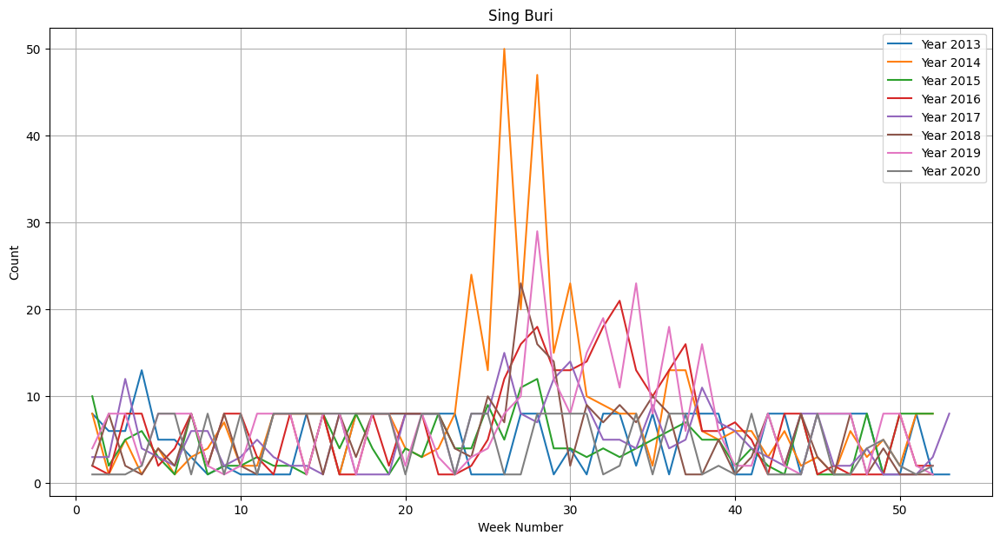


RMSE: 1.112454920458186


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetTorch,-0.570853,-0.570853,-2.531066,root_mean_squared_error,0.034234,0.028499,10.898313,0.034234,0.028499,10.898313,1,True,9
1,LightGBMXT,-0.936548,-0.936548,-4.063761,root_mean_squared_error,0.110885,0.024526,1.556852,0.110885,0.024526,1.556852,1,True,3
2,ExtraTreesMSE,-1.000029,-1.000029,-4.138310,root_mean_squared_error,0.144729,0.150246,1.447217,0.144729,0.150246,1.447217,1,True,6
3,LightGBM,-1.063830,-1.063830,-4.074736,root_mean_squared_error,0.020654,0.002920,0.734189,0.020654,0.002920,0.734189,1,True,4
4,WeightedEnsemble_L2,-1.112455,-1.112455,-1.909986,root_mean_squared_error,0.081660,0.041353,13.012805,0.013808,0.000777,0.060838,2,True,11
5,RandomForestMSE,-1.208913,-1.208913,-4.067506,root_mean_squared_error,0.185108,0.112650,1.091486,0.185108,0.112650,1.091486,1,True,5
6,LightGBMLarge,-1.362512,-1.362512,-3.372039,root_mean_squared_error,0.042428,0.003981,1.624510,0.042428,0.003981,1.624510,1,True,10
7,NeuralNetFastAI,-1.394566,-1.394566,-1.983463,root_mean_squared_error,0.033618,0.012077,2.053654,0.033618,0.012077,2.053654,1,True,7
8,XGBoost,-1.639594,-1.639594,-4.153609,root_mean_squared_error,0.068535,0.007535,0.788236,0.068535,0.007535,0.788236,1,True,8
9,KNeighborsDist,-3.088280,-3.088280,-5.561712,root_mean_squared_error,0.023413,0.033725,0.013260,0.023413,0.033725,0.013260,1,True,2


In [13]:
province = "Sing Buri"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Sing_Buri = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Sing_Buri.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Sing_Buri.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Chainat

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191621"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.45 GB / 12.67 GB (82.5%)
Disk Space Avail:   76.49 GB / 107.72 GB (71.0%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 1.96995
[2000]	valid_set's rmse: 1.85312


	-1.8471	 = Validation score   (-root_mean_squared_error)
	1.7s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-1.7913	 = Validation score   (-root_mean_squared_error)
	1.94s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...


[1000]	valid_set's rmse: 1.81069


	-2.1218	 = Validation score   (-root_mean_squared_error)
	1.64s	 = Training   runtime
	0.11s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.2044	 = Validation score   (-root_mean_squared_error)
	1.13s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.7674	 = Validation score   (-root_mean_squared_error)
	0.95s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.0126	 = Validation score   (-root_mean_squared_error)
	0.49s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.5811	 = Validation score   (-root_mean_squared_error)
	6.39s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-1.8238	 = Validation score   (-root_mean_squared_error)
	0.95s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.458, 'LightGBMLarge': 0.333, 'Ne

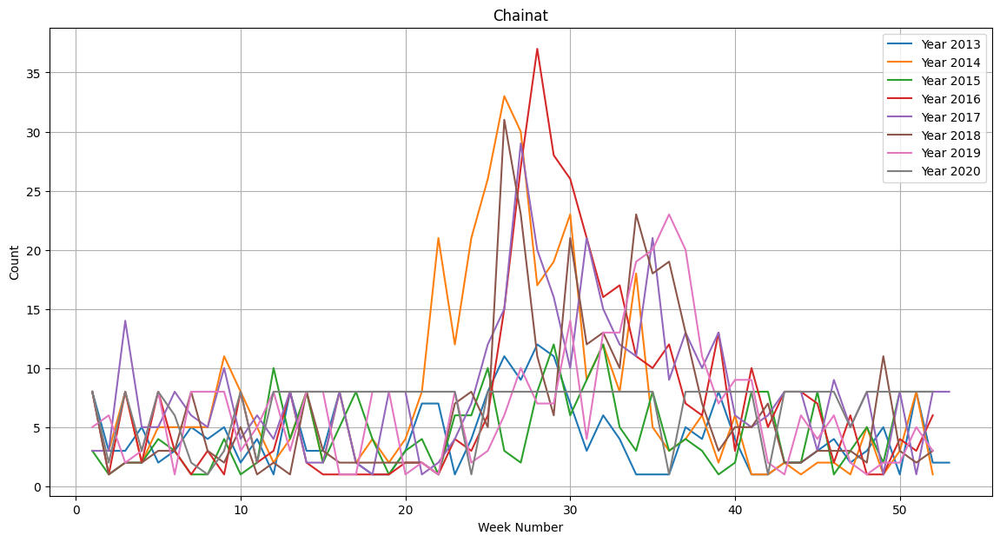


RMSE: 1.1486345953229538


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,XGBoost,-0.536051,-0.536051,-2.012643,root_mean_squared_error,0.055972,0.011901,0.493302,0.055972,0.011901,0.493302,1,True,8
1,LightGBMXT,-0.874585,-0.874585,-1.847092,root_mean_squared_error,0.077046,0.014619,1.704744,0.077046,0.014619,1.704744,1,True,3
2,ExtraTreesMSE,-0.892010,-0.892010,-2.204373,root_mean_squared_error,0.127423,0.067596,1.129377,0.127423,0.067596,1.129377,1,True,6
3,RandomForestMSE,-0.901790,-0.901790,-2.121804,root_mean_squared_error,0.133880,0.107925,1.637086,0.133880,0.107925,1.637086,1,True,5
4,LightGBM,-1.083492,-1.083492,-1.791252,root_mean_squared_error,0.046458,0.008420,1.938086,0.046458,0.008420,1.938086,1,True,4
5,WeightedEnsemble_L2,-1.148635,-1.148635,-1.205813,root_mean_squared_error,0.212398,0.048834,10.249336,0.008043,0.000733,0.024735,2,True,11
6,LightGBMLarge,-1.341816,-1.341816,-1.823794,root_mean_squared_error,0.066768,0.014301,0.949187,0.066768,0.014301,0.949187,1,True,10
7,NeuralNetFastAI,-1.364380,-1.364380,-1.767384,root_mean_squared_error,0.057874,0.012158,0.947857,0.057874,0.012158,0.947857,1,True,7
8,NeuralNetTorch,-1.556233,-1.556233,-1.581150,root_mean_squared_error,0.033254,0.013223,6.389472,0.033254,0.013223,6.389472,1,True,9
9,KNeighborsUnif,-3.439924,-3.439924,-3.857881,root_mean_squared_error,0.034786,0.062642,0.036059,0.034786,0.062642,0.036059,1,True,1


In [14]:
province = "Chainat"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Chainat = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Chainat.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Chainat.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Saraburi

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191641"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.38 GB / 12.67 GB (81.9%)
Disk Space Avail:   76.47 GB / 107.72 GB (71.0%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

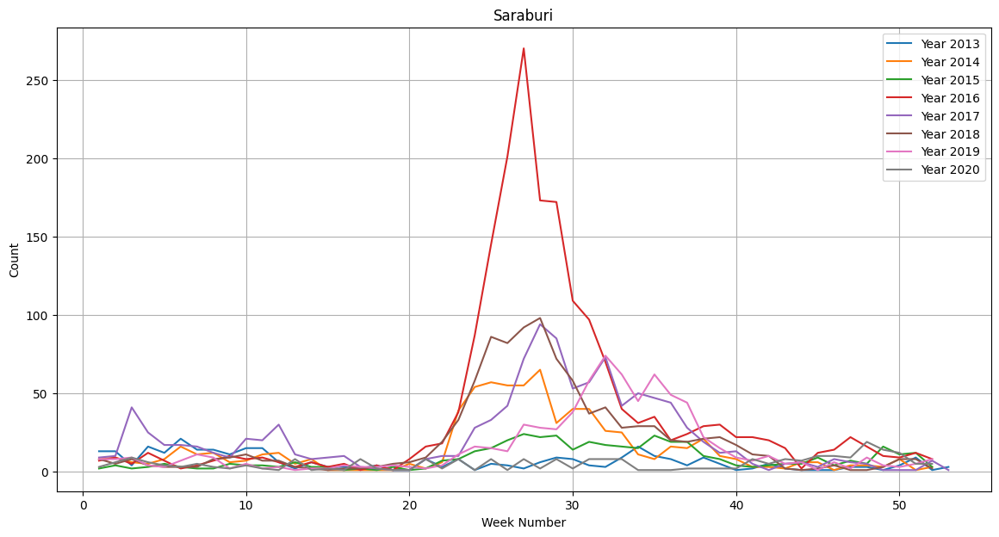


RMSE: 2.4741065824312343


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,ExtraTreesMSE,-1.825221,-1.825221,-5.006551,root_mean_squared_error,0.094223,0.066031,0.962369,0.094223,0.066031,0.962369,1,True,6
1,RandomForestMSE,-1.970788,-1.970788,-4.986294,root_mean_squared_error,0.083786,0.070179,1.203559,0.083786,0.070179,1.203559,1,True,5
2,LightGBM,-2.377401,-2.377401,-7.107114,root_mean_squared_error,0.003077,0.001672,0.715713,0.003077,0.001672,0.715713,1,True,4
3,LightGBMLarge,-2.426469,-2.426469,-5.750319,root_mean_squared_error,0.022185,0.003265,0.626593,0.022185,0.003265,0.626593,1,True,10
4,XGBoost,-2.436061,-2.436061,-5.723092,root_mean_squared_error,0.044867,0.008311,0.631706,0.044867,0.008311,0.631706,1,True,8
5,WeightedEnsemble_L2,-2.474107,-2.474107,-4.144782,root_mean_squared_error,0.202931,0.146610,6.211550,0.006432,0.000759,0.024960,2,True,11
6,LightGBMXT,-3.289804,-3.289804,-7.890167,root_mean_squared_error,0.002712,0.001385,0.736769,0.002712,0.001385,0.736769,1,True,3
7,KNeighborsDist,-3.301857,-3.301857,-5.568524,root_mean_squared_error,0.014458,0.026938,0.013977,0.014458,0.026938,0.013977,1,True,2
8,KNeighborsUnif,-3.318827,-3.318827,-5.519744,root_mean_squared_error,0.014904,0.042345,0.011188,0.014904,0.042345,0.011188,1,True,1
9,NeuralNetTorch,-3.512239,-3.512239,-4.687083,root_mean_squared_error,0.016411,0.011952,2.658468,0.016411,0.011952,2.658468,1,True,9


In [15]:
province = "Saraburi"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Saraburi = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Saraburi.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Saraburi.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Chonburi

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191652"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.39 GB / 12.67 GB (82.0%)
Disk Space Avail:   76.46 GB / 107.72 GB (71.0%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 9.68367
[2000]	valid_set's rmse: 9.47689
[3000]	valid_set's rmse: 9.26753
[4000]	valid_set's rmse: 9.04888
[5000]	valid_set's rmse: 8.88101
[6000]	valid_set's rmse: 8.70093
[7000]	valid_set's rmse: 8.55481
[8000]	valid_set's rmse: 8.43606
[9000]	valid_set's rmse: 8.344
[10000]	valid_set's rmse: 8.24533


	-8.2409	 = Validation score   (-root_mean_squared_error)
	4.16s	 = Training   runtime
	0.17s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's rmse: 7.77199
[2000]	valid_set's rmse: 7.28754
[3000]	valid_set's rmse: 6.95596
[4000]	valid_set's rmse: 6.70118
[5000]	valid_set's rmse: 6.54192
[6000]	valid_set's rmse: 6.44675
[7000]	valid_set's rmse: 6.35791
[8000]	valid_set's rmse: 6.30293
[9000]	valid_set's rmse: 6.27275
[10000]	valid_set's rmse: 6.24014


	-6.2394	 = Validation score   (-root_mean_squared_error)
	3.99s	 = Training   runtime
	0.15s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-7.3726	 = Validation score   (-root_mean_squared_error)
	1.16s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-8.0573	 = Validation score   (-root_mean_squared_error)
	1.0s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-7.445	 = Validation score   (-root_mean_squared_error)
	0.97s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-6.1418	 = Validation score   (-root_mean_squared_error)
	0.69s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-7.8447	 = Validation score   (-root_mean_squared_error)
	6.36s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-7.7685	 = Validation score   (-root_mean_squared_error)
	0.98s	 = Training  

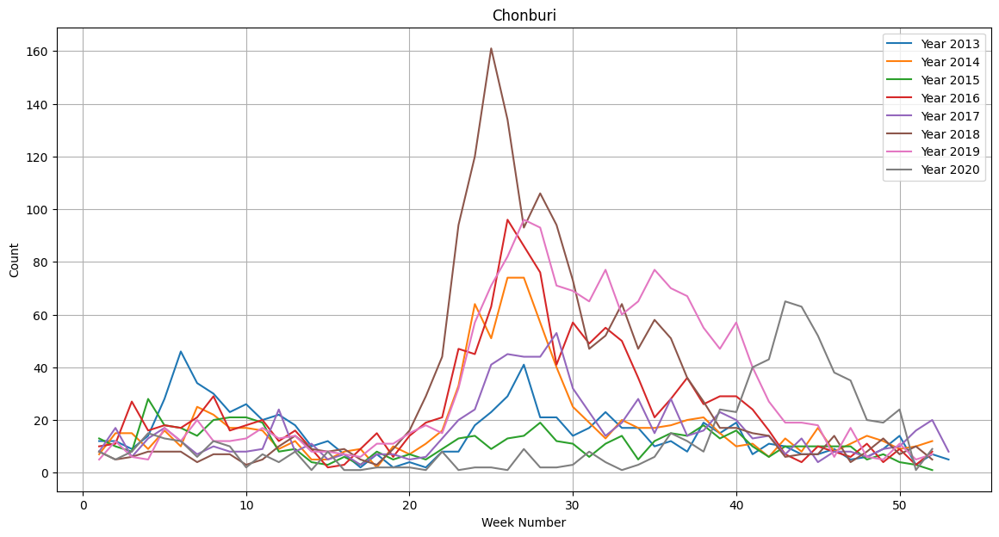


RMSE: 4.661940398322936


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,RandomForestMSE,-4.317706,-4.317706,-7.372558,root_mean_squared_error,0.121604,0.066365,1.164725,0.121604,0.066365,1.164725,1,True,5
1,ExtraTreesMSE,-4.400387,-4.400387,-8.057283,root_mean_squared_error,0.096024,0.066255,1.002877,0.096024,0.066255,1.002877,1,True,6
2,XGBoost,-4.483345,-4.483345,-6.141817,root_mean_squared_error,0.027130,0.008477,0.690092,0.027130,0.008477,0.690092,1,True,8
3,LightGBMLarge,-4.635981,-4.635981,-7.768546,root_mean_squared_error,0.009318,0.002535,0.982682,0.009318,0.002535,0.982682,1,True,10
4,WeightedEnsemble_L2,-4.661940,-4.661940,-5.903524,root_mean_squared_error,0.263937,0.157512,4.702158,0.003538,0.000952,0.023490,2,True,11
5,NeuralNetTorch,-5.444974,-5.444974,-7.844655,root_mean_squared_error,0.013580,0.011992,6.364907,0.013580,0.011992,6.364907,1,True,9
6,LightGBMXT,-5.586577,-5.586577,-8.240896,root_mean_squared_error,0.135986,0.166000,4.155516,0.135986,0.166000,4.155516,1,True,3
7,KNeighborsUnif,-6.572612,-6.572612,-11.438649,root_mean_squared_error,0.056285,0.028644,0.008414,0.056285,0.028644,0.008414,1,True,1
8,KNeighborsDist,-6.604319,-6.604319,-11.479185,root_mean_squared_error,0.022746,0.016344,0.008045,0.022746,0.016344,0.008045,1,True,2
9,LightGBM,-6.898453,-6.898453,-6.239371,root_mean_squared_error,0.233269,0.148084,3.988576,0.233269,0.148084,3.988576,1,True,4


In [16]:
province = "Chonburi"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Chonburi = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Chonburi.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Chonburi.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Rayong

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191716"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.55 GB / 12.67 GB (83.3%)
Disk Space Avail:   76.43 GB / 107.72 GB (71.0%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 8.54297
[2000]	valid_set's rmse: 7.8239
[3000]	valid_set's rmse: 7.42357
[4000]	valid_set's rmse: 7.30631
[5000]	valid_set's rmse: 7.27997
[6000]	valid_set's rmse: 7.24063
[7000]	valid_set's rmse: 7.20878
[8000]	valid_set's rmse: 7.18194
[9000]	valid_set's rmse: 7.24659
[10000]	valid_set's rmse: 7.20872


	-7.1667	 = Validation score   (-root_mean_squared_error)
	1.67s	 = Training   runtime
	0.05s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's rmse: 7.72399


	-7.6929	 = Validation score   (-root_mean_squared_error)
	0.66s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-6.6518	 = Validation score   (-root_mean_squared_error)
	0.66s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-5.4154	 = Validation score   (-root_mean_squared_error)
	0.95s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-7.5856	 = Validation score   (-root_mean_squared_error)
	1.39s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-7.113	 = Validation score   (-root_mean_squared_error)
	0.59s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-4.7232	 = Validation score   (-root_mean_squared_error)
	3.95s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-6.289	 = Validation score   (-root_mean_squared_error)
	0.56s	 = Training  

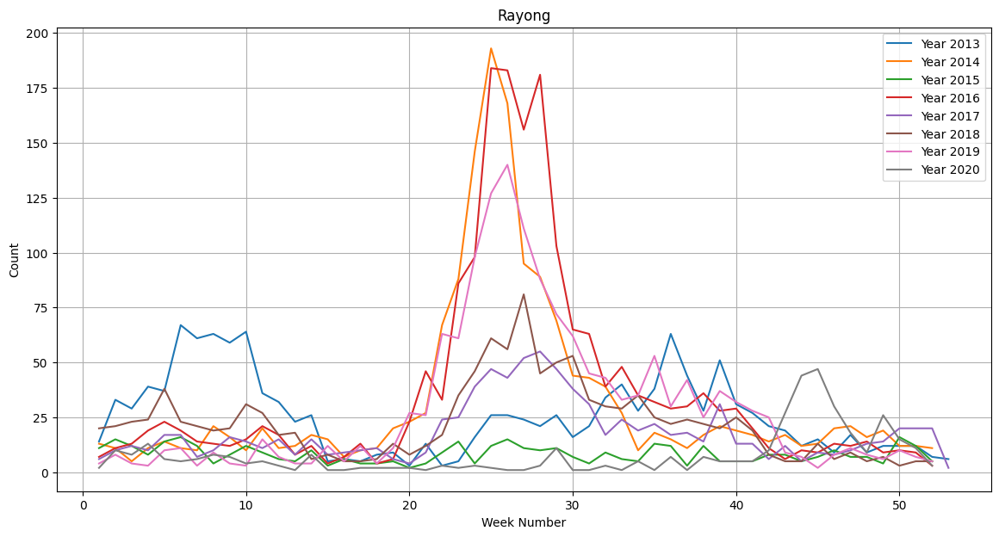


RMSE: 3.8114428120179986


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetTorch,-3.710835,-3.710835,-4.723226,root_mean_squared_error,0.010839,0.007878,3.948767,0.010839,0.007878,3.948767,1,True,9
1,WeightedEnsemble_L2,-3.811443,-3.811443,-4.275946,root_mean_squared_error,0.223558,0.137005,7.972276,0.004076,0.000531,0.015851,2,True,11
2,LightGBMXT,-5.337636,-5.337636,-7.166695,root_mean_squared_error,0.104135,0.048591,1.672955,0.104135,0.048591,1.672955,1,True,3
3,LightGBMLarge,-5.482214,-5.482214,-6.288985,root_mean_squared_error,0.016064,0.005028,0.555609,0.016064,0.005028,0.555609,1,True,10
4,ExtraTreesMSE,-5.991356,-5.991356,-5.415444,root_mean_squared_error,0.090545,0.065969,0.947031,0.090545,0.065969,0.947031,1,True,6
5,XGBoost,-6.001515,-6.001515,-7.112952,root_mean_squared_error,0.017549,0.006951,0.594391,0.017549,0.006951,0.594391,1,True,8
6,LightGBM,-6.249169,-6.249169,-7.692902,root_mean_squared_error,0.029219,0.008548,0.663043,0.029219,0.008548,0.663043,1,True,4
7,KNeighborsUnif,-7.232831,-7.232831,-7.318654,root_mean_squared_error,0.014782,0.030162,0.007886,0.014782,0.030162,0.007886,1,True,1
8,KNeighborsDist,-7.235465,-7.235465,-6.812095,root_mean_squared_error,0.013870,0.016579,0.007115,0.013870,0.016579,0.007115,1,True,2
9,RandomForestMSE,-7.946013,-7.946013,-6.651808,root_mean_squared_error,0.079603,0.076212,0.662460,0.079603,0.076212,0.662460,1,True,5


In [17]:
province = "Rayong"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Rayong = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Rayong.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Rayong.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Chanthaburi

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191729"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.53 GB / 12.67 GB (83.1%)
Disk Space Avail:   76.40 GB / 107.72 GB (70.9%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 8.25258
[2000]	valid_set's rmse: 8.01012
[3000]	valid_set's rmse: 7.91212
[4000]	valid_set's rmse: 7.9414


	-7.9042	 = Validation score   (-root_mean_squared_error)
	0.85s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-7.766	 = Validation score   (-root_mean_squared_error)
	0.41s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-7.3053	 = Validation score   (-root_mean_squared_error)
	0.75s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-7.2174	 = Validation score   (-root_mean_squared_error)
	0.59s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-5.4455	 = Validation score   (-root_mean_squared_error)
	0.61s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-7.8344	 = Validation score   (-root_mean_squared_error)
	0.4s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-5.615	 = Validation score   (-root_mean_squared_error)
	2.72s	 = Training   runtim

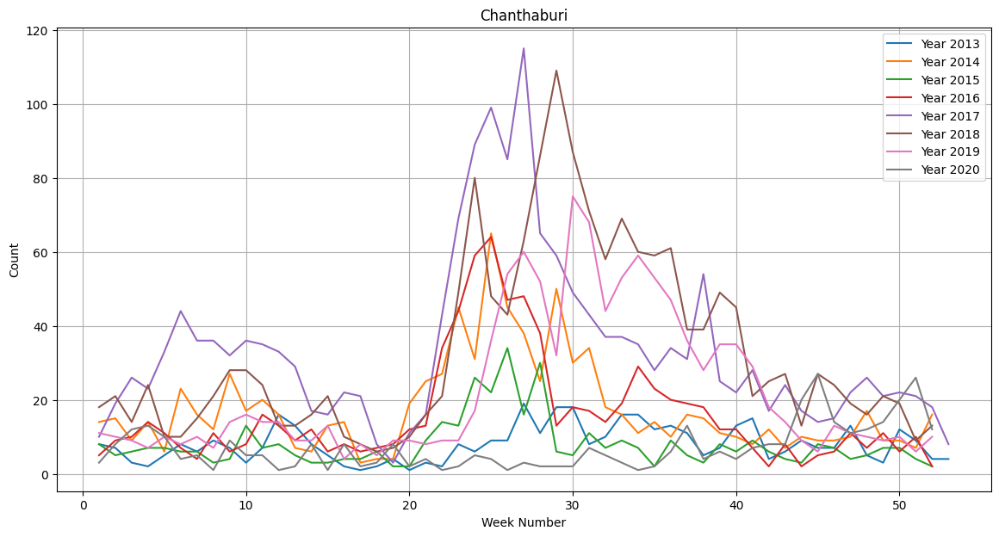


RMSE: 4.154991723962313


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetTorch,-2.655470,-2.655470,-5.614968,root_mean_squared_error,0.012609,0.013561,2.719318,0.012609,0.013561,2.719318,1,True,9
1,LightGBM,-2.723025,-2.723025,-7.766049,root_mean_squared_error,0.007667,0.001452,0.405036,0.007667,0.001452,0.405036,1,True,4
2,ExtraTreesMSE,-3.079054,-3.079054,-7.217405,root_mean_squared_error,0.090614,0.076288,0.587941,0.090614,0.076288,0.587941,1,True,6
3,XGBoost,-3.150393,-3.150393,-7.834366,root_mean_squared_error,0.039190,0.006606,0.397712,0.039190,0.006606,0.397712,1,True,8
4,RandomForestMSE,-3.163426,-3.163426,-7.305293,root_mean_squared_error,0.086180,0.079049,0.750703,0.086180,0.079049,0.750703,1,True,5
5,LightGBMLarge,-3.300384,-3.300384,-7.286566,root_mean_squared_error,0.010122,0.003060,0.613514,0.010122,0.003060,0.613514,1,True,10
6,LightGBMXT,-3.619563,-3.619563,-7.904163,root_mean_squared_error,0.065903,0.015689,0.851977,0.065903,0.015689,0.851977,1,True,3
7,WeightedEnsemble_L2,-4.154992,-4.154992,-5.048934,root_mean_squared_error,0.046317,0.022439,3.358956,0.003960,0.000998,0.027392,2,True,11
8,KNeighborsDist,-4.488492,-4.488492,-8.546539,root_mean_squared_error,0.015195,0.013312,0.006987,0.015195,0.013312,0.006987,1,True,2
9,KNeighborsUnif,-4.563400,-4.563400,-8.390278,root_mean_squared_error,0.015180,0.017423,0.016701,0.015180,0.017423,0.016701,1,True,1


In [18]:
province = "Chanthaburi"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Chanthaburi = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Chanthaburi.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Chanthaburi.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Trat

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191738"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.52 GB / 12.67 GB (83.0%)
Disk Space Avail:   76.39 GB / 107.72 GB (70.9%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 3.53256
[2000]	valid_set's rmse: 3.1259
[3000]	valid_set's rmse: 3.07473


	-3.0609	 = Validation score   (-root_mean_squared_error)
	0.9s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-2.9069	 = Validation score   (-root_mean_squared_error)
	0.57s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.0544	 = Validation score   (-root_mean_squared_error)
	1.05s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.7878	 = Validation score   (-root_mean_squared_error)
	0.92s	 = Training   runtime
	0.1s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.3989	 = Validation score   (-root_mean_squared_error)
	0.75s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.8057	 = Validation score   (-root_mean_squared_error)
	0.29s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.3079	 = Validation score   (-root_mean_squared_error)
	2.89s	 = Training   runtim

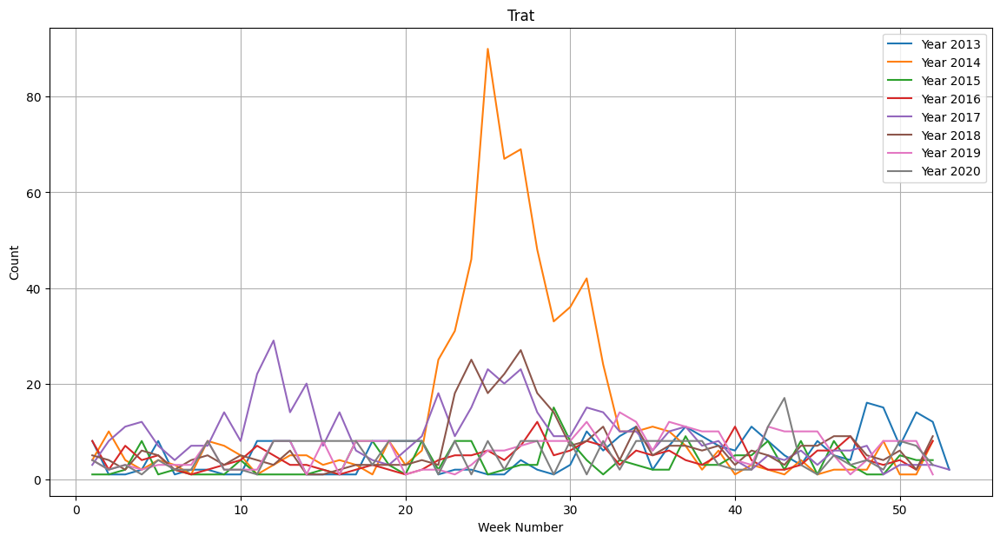


RMSE: 1.6122247300776535


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetTorch,-1.339321,-1.339321,-2.307854,root_mean_squared_error,0.017404,0.008226,2.892931,0.017404,0.008226,2.892931,1,True,9
1,LightGBMLarge,-1.383263,-1.383263,-2.940127,root_mean_squared_error,0.029553,0.004305,0.606580,0.029553,0.004305,0.606580,1,True,10
2,XGBoost,-1.578054,-1.578054,-2.805655,root_mean_squared_error,0.025227,0.004331,0.285631,0.025227,0.004331,0.285631,1,True,8
3,LightGBMXT,-1.610940,-1.610940,-3.060864,root_mean_squared_error,0.038850,0.016101,0.896431,0.038850,0.016101,0.896431,1,True,3
4,WeightedEnsemble_L2,-1.612225,-1.612225,-1.659406,root_mean_squared_error,0.098019,0.036170,4.571437,0.005987,0.002195,0.027208,2,True,11
5,LightGBM,-1.690049,-1.690049,-2.906874,root_mean_squared_error,0.016181,0.004300,0.565101,0.016181,0.004300,0.565101,1,True,4
6,RandomForestMSE,-1.749626,-1.749626,-3.054432,root_mean_squared_error,0.096482,0.066840,1.054180,0.096482,0.066840,1.054180,1,True,5
7,ExtraTreesMSE,-1.824949,-1.824949,-2.787775,root_mean_squared_error,0.094107,0.099652,0.923806,0.094107,0.099652,0.923806,1,True,6
8,NeuralNetFastAI,-2.426868,-2.426868,-2.398902,root_mean_squared_error,0.035779,0.009647,0.754868,0.035779,0.009647,0.754868,1,True,7
9,KNeighborsDist,-3.350209,-3.350209,-5.115974,root_mean_squared_error,0.017335,0.013049,0.008065,0.017335,0.013049,0.008065,1,True,2


In [19]:
province = "Trat"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Trat = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Trat.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Trat.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Chachoengsao

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191748"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.52 GB / 12.67 GB (83.0%)
Disk Space Avail:   76.37 GB / 107.72 GB (70.9%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 4.1487
[2000]	valid_set's rmse: 3.919


	-3.919	 = Validation score   (-root_mean_squared_error)
	0.9s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-3.7223	 = Validation score   (-root_mean_squared_error)
	0.47s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.3985	 = Validation score   (-root_mean_squared_error)
	1.15s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.6075	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-3.9809	 = Validation score   (-root_mean_squared_error)
	0.62s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-3.5028	 = Validation score   (-root_mean_squared_error)
	0.35s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.929	 = Validation score   (-root_mean_squared_error)
	3.68s	 = Training   runtim

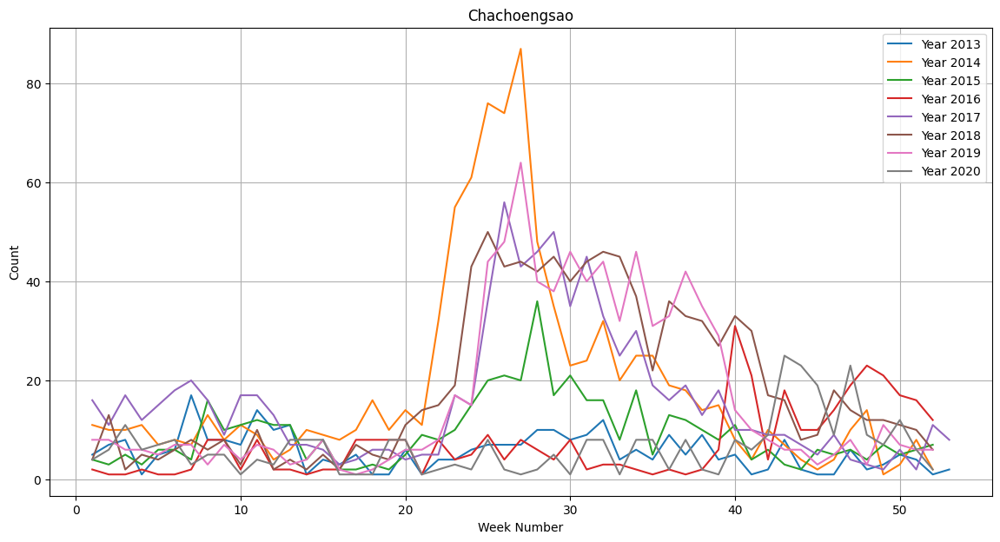


RMSE: 2.561720513017153


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,LightGBMXT,-1.970831,-1.970831,-3.919002,root_mean_squared_error,0.027545,0.013033,0.899467,0.027545,0.013033,0.899467,1,True,3
1,LightGBM,-2.026852,-2.026852,-3.722328,root_mean_squared_error,0.008901,0.002978,0.469044,0.008901,0.002978,0.469044,1,True,4
2,XGBoost,-2.241637,-2.241637,-3.502772,root_mean_squared_error,0.021177,0.005347,0.345789,0.021177,0.005347,0.345789,1,True,8
3,LightGBMLarge,-2.351590,-2.351590,-3.035638,root_mean_squared_error,0.026073,0.006064,0.598087,0.026073,0.006064,0.598087,1,True,10
4,WeightedEnsemble_L2,-2.561721,-2.561721,-2.542542,root_mean_squared_error,0.066127,0.026412,5.395442,0.004210,0.000674,0.027213,2,True,11
5,ExtraTreesMSE,-2.625534,-2.625534,-3.607526,root_mean_squared_error,0.091563,0.077443,0.640596,0.091563,0.077443,0.640596,1,True,6
6,RandomForestMSE,-2.771882,-2.771882,-3.398545,root_mean_squared_error,0.091281,0.067301,1.152505,0.091281,0.067301,1.152505,1,True,5
7,NeuralNetTorch,-3.034661,-3.034661,-2.928960,root_mean_squared_error,0.011255,0.008583,3.677040,0.011255,0.008583,3.677040,1,True,9
8,NeuralNetFastAI,-4.007759,-4.007759,-3.980940,root_mean_squared_error,0.015688,0.008114,0.624059,0.015688,0.008114,0.624059,1,True,7
9,KNeighborsDist,-4.334798,-4.334798,-4.921538,root_mean_squared_error,0.014319,0.020368,0.014705,0.014319,0.020368,0.014705,1,True,2


In [20]:
province = "Chachoengsao"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Chachoengsao = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Chachoengsao.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Chachoengsao.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Prachinburi

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191758"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.9%)
Disk Space Avail:   76.35 GB / 107.72 GB (70.9%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 4.9325
[2000]	valid_set's rmse: 4.69012
[3000]	valid_set's rmse: 4.70591


	-4.6754	 = Validation score   (-root_mean_squared_error)
	0.7s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-4.7936	 = Validation score   (-root_mean_squared_error)
	0.31s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-4.8879	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-4.6268	 = Validation score   (-root_mean_squared_error)
	0.78s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-5.036	 = Validation score   (-root_mean_squared_error)
	0.88s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-4.4377	 = Validation score   (-root_mean_squared_error)
	0.5s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-4.033	 = Validation score   (-root_mean_squared_error)
	4.99s	 = Training   runtime

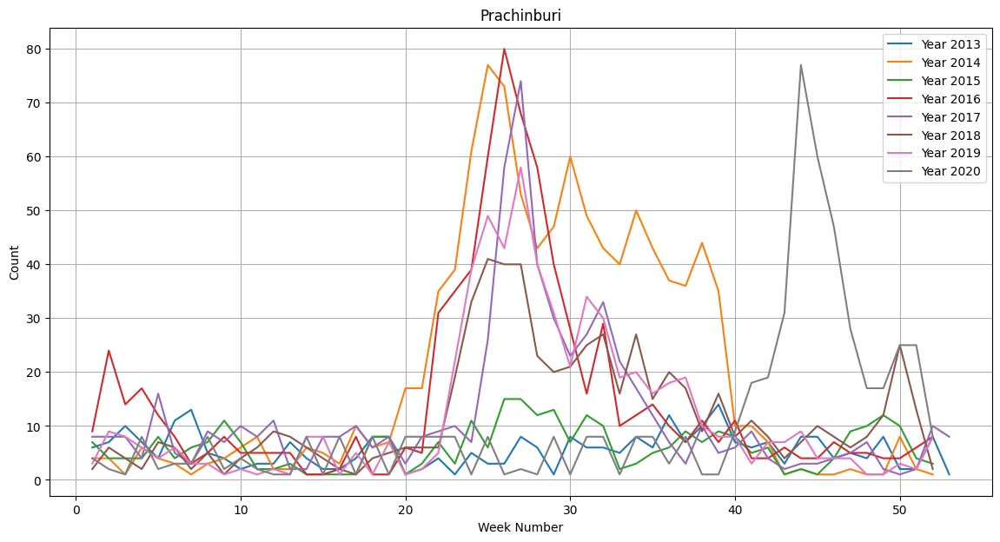


RMSE: 6.894694140583732


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,XGBoost,-6.606549,-6.606549,-4.437681,root_mean_squared_error,0.022206,0.007303,0.503607,0.022206,0.007303,0.503607,1,True,8
1,NeuralNetFastAI,-6.677767,-6.677767,-5.036000,root_mean_squared_error,0.018393,0.011188,0.876694,0.018393,0.011188,0.876694,1,True,7
2,LightGBM,-6.737202,-6.737202,-4.793604,root_mean_squared_error,0.009062,0.001688,0.313701,0.009062,0.001688,0.313701,1,True,4
3,WeightedEnsemble_L2,-6.894694,-6.894694,-3.926212,root_mean_squared_error,0.076779,0.032833,7.009004,0.004881,0.000631,0.020825,2,True,11
4,ExtraTreesMSE,-6.932155,-6.932155,-4.626793,root_mean_squared_error,0.090286,0.068688,0.783991,0.090286,0.068688,0.783991,1,True,6
5,RandomForestMSE,-7.114115,-7.114115,-4.887907,root_mean_squared_error,0.082960,0.077240,0.644610,0.082960,0.077240,0.644610,1,True,5
6,LightGBMLarge,-7.154737,-7.154737,-4.691641,root_mean_squared_error,0.018067,0.003513,0.616458,0.018067,0.003513,0.616458,1,True,10
7,NeuralNetTorch,-7.627933,-7.627933,-4.033032,root_mean_squared_error,0.013232,0.010197,4.991421,0.013232,0.010197,4.991421,1,True,9
8,LightGBMXT,-7.941350,-7.941350,-4.675442,root_mean_squared_error,0.042771,0.013845,0.696068,0.042771,0.013845,0.696068,1,True,3
9,KNeighborsDist,-8.344311,-8.344311,-6.153910,root_mean_squared_error,0.017760,0.014098,0.009588,0.017760,0.014098,0.009588,1,True,2


In [21]:
province = "Prachinburi"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Prachinburi = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Prachinburi.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Prachinburi.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Nakhon Nayok

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191810"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.61 GB / 12.67 GB (83.7%)
Disk Space Avail:   76.34 GB / 107.72 GB (70.9%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 1.82143
[2000]	valid_set's rmse: 1.74318
[3000]	valid_set's rmse: 1.71902


	-1.7003	 = Validation score   (-root_mean_squared_error)
	0.78s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-1.5356	 = Validation score   (-root_mean_squared_error)
	0.33s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.0398	 = Validation score   (-root_mean_squared_error)
	0.63s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.0631	 = Validation score   (-root_mean_squared_error)
	0.6s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.6348	 = Validation score   (-root_mean_squared_error)
	0.66s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-1.6709	 = Validation score   (-root_mean_squared_error)
	0.27s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.9928	 = Validation score   (-root_mean_squared_error)
	3.79s	 = Training   runt

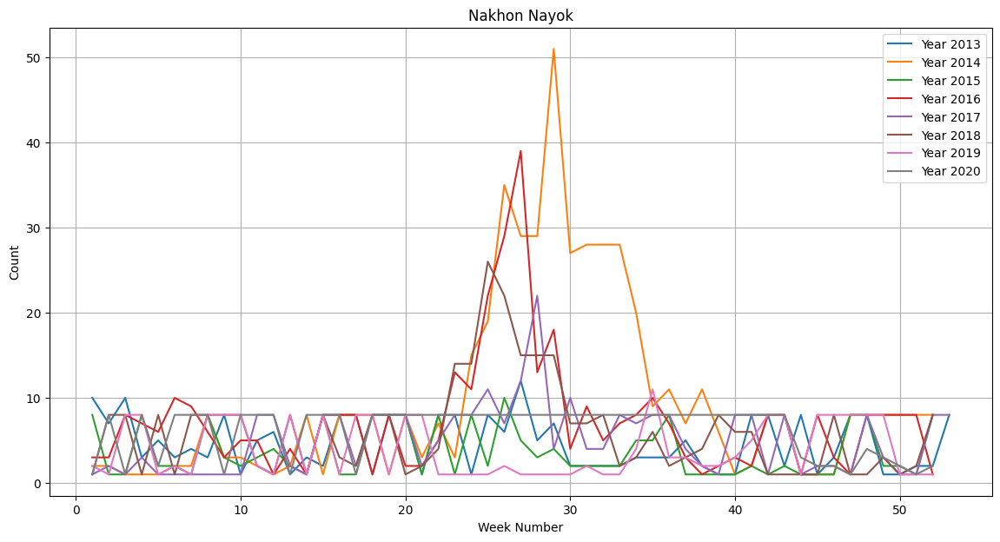


RMSE: 1.0740776576204314


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,ExtraTreesMSE,-0.905960,-0.905960,-2.063069,root_mean_squared_error,0.088202,0.079111,0.601923,0.088202,0.079111,0.601923,1,True,6
1,LightGBMLarge,-0.967171,-0.967171,-1.958778,root_mean_squared_error,0.016222,0.003507,0.482261,0.016222,0.003507,0.482261,1,True,10
2,RandomForestMSE,-1.009147,-1.009147,-2.039760,root_mean_squared_error,0.088229,0.075500,0.631755,0.088229,0.075500,0.631755,1,True,5
3,WeightedEnsemble_L2,-1.074078,-1.074078,-1.369794,root_mean_squared_error,0.095542,0.042942,5.837728,0.004699,0.000512,0.016261,2,True,11
4,NeuralNetFastAI,-1.227147,-1.227147,-1.634784,root_mean_squared_error,0.014569,0.008070,0.659346,0.014569,0.008070,0.659346,1,True,7
5,NeuralNetTorch,-1.231343,-1.231343,-1.992757,root_mean_squared_error,0.011185,0.010216,3.787880,0.011185,0.010216,3.787880,1,True,9
6,LightGBM,-1.310750,-1.310750,-1.535582,root_mean_squared_error,0.008666,0.002299,0.328604,0.008666,0.002299,0.328604,1,True,4
7,XGBoost,-1.323352,-1.323352,-1.670854,root_mean_squared_error,0.018270,0.005740,0.266414,0.018270,0.005740,0.266414,1,True,8
8,LightGBMXT,-1.430697,-1.430697,-1.700347,root_mean_squared_error,0.038153,0.016105,0.779223,0.038153,0.016105,0.779223,1,True,3
9,KNeighborsDist,-2.841674,-2.841674,-3.417372,root_mean_squared_error,0.013994,0.013386,0.008274,0.013994,0.013386,0.008274,1,True,2


In [22]:
province = "Nakhon Nayok"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Nakhon_Nayok = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Nakhon_Nayok.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Nakhon_Nayok.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Sa Kaeo

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191819"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.61 GB / 12.67 GB (83.7%)
Disk Space Avail:   76.32 GB / 107.72 GB (70.9%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 3.44301
[2000]	valid_set's rmse: 3.087
[3000]	valid_set's rmse: 2.9056
[4000]	valid_set's rmse: 2.81581
[5000]	valid_set's rmse: 2.75211
[6000]	valid_set's rmse: 2.72612
[7000]	valid_set's rmse: 2.71892
[8000]	valid_set's rmse: 2.7134
[9000]	valid_set's rmse: 2.72513
[10000]	valid_set's rmse: 2.73663


	-2.7094	 = Validation score   (-root_mean_squared_error)
	1.65s	 = Training   runtime
	0.04s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's rmse: 2.49509


	-2.4786	 = Validation score   (-root_mean_squared_error)
	0.68s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.1233	 = Validation score   (-root_mean_squared_error)
	0.65s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.9383	 = Validation score   (-root_mean_squared_error)
	0.73s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-3.0549	 = Validation score   (-root_mean_squared_error)
	0.62s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-3.5764	 = Validation score   (-root_mean_squared_error)
	0.3s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.7608	 = Validation score   (-root_mean_squared_error)
	2.3s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-2.308	 = Validation score   (-root_mean_squared_error)
	0.85s	 = Training   r

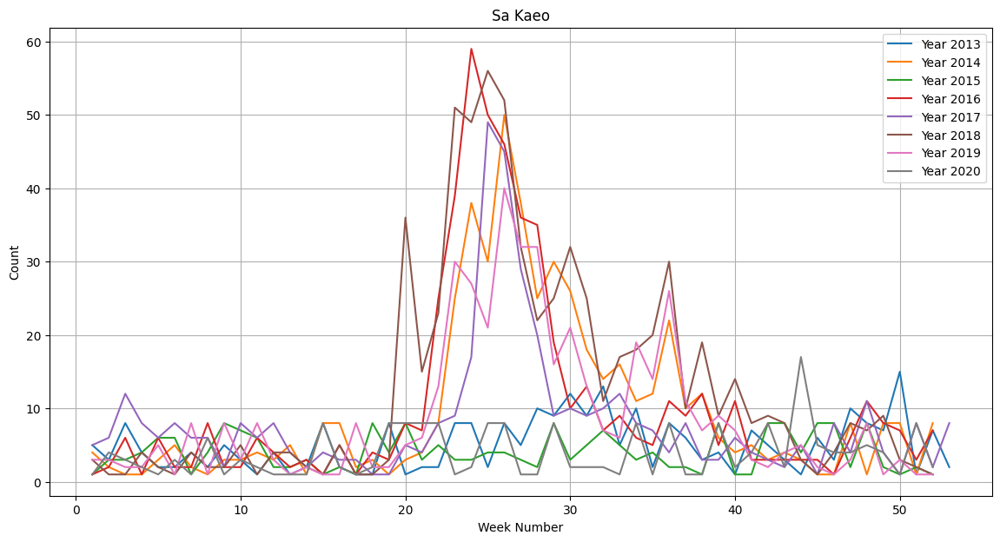


RMSE: 1.4712557441481409


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,LightGBM,-1.194030,-1.194030,-2.478606,root_mean_squared_error,0.046602,0.008918,0.679171,0.046602,0.008918,0.679171,1,True,4
1,LightGBMXT,-1.198678,-1.198678,-2.709430,root_mean_squared_error,0.168440,0.039858,1.652095,0.168440,0.039858,1.652095,1,True,3
2,XGBoost,-1.341304,-1.341304,-3.576414,root_mean_squared_error,0.028412,0.004788,0.302928,0.028412,0.004788,0.302928,1,True,8
3,WeightedEnsemble_L2,-1.471256,-1.471256,-2.130794,root_mean_squared_error,0.286052,0.070059,6.120546,0.005993,0.000659,0.021154,2,True,11
4,LightGBMLarge,-1.615238,-1.615238,-2.307969,root_mean_squared_error,0.029794,0.005030,0.848881,0.029794,0.005030,0.848881,1,True,10
5,ExtraTreesMSE,-1.637133,-1.637133,-2.938285,root_mean_squared_error,0.072544,0.066649,0.727571,0.072544,0.066649,0.727571,1,True,6
6,RandomForestMSE,-1.683364,-1.683364,-3.123259,root_mean_squared_error,0.079020,0.076893,0.645890,0.079020,0.076893,0.645890,1,True,5
7,NeuralNetTorch,-1.752386,-1.752386,-2.760763,root_mean_squared_error,0.016872,0.007868,2.297246,0.016872,0.007868,2.297246,1,True,9
8,NeuralNetFastAI,-2.779133,-2.779133,-3.054906,root_mean_squared_error,0.018351,0.007727,0.621999,0.018351,0.007727,0.621999,1,True,7
9,KNeighborsDist,-3.529390,-3.529390,-4.806989,root_mean_squared_error,0.014383,0.013362,0.008221,0.014383,0.013362,0.008221,1,True,2


In [23]:
province = "Sa Kaeo"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Sa_Kaeo = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Sa_Kaeo.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Sa_Kaeo.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Nakhon Ratchasima

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191830"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.61 GB / 12.67 GB (83.7%)
Disk Space Avail:   76.30 GB / 107.72 GB (70.8%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 12.8087
[2000]	valid_set's rmse: 12.1758
[3000]	valid_set's rmse: 11.8994
[4000]	valid_set's rmse: 11.4083
[5000]	valid_set's rmse: 11.1459
[6000]	valid_set's rmse: 10.9206
[7000]	valid_set's rmse: 10.6245
[8000]	valid_set's rmse: 10.4006
[9000]	valid_set's rmse: 10.1993
[10000]	valid_set's rmse: 10.1105


	-10.0968	 = Validation score   (-root_mean_squared_error)
	2.11s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's rmse: 10.8483
[2000]	valid_set's rmse: 10.2633


	-10.2374	 = Validation score   (-root_mean_squared_error)
	0.84s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-8.8007	 = Validation score   (-root_mean_squared_error)
	0.69s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-8.3337	 = Validation score   (-root_mean_squared_error)
	0.68s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-13.4565	 = Validation score   (-root_mean_squared_error)
	0.77s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-8.1501	 = Validation score   (-root_mean_squared_error)
	0.27s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-11.2633	 = Validation score   (-root_mean_squared_error)
	2.46s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...


[1000]	valid_set's rmse: 7.01067


	-7.0006	 = Validation score   (-root_mean_squared_error)
	0.98s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'LightGBMLarge': 0.56, 'LightGBMXT': 0.2, 'XGBoost': 0.16, 'LightGBM': 0.08}
	-5.9092	 = Validation score   (-root_mean_squared_error)
	0.02s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 10.4s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 767.3 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_191830")


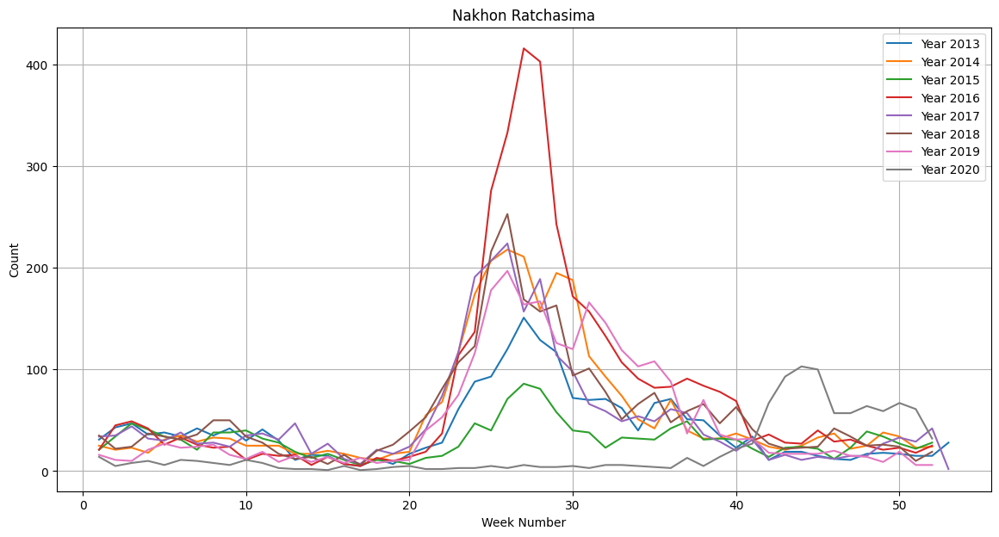


RMSE: 12.68009854832767


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,KNeighborsDist,-9.714450,-9.714450,-9.786770,root_mean_squared_error,0.014596,0.015984,0.013009,0.014596,0.015984,0.013009,1,True,2
1,KNeighborsUnif,-9.742097,-9.742097,-10.839941,root_mean_squared_error,0.015719,0.028720,0.007159,0.015719,0.028720,0.007159,1,True,1
2,LightGBM,-11.096399,-11.096399,-10.237421,root_mean_squared_error,0.050360,0.013407,0.842945,0.050360,0.013407,0.842945,1,True,4
3,XGBoost,-11.867674,-11.867674,-8.150056,root_mean_squared_error,0.014298,0.003283,0.265664,0.014298,0.003283,0.265664,1,True,8
4,ExtraTreesMSE,-12.348569,-12.348569,-8.333658,root_mean_squared_error,0.086006,0.076789,0.677567,0.086006,0.076789,0.677567,1,True,6
5,WeightedEnsemble_L2,-12.680099,-12.680099,-5.909209,root_mean_squared_error,0.274189,0.096436,4.219402,0.006288,0.000872,0.018739,2,True,11
6,LightGBMXT,-13.185023,-13.185023,-10.096822,root_mean_squared_error,0.150442,0.064842,2.112782,0.150442,0.064842,2.112782,1,True,3
7,NeuralNetTorch,-13.998840,-13.998840,-11.263281,root_mean_squared_error,0.012433,0.007812,2.459957,0.012433,0.007812,2.459957,1,True,9
8,LightGBMLarge,-14.117793,-14.117793,-7.000599,root_mean_squared_error,0.052800,0.014032,0.979272,0.052800,0.014032,0.979272,1,True,10
9,RandomForestMSE,-14.680630,-14.680630,-8.800657,root_mean_squared_error,0.086226,0.076086,0.690097,0.086226,0.076086,0.690097,1,True,5


In [24]:
province = "Nakhon Ratchasima"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Nakhon_Ratchasima = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Nakhon_Ratchasima.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Nakhon_Ratchasima.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Buriram

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191842"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.61 GB / 12.67 GB (83.7%)
Disk Space Avail:   76.28 GB / 107.72 GB (70.8%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 10.2619
[2000]	valid_set's rmse: 9.61234
[3000]	valid_set's rmse: 9.20912
[4000]	valid_set's rmse: 8.93181
[5000]	valid_set's rmse: 8.74914
[6000]	valid_set's rmse: 8.63104
[7000]	valid_set's rmse: 8.54184
[8000]	valid_set's rmse: 8.46238
[9000]	valid_set's rmse: 8.38909
[10000]	valid_set's rmse: 8.32547


	-8.3208	 = Validation score   (-root_mean_squared_error)
	2.81s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: LightGBM ...
	-9.4706	 = Validation score   (-root_mean_squared_error)
	0.4s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-7.5714	 = Validation score   (-root_mean_squared_error)
	0.82s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-6.8322	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-7.6364	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-7.3059	 = Validation score   (-root_mean_squared_error)
	0.32s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-5.9208	 = Validation score   (-root_mean_squared_error)
	2.82s	 = Training   runt

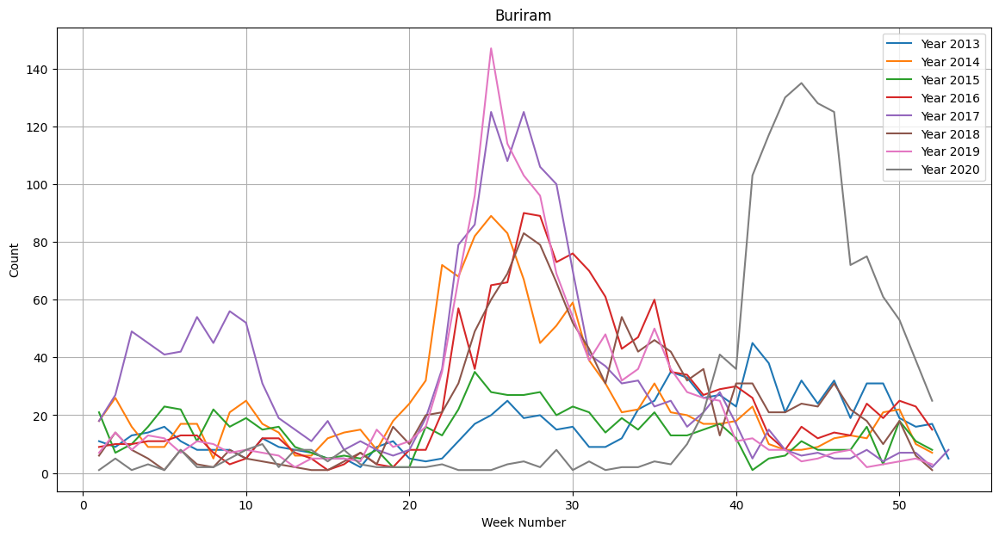


RMSE: 9.926598192193035


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetTorch,-9.856987,-9.856987,-5.920819,root_mean_squared_error,0.010311,0.008075,2.819850,0.010311,0.008075,2.819850,1,True,9
1,WeightedEnsemble_L2,-9.926598,-9.926598,-5.908005,root_mean_squared_error,0.043279,0.021684,3.798255,0.003026,0.000506,0.017201,2,True,11
2,RandomForestMSE,-12.048483,-12.048483,-7.571389,root_mean_squared_error,0.088062,0.089167,0.819484,0.088062,0.089167,0.819484,1,True,5
3,ExtraTreesMSE,-12.364543,-12.364543,-6.832199,root_mean_squared_error,0.090668,0.076941,0.640624,0.090668,0.076941,0.640624,1,True,6
4,LightGBMLarge,-13.033441,-13.033441,-7.403746,root_mean_squared_error,0.009132,0.002255,0.460791,0.009132,0.002255,0.460791,1,True,10
5,KNeighborsDist,-13.438662,-13.438662,-8.295206,root_mean_squared_error,0.015398,0.015508,0.008012,0.015398,0.015508,0.008012,1,True,2
6,KNeighborsUnif,-13.729866,-13.729866,-8.440443,root_mean_squared_error,0.016749,0.027751,0.007270,0.016749,0.027751,0.007270,1,True,1
7,XGBoost,-14.511763,-14.511763,-7.305926,root_mean_squared_error,0.013837,0.005070,0.318766,0.013837,0.005070,0.318766,1,True,8
8,NeuralNetFastAI,-15.132259,-15.132259,-7.636403,root_mean_squared_error,0.016106,0.008033,0.642438,0.016106,0.008033,0.642438,1,True,7
9,LightGBM,-17.444901,-17.444901,-9.470609,root_mean_squared_error,0.010082,0.001267,0.399907,0.010082,0.001267,0.399907,1,True,4


In [25]:
province = "Buriram"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Buriram = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Buriram.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Buriram.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Surin

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191853"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.62 GB / 12.67 GB (83.8%)
Disk Space Avail:   76.25 GB / 107.72 GB (70.8%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 16.2693


	-15.6132	 = Validation score   (-root_mean_squared_error)
	0.43s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-17.9836	 = Validation score   (-root_mean_squared_error)
	0.7s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-16.6091	 = Validation score   (-root_mean_squared_error)
	0.9s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-12.2926	 = Validation score   (-root_mean_squared_error)
	0.93s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-14.6013	 = Validation score   (-root_mean_squared_error)
	0.47s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-9.5808	 = Validation score   (-root_mean_squared_error)
	4.09s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-14.9295	 = Validation score   (-root_mean_squared_error)
	0.51s	 = Train

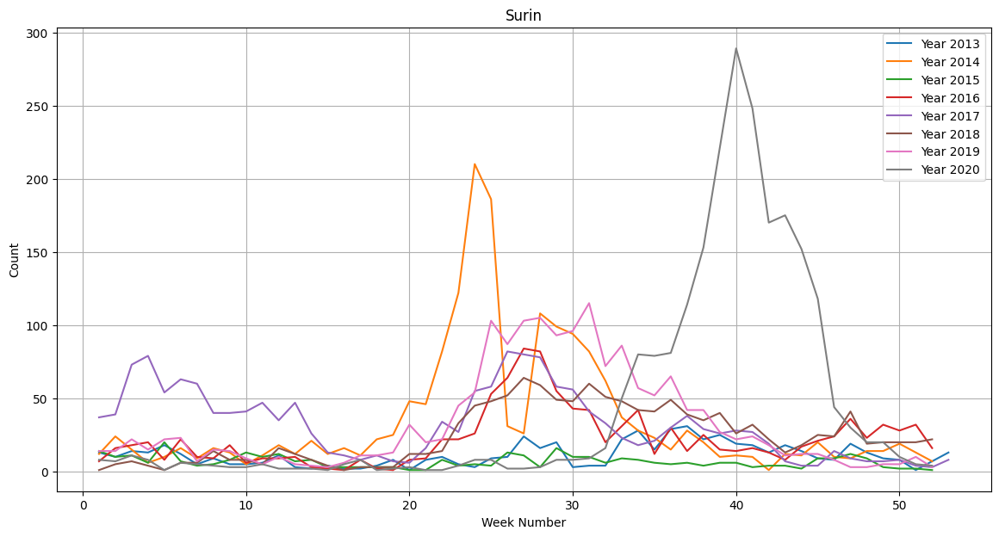


RMSE: 31.23519182185033


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetFastAI,-23.440372,-23.440372,-12.292638,root_mean_squared_error,0.023470,0.011501,0.927903,0.023470,0.011501,0.927903,1,True,7
1,NeuralNetTorch,-31.235192,-31.235192,-9.580825,root_mean_squared_error,0.016120,0.011132,4.090418,0.016120,0.011132,4.090418,1,True,9
2,WeightedEnsemble_L2,-31.235192,-31.235192,-9.580825,root_mean_squared_error,0.019773,0.011863,4.107685,0.003653,0.000731,0.017267,2,True,11
3,ExtraTreesMSE,-31.363872,-31.363872,-16.609062,root_mean_squared_error,0.091292,0.056013,0.904739,0.091292,0.056013,0.904739,1,True,6
4,RandomForestMSE,-31.792302,-31.792302,-17.983571,root_mean_squared_error,0.096432,0.076637,0.702268,0.096432,0.076637,0.702268,1,True,5
5,XGBoost,-32.586486,-32.586486,-14.601339,root_mean_squared_error,0.018233,0.005251,0.467060,0.018233,0.005251,0.467060,1,True,8
6,KNeighborsDist,-37.904319,-37.904319,-18.158600,root_mean_squared_error,0.015047,0.013503,0.008385,0.015047,0.013503,0.008385,1,True,2
7,KNeighborsUnif,-40.114816,-40.114816,-17.844675,root_mean_squared_error,0.015313,0.029101,0.007012,0.015313,0.029101,0.007012,1,True,1
8,LightGBMLarge,-40.688606,-40.688606,-14.929481,root_mean_squared_error,0.008339,0.001929,0.508965,0.008339,0.001929,0.508965,1,True,10
9,LightGBM,-48.404291,-48.404291,-15.613180,root_mean_squared_error,0.012068,0.003189,0.434055,0.012068,0.003189,0.434055,1,True,4


In [26]:
province = "Surin"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Surin = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Surin.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Surin.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<hr>

<br>

## Sisaket

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191904"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.65 GB / 12.67 GB (84.0%)
Disk Space Avail:   76.24 GB / 107.72 GB (70.8%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 6.09575
[2000]	valid_set's rmse: 5.95519


	-5.9165	 = Validation score   (-root_mean_squared_error)
	0.74s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-5.5546	 = Validation score   (-root_mean_squared_error)
	0.55s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...


[1000]	valid_set's rmse: 5.58226


	-5.7017	 = Validation score   (-root_mean_squared_error)
	0.66s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-6.0349	 = Validation score   (-root_mean_squared_error)
	0.61s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-5.7488	 = Validation score   (-root_mean_squared_error)
	0.63s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-5.4302	 = Validation score   (-root_mean_squared_error)
	0.38s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-3.6516	 = Validation score   (-root_mean_squared_error)
	3.86s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-5.5933	 = Validation score   (-root_mean_squared_error)
	0.55s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.889, 'XGBoost': 0.111}
	-3.6166	 

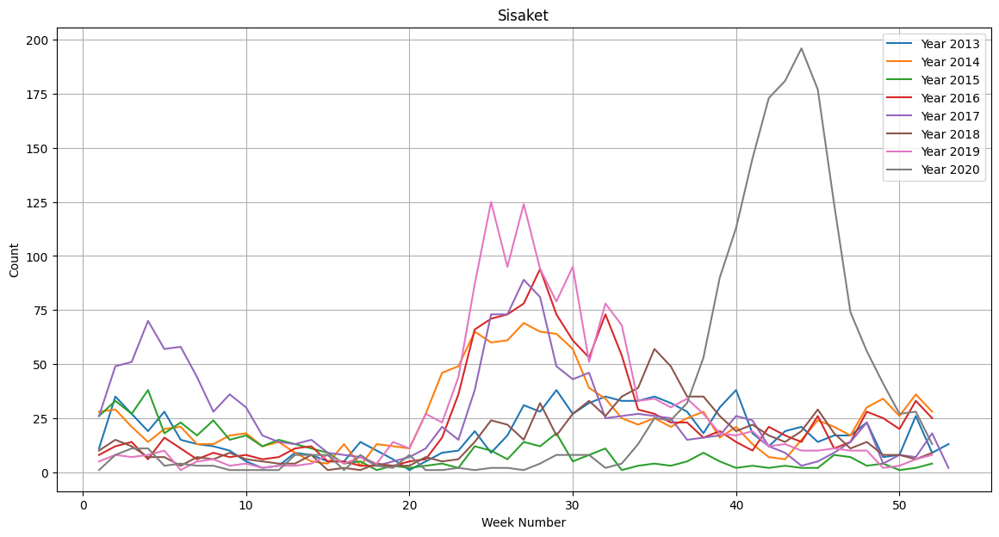


RMSE: 20.712085337864636


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetFastAI,-18.511671,-18.511671,-5.748793,root_mean_squared_error,0.015005,0.008010,0.632414,0.015005,0.008010,0.632414,1,True,7
1,NeuralNetTorch,-19.507714,-19.507714,-3.651592,root_mean_squared_error,0.011982,0.008321,3.861547,0.011982,0.008321,3.861547,1,True,9
2,WeightedEnsemble_L2,-20.712085,-20.712085,-3.616607,root_mean_squared_error,0.035830,0.015849,4.254408,0.003181,0.000544,0.015253,2,True,11
3,RandomForestMSE,-27.525428,-27.525428,-5.701669,root_mean_squared_error,0.091303,0.086939,0.664741,0.091303,0.086939,0.664741,1,True,5
4,ExtraTreesMSE,-27.584407,-27.584407,-6.034878,root_mean_squared_error,0.091564,0.077510,0.606071,0.091564,0.077510,0.606071,1,True,6
5,KNeighborsDist,-27.990195,-27.990195,-7.903067,root_mean_squared_error,0.013862,0.014362,0.009334,0.013862,0.014362,0.009334,1,True,2
6,KNeighborsUnif,-28.613741,-28.613741,-7.975808,root_mean_squared_error,0.014777,0.021682,0.017572,0.014777,0.021682,0.017572,1,True,1
7,LightGBMLarge,-29.043639,-29.043639,-5.593304,root_mean_squared_error,0.017854,0.004641,0.552940,0.017854,0.004641,0.552940,1,True,10
8,XGBoost,-33.099497,-33.099497,-5.430232,root_mean_squared_error,0.020668,0.006984,0.377608,0.020668,0.006984,0.377608,1,True,8
9,LightGBM,-34.032508,-34.032508,-5.554550,root_mean_squared_error,0.015979,0.005555,0.549595,0.015979,0.005555,0.549595,1,True,4


In [27]:
province = "Sisaket"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Sisaket = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Sisaket.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Sisaket.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Ubon Ratchathani

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191914"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.62 GB / 12.67 GB (83.8%)
Disk Space Avail:   76.22 GB / 107.72 GB (70.8%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 8.13504
[2000]	valid_set's rmse: 7.62114
[3000]	valid_set's rmse: 7.55414


	-7.5328	 = Validation score   (-root_mean_squared_error)
	0.86s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-6.9221	 = Validation score   (-root_mean_squared_error)
	0.49s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-6.5448	 = Validation score   (-root_mean_squared_error)
	0.85s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-7.0168	 = Validation score   (-root_mean_squared_error)
	0.78s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-7.3504	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-5.8189	 = Validation score   (-root_mean_squared_error)
	0.49s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-3.92	 = Validation score   (-root_mean_squared_error)
	2.37s	 = Training   runti

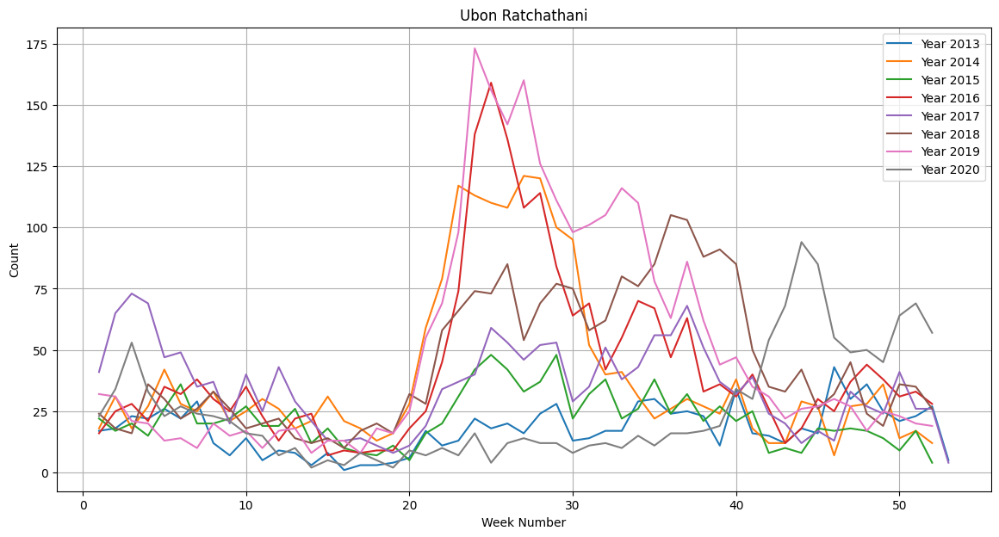


RMSE: 10.072394225854802


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,RandomForestMSE,-6.933429,-6.933429,-6.544831,root_mean_squared_error,0.092772,0.088285,0.850874,0.092772,0.088285,0.850874,1,True,5
1,ExtraTreesMSE,-7.017216,-7.017216,-7.016824,root_mean_squared_error,0.094586,0.088411,0.780609,0.094586,0.088411,0.780609,1,True,6
2,XGBoost,-7.267826,-7.267826,-5.818909,root_mean_squared_error,0.034413,0.010918,0.487033,0.034413,0.010918,0.487033,1,True,8
3,LightGBM,-7.675204,-7.675204,-6.922092,root_mean_squared_error,0.013441,0.003558,0.491076,0.013441,0.003558,0.491076,1,True,4
4,LightGBMLarge,-8.144658,-8.144658,-6.532864,root_mean_squared_error,0.007151,0.001475,0.476870,0.007151,0.001475,0.476870,1,True,10
5,LightGBMXT,-8.756017,-8.756017,-7.532822,root_mean_squared_error,0.040719,0.016188,0.857755,0.040719,0.016188,0.857755,1,True,3
6,KNeighborsDist,-9.354709,-9.354709,-10.367773,root_mean_squared_error,0.014066,0.013335,0.007154,0.014066,0.013335,0.007154,1,True,2
7,KNeighborsUnif,-9.558202,-9.558202,-10.448406,root_mean_squared_error,0.014790,0.023010,0.007275,0.014790,0.023010,0.007275,1,True,1
8,WeightedEnsemble_L2,-10.072394,-10.072394,-3.878979,root_mean_squared_error,0.056324,0.021807,2.878641,0.004511,0.000782,0.017921,2,True,11
9,NeuralNetTorch,-10.561647,-10.561647,-3.920026,root_mean_squared_error,0.017400,0.010106,2.373687,0.017400,0.010106,2.373687,1,True,9


In [28]:
province = "Ubon Ratchathani"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Ubon_Ratchathani = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Ubon_Ratchathani.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Ubon_Ratchathani.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Yasothon

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191923"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.9%)
Disk Space Avail:   76.20 GB / 107.72 GB (70.7%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 3.41287
[2000]	valid_set's rmse: 3.10667
[3000]	valid_set's rmse: 3.07585


	-3.0673	 = Validation score   (-root_mean_squared_error)
	1.14s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-3.2771	 = Validation score   (-root_mean_squared_error)
	0.58s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...


[1000]	valid_set's rmse: 3.47681


	-2.9847	 = Validation score   (-root_mean_squared_error)
	0.99s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.9998	 = Validation score   (-root_mean_squared_error)
	0.58s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.7623	 = Validation score   (-root_mean_squared_error)
	0.67s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.8901	 = Validation score   (-root_mean_squared_error)
	0.34s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.605	 = Validation score   (-root_mean_squared_error)
	3.34s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-3.5911	 = Validation score   (-root_mean_squared_error)
	0.67s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.429, 'NeuralNetFastAI': 0.286, 'Ra

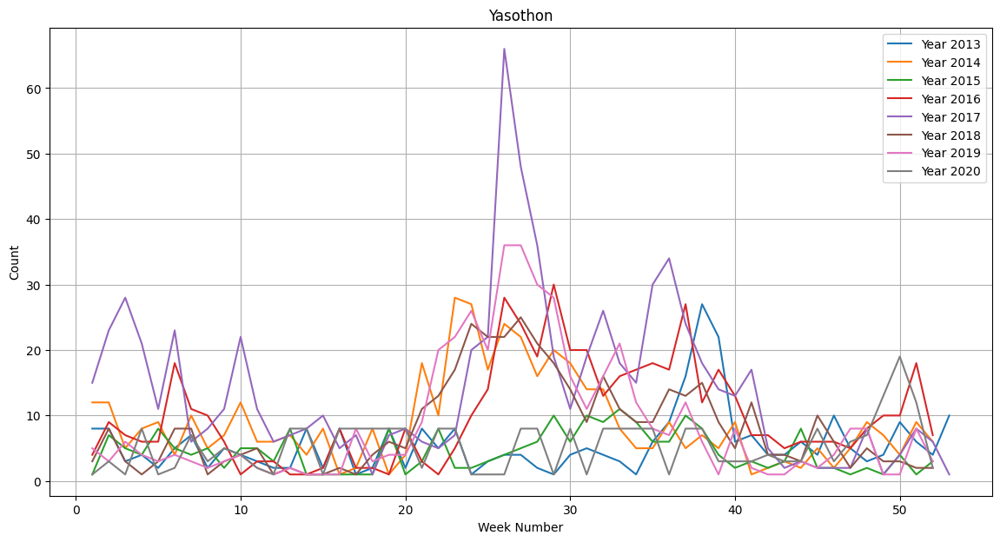


RMSE: 1.580889487410023


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,LightGBMXT,-1.467709,-1.467709,-3.067321,root_mean_squared_error,0.041682,0.020287,1.139187,0.041682,0.020287,1.139187,1,True,3
1,WeightedEnsemble_L2,-1.580889,-1.580889,-2.267500,root_mean_squared_error,0.183664,0.121322,6.153471,0.004867,0.000755,0.015996,2,True,11
2,NeuralNetFastAI,-1.981687,-1.981687,-2.762343,root_mean_squared_error,0.017794,0.011416,0.671427,0.017794,0.011416,0.671427,1,True,7
3,XGBoost,-1.984798,-1.984798,-2.890076,root_mean_squared_error,0.022479,0.006955,0.344822,0.022479,0.006955,0.344822,1,True,8
4,ExtraTreesMSE,-1.991058,-1.991058,-2.999780,root_mean_squared_error,0.095265,0.068962,0.581588,0.095265,0.068962,0.581588,1,True,6
5,NeuralNetTorch,-2.105396,-2.105396,-2.604980,root_mean_squared_error,0.013164,0.010140,3.339822,0.013164,0.010140,3.339822,1,True,9
6,LightGBM,-2.200746,-2.200746,-3.277123,root_mean_squared_error,0.017735,0.006133,0.579948,0.017735,0.006133,0.579948,1,True,4
7,LightGBMLarge,-2.293296,-2.293296,-3.591075,root_mean_squared_error,0.019572,0.004141,0.673332,0.019572,0.004141,0.673332,1,True,10
8,RandomForestMSE,-2.338409,-2.338409,-2.984668,root_mean_squared_error,0.106157,0.078724,0.987039,0.106157,0.078724,0.987039,1,True,5
9,KNeighborsDist,-3.694918,-3.694918,-4.896640,root_mean_squared_error,0.014946,0.020165,0.012976,0.014946,0.020165,0.012976,1,True,2


In [29]:
province = "Yasothon"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Yasothon = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Yasothon.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Yasothon.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Chaiyaphum

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_191933"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.64 GB / 12.67 GB (83.9%)
Disk Space Avail:   76.18 GB / 107.72 GB (70.7%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 12.1744
[2000]	valid_set's rmse: 11.0732
[3000]	valid_set's rmse: 10.5703
[4000]	valid_set's rmse: 10.2695
[5000]	valid_set's rmse: 10.0079
[6000]	valid_set's rmse: 9.77455
[7000]	valid_set's rmse: 9.63802
[8000]	valid_set's rmse: 9.51109
[9000]	valid_set's rmse: 9.40042
[10000]	valid_set's rmse: 9.32198


	-9.3212	 = Validation score   (-root_mean_squared_error)
	4.59s	 = Training   runtime
	0.18s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's rmse: 10.0166
[2000]	valid_set's rmse: 9.27568
[3000]	valid_set's rmse: 9.00688
[4000]	valid_set's rmse: 8.98023
[5000]	valid_set's rmse: 8.97773


	-8.9751	 = Validation score   (-root_mean_squared_error)
	3.04s	 = Training   runtime
	0.04s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-11.9223	 = Validation score   (-root_mean_squared_error)
	1.21s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-12.0032	 = Validation score   (-root_mean_squared_error)
	0.94s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-7.9223	 = Validation score   (-root_mean_squared_error)
	0.94s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: XGBoost ...
	-12.4263	 = Validation score   (-root_mean_squared_error)
	0.47s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-9.441	 = Validation score   (-root_mean_squared_error)
	3.08s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...


[1000]	valid_set's rmse: 10.8884
[2000]	valid_set's rmse: 10.6468
[3000]	valid_set's rmse: 10.4705
[4000]	valid_set's rmse: 10.3714
[5000]	valid_set's rmse: 10.3342
[6000]	valid_set's rmse: 10.3241
[7000]	valid_set's rmse: 10.3211
[8000]	valid_set's rmse: 10.3203
[9000]	valid_set's rmse: 10.3201
[10000]	valid_set's rmse: 10.32


	-10.32	 = Validation score   (-root_mean_squared_error)
	8.08s	 = Training   runtime
	0.33s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetFastAI': 0.812, 'NeuralNetTorch': 0.188}
	-7.8314	 = Validation score   (-root_mean_squared_error)
	0.02s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 27.37s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 2928.6 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_191933")


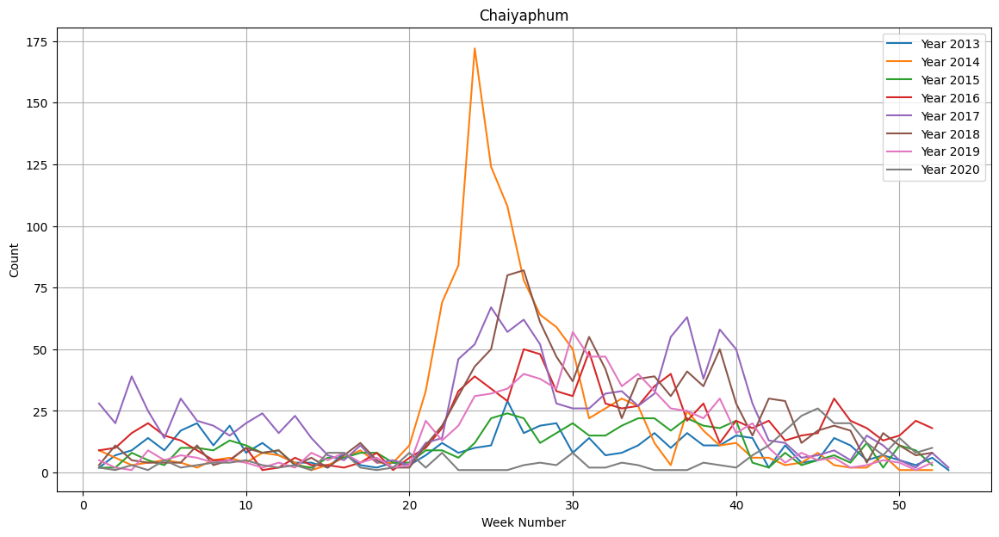


RMSE: 3.5956714699044117


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,XGBoost,-1.754637,-1.754637,-12.426255,root_mean_squared_error,0.021005,0.007090,0.467214,0.021005,0.007090,0.467214,1,True,8
1,ExtraTreesMSE,-2.019266,-2.019266,-12.003248,root_mean_squared_error,0.090995,0.066262,0.935278,0.090995,0.066262,0.935278,1,True,6
2,RandomForestMSE,-2.147336,-2.147336,-11.922309,root_mean_squared_error,0.098758,0.056363,1.205838,0.098758,0.056363,1.205838,1,True,5
3,LightGBMLarge,-2.309139,-2.309139,-10.320040,root_mean_squared_error,0.790705,0.328292,8.083418,0.790705,0.328292,8.083418,1,True,10
4,LightGBM,-2.552614,-2.552614,-8.975110,root_mean_squared_error,0.084804,0.039753,3.044668,0.084804,0.039753,3.044668,1,True,4
5,NeuralNetTorch,-2.781525,-2.781525,-9.441050,root_mean_squared_error,0.014325,0.009008,3.082403,0.014325,0.009008,3.082403,1,True,9
6,LightGBMXT,-2.874664,-2.874664,-9.321151,root_mean_squared_error,0.158720,0.180922,4.591626,0.158720,0.180922,4.591626,1,True,3
7,WeightedEnsemble_L2,-3.595671,-3.595671,-7.831352,root_mean_squared_error,0.056838,0.025268,4.042715,0.026887,0.000602,0.016446,2,True,11
8,NeuralNetFastAI,-4.260383,-4.260383,-7.922256,root_mean_squared_error,0.015625,0.015658,0.943867,0.015625,0.015658,0.943867,1,True,7
9,KNeighborsDist,-4.329151,-4.329151,-14.813189,root_mean_squared_error,0.014705,0.014249,0.010515,0.014705,0.014249,0.010515,1,True,2


In [30]:
province = "Chaiyaphum"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Chaiyaphum = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Chaiyaphum.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Chaiyaphum.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Amnat Charoen

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192003"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.64 GB / 12.67 GB (83.9%)
Disk Space Avail:   76.11 GB / 107.72 GB (70.7%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 3.81437
[2000]	valid_set's rmse: 3.63884
[3000]	valid_set's rmse: 3.5526
[4000]	valid_set's rmse: 3.52565
[5000]	valid_set's rmse: 3.51876
[6000]	valid_set's rmse: 3.5196
[7000]	valid_set's rmse: 3.53338


	-3.5136	 = Validation score   (-root_mean_squared_error)
	1.32s	 = Training   runtime
	0.03s	 = Validation runtime
Fitting model: LightGBM ...
	-3.7334	 = Validation score   (-root_mean_squared_error)
	0.53s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...


[1000]	valid_set's rmse: 3.74068


	-3.4616	 = Validation score   (-root_mean_squared_error)
	0.71s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.4266	 = Validation score   (-root_mean_squared_error)
	0.82s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.16	 = Validation score   (-root_mean_squared_error)
	0.93s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-3.1905	 = Validation score   (-root_mean_squared_error)
	0.39s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.5329	 = Validation score   (-root_mean_squared_error)
	2.99s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...


[1000]	valid_set's rmse: 3.48621
[2000]	valid_set's rmse: 3.4575
[3000]	valid_set's rmse: 3.44838
[4000]	valid_set's rmse: 3.44486
[5000]	valid_set's rmse: 3.4438
[6000]	valid_set's rmse: 3.44354
[7000]	valid_set's rmse: 3.44348
[8000]	valid_set's rmse: 3.44346
[9000]	valid_set's rmse: 3.44346
[10000]	valid_set's rmse: 3.44346


	-3.4435	 = Validation score   (-root_mean_squared_error)
	6.7s	 = Training   runtime
	0.33s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetFastAI': 0.684, 'NeuralNetTorch': 0.316}
	-2.0492	 = Validation score   (-root_mean_squared_error)
	0.03s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 18.71s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 3284.4 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192003")


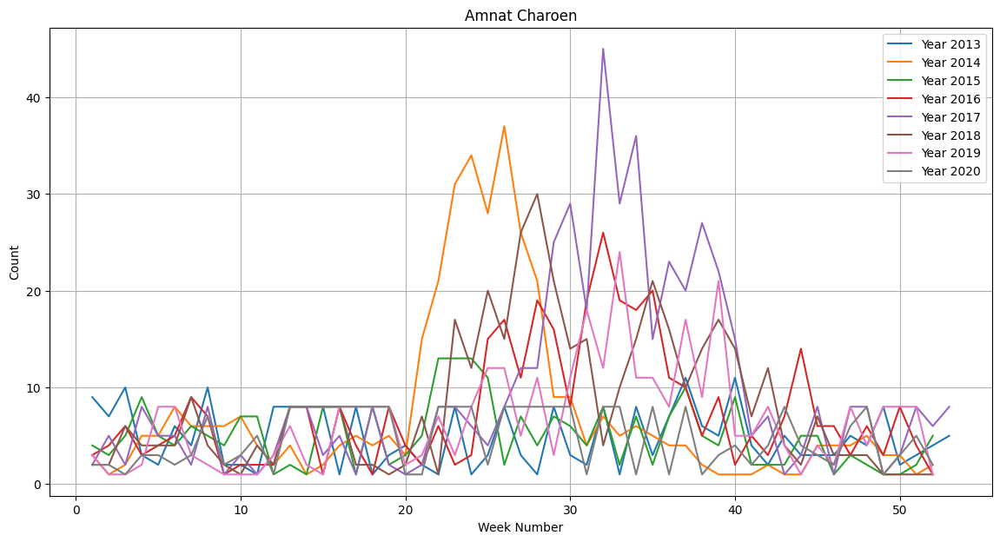


RMSE: 0.9797916706265546


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,LightGBM,-0.722568,-0.722568,-3.733440,root_mean_squared_error,0.029421,0.005070,0.533220,0.029421,0.005070,0.533220,1,True,4
1,LightGBMXT,-0.740196,-0.740196,-3.513629,root_mean_squared_error,0.115666,0.028589,1.323090,0.115666,0.028589,1.323090,1,True,3
2,WeightedEnsemble_L2,-0.979792,-0.979792,-2.049204,root_mean_squared_error,0.063219,0.022531,3.940827,0.025350,0.000855,0.025010,2,True,11
3,NeuralNetTorch,-0.999820,-0.999820,-2.532922,root_mean_squared_error,0.016305,0.010748,2.986149,0.016305,0.010748,2.986149,1,True,9
4,ExtraTreesMSE,-1.171803,-1.171803,-3.426600,root_mean_squared_error,0.086766,0.057648,0.822417,0.086766,0.057648,0.822417,1,True,6
5,LightGBMLarge,-1.191768,-1.191768,-3.443459,root_mean_squared_error,1.027115,0.329395,6.699842,1.027115,0.329395,6.699842,1,True,10
6,NeuralNetFastAI,-1.261883,-1.261883,-2.160047,root_mean_squared_error,0.021565,0.010927,0.929667,0.021565,0.010927,0.929667,1,True,7
7,RandomForestMSE,-1.414765,-1.414765,-3.461567,root_mean_squared_error,0.088948,0.077338,0.706704,0.088948,0.077338,0.706704,1,True,5
8,XGBoost,-1.584924,-1.584924,-3.190501,root_mean_squared_error,0.022144,0.005617,0.387534,0.022144,0.005617,0.387534,1,True,8
9,KNeighborsDist,-2.491329,-2.491329,-4.697157,root_mean_squared_error,0.014219,0.013551,0.009872,0.014219,0.013551,0.009872,1,True,2


In [31]:
province = "Amnat Charoen"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Amnat_Charoen = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Amnat_Charoen.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Amnat_Charoen.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Bueng Kan

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192023"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.65 GB / 12.67 GB (84.1%)
Disk Space Avail:   76.05 GB / 107.72 GB (70.6%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

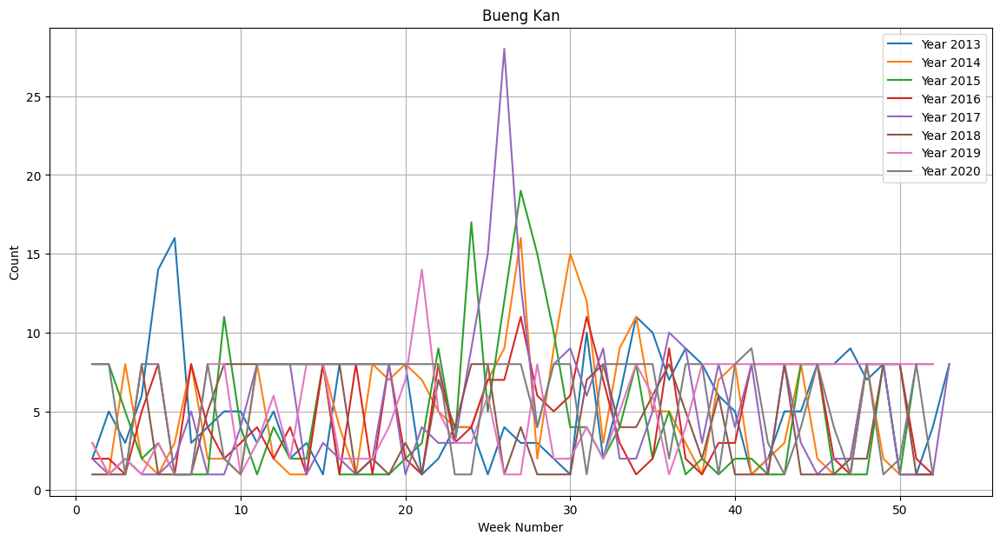


RMSE: 1.5723039779737367


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,RandomForestMSE,-1.317481,-1.317481,-1.724031,root_mean_squared_error,0.087629,0.076118,0.717107,0.087629,0.076118,0.717107,1,True,5
1,ExtraTreesMSE,-1.344066,-1.344066,-1.403465,root_mean_squared_error,0.089057,0.076636,0.620803,0.089057,0.076636,0.620803,1,True,6
2,XGBoost,-1.527921,-1.527921,-1.886370,root_mean_squared_error,0.018159,0.003181,0.181584,0.018159,0.003181,0.181584,1,True,8
3,WeightedEnsemble_L2,-1.572304,-1.572304,-0.872188,root_mean_squared_error,0.061880,0.028119,2.762895,0.005032,0.000569,0.016218,2,True,11
4,LightGBM,-1.598836,-1.598836,-1.655366,root_mean_squared_error,0.003441,0.001614,0.444223,0.003441,0.001614,0.444223,1,True,4
5,LightGBMLarge,-1.611900,-1.611900,-1.448571,root_mean_squared_error,0.019377,0.002824,0.461347,0.019377,0.002824,0.461347,1,True,10
6,NeuralNetFastAI,-1.692112,-1.692112,-1.040029,root_mean_squared_error,0.015444,0.013099,0.643360,0.015444,0.013099,0.643360,1,True,7
7,NeuralNetTorch,-1.701534,-1.701534,-1.271031,root_mean_squared_error,0.022027,0.011627,1.641970,0.022027,0.011627,1.641970,1,True,9
8,LightGBMXT,-1.862296,-1.862296,-1.496093,root_mean_squared_error,0.009787,0.003479,0.359635,0.009787,0.003479,0.359635,1,True,3
9,KNeighborsUnif,-3.275550,-3.275550,-2.960734,root_mean_squared_error,0.013814,0.013498,0.018617,0.013814,0.013498,0.018617,1,True,1


In [32]:
province = "Bueng Kan"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Bueng_Kan = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Bueng_Kan.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Bueng_Kan.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Nong Bua Lamphu

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192030"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.65 GB / 12.67 GB (84.0%)
Disk Space Avail:   76.04 GB / 107.72 GB (70.6%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.47495
[2000]	valid_set's rmse: 2.40372
[3000]	valid_set's rmse: 2.33614
[4000]	valid_set's rmse: 2.28163
[5000]	valid_set's rmse: 2.23502
[6000]	valid_set's rmse: 2.19656
[7000]	valid_set's rmse: 2.15652
[8000]	valid_set's rmse: 2.13125
[9000]	valid_set's rmse: 2.10906
[10000]	valid_set's rmse: 2.08719


	-2.0861	 = Validation score   (-root_mean_squared_error)
	1.78s	 = Training   runtime
	0.05s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's rmse: 2.4133
[2000]	valid_set's rmse: 2.25847
[3000]	valid_set's rmse: 2.17408
[4000]	valid_set's rmse: 2.11169
[5000]	valid_set's rmse: 2.05592
[6000]	valid_set's rmse: 2.00168
[7000]	valid_set's rmse: 1.95602
[8000]	valid_set's rmse: 1.92021
[9000]	valid_set's rmse: 1.8912
[10000]	valid_set's rmse: 1.86758


	-1.8676	 = Validation score   (-root_mean_squared_error)
	3.47s	 = Training   runtime
	0.11s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.068	 = Validation score   (-root_mean_squared_error)
	0.65s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.0922	 = Validation score   (-root_mean_squared_error)
	0.6s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.2467	 = Validation score   (-root_mean_squared_error)
	0.61s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-1.7501	 = Validation score   (-root_mean_squared_error)
	0.29s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.6952	 = Validation score   (-root_mean_squared_error)
	2.43s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...


[1000]	valid_set's rmse: 1.8415


	-1.8383	 = Validation score   (-root_mean_squared_error)
	1.05s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetFastAI': 0.84, 'LightGBM': 0.08, 'XGBoost': 0.04, 'NeuralNetTorch': 0.04}
	-1.2372	 = Validation score   (-root_mean_squared_error)
	0.02s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 13.13s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 546.7 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192030")


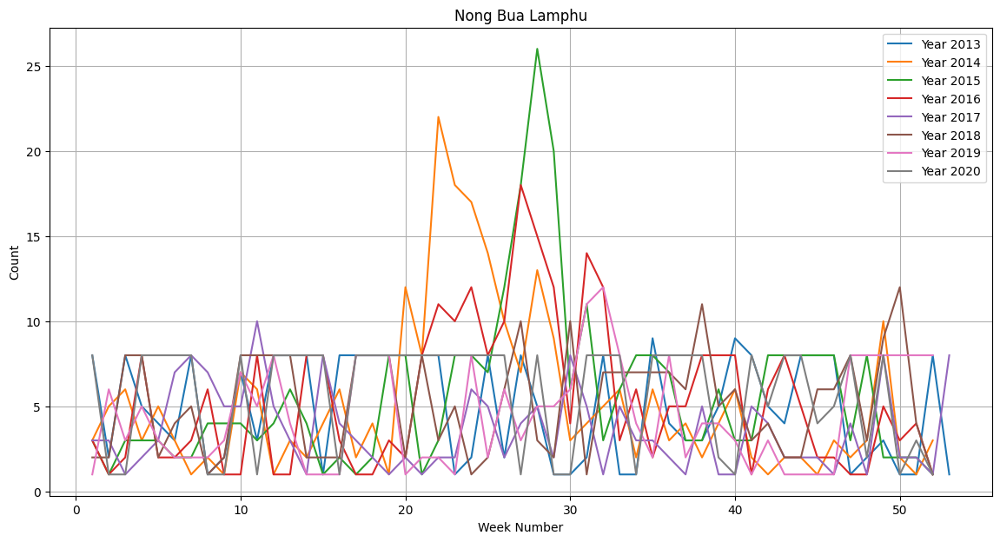


RMSE: 1.3307910891235974


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,XGBoost,-0.646235,-0.646235,-1.750123,root_mean_squared_error,0.018976,0.004985,0.286660,0.018976,0.004985,0.286660,1,True,8
1,NeuralNetTorch,-0.810799,-0.810799,-1.695199,root_mean_squared_error,0.010940,0.009301,2.426092,0.010940,0.009301,2.426092,1,True,9
2,ExtraTreesMSE,-0.969660,-0.969660,-2.092154,root_mean_squared_error,0.090900,0.088702,0.603137,0.090900,0.088702,0.603137,1,True,6
3,LightGBMLarge,-1.085308,-1.085308,-1.838329,root_mean_squared_error,0.051765,0.015003,1.054462,0.051765,0.015003,1.054462,1,True,10
4,LightGBMXT,-1.103259,-1.103259,-2.086059,root_mean_squared_error,0.141559,0.050183,1.779397,0.141559,0.050183,1.779397,1,True,3
5,RandomForestMSE,-1.179879,-1.179879,-2.068003,root_mean_squared_error,0.101000,0.077400,0.649668,0.101000,0.077400,0.649668,1,True,5
6,LightGBM,-1.257025,-1.257025,-1.867583,root_mean_squared_error,0.179218,0.112654,3.470635,0.179218,0.112654,3.470635,1,True,4
7,WeightedEnsemble_L2,-1.330791,-1.330791,-1.237217,root_mean_squared_error,0.230304,0.135350,6.806537,0.005965,0.000599,0.015715,2,True,11
8,NeuralNetFastAI,-1.492064,-1.492064,-1.246726,root_mean_squared_error,0.015204,0.007811,0.607435,0.015204,0.007811,0.607435,1,True,7
9,KNeighborsUnif,-2.983674,-2.983674,-3.114482,root_mean_squared_error,0.014101,0.015874,0.008003,0.014101,0.015874,0.008003,1,True,1


In [33]:
province = "Nong Bua Lamphu"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Nong_Bua_Lamphu = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Nong_Bua_Lamphu.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Nong_Bua_Lamphu.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

## Khon Kaen

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192045"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.64 GB / 12.67 GB (83.9%)
Disk Space Avail:   76.01 GB / 107.72 GB (70.6%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 9.63811


	-9.4202	 = Validation score   (-root_mean_squared_error)
	0.31s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-8.4074	 = Validation score   (-root_mean_squared_error)
	0.75s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-8.9739	 = Validation score   (-root_mean_squared_error)
	0.93s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-7.3918	 = Validation score   (-root_mean_squared_error)
	0.95s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-7.1266	 = Validation score   (-root_mean_squared_error)
	0.66s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-6.0938	 = Validation score   (-root_mean_squared_error)
	4.94s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...


[1000]	valid_set's rmse: 9.20756


	-9.1847	 = Validation score   (-root_mean_squared_error)
	1.39s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.652, 'XGBoost': 0.348}
	-5.666	 = Validation score   (-root_mean_squared_error)
	0.02s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 11.83s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 3888.1 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192045")


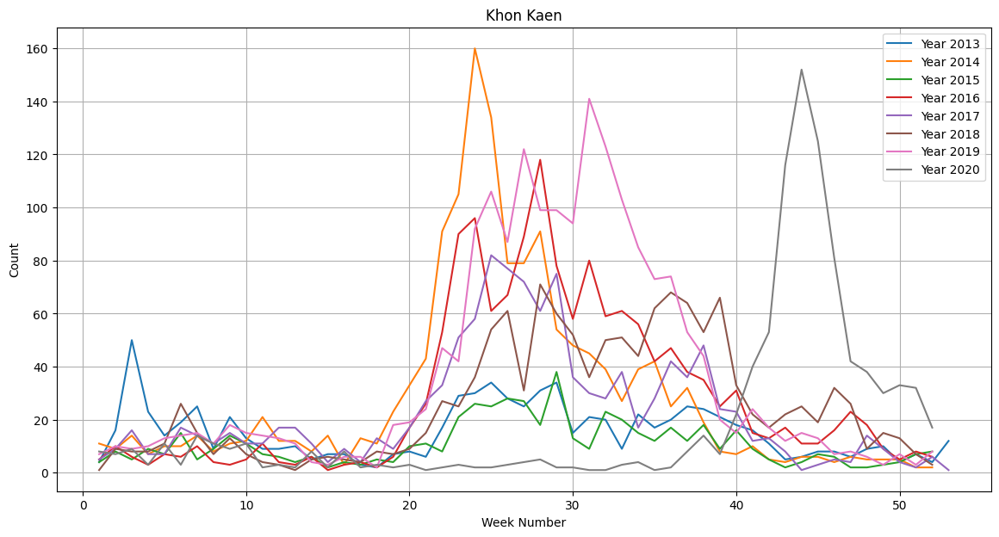


RMSE: 8.085897799339794


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetTorch,-6.885545,-6.885545,-6.093753,root_mean_squared_error,0.011145,0.009511,4.937716,0.011145,0.009511,4.937716,1,True,9
1,WeightedEnsemble_L2,-8.085898,-8.085898,-5.665962,root_mean_squared_error,0.044807,0.019032,5.610509,0.004209,0.000514,0.015061,2,True,11
2,XGBoost,-11.908221,-11.908221,-7.126550,root_mean_squared_error,0.029453,0.009007,0.657732,0.029453,0.009007,0.657732,1,True,8
3,LightGBMLarge,-11.978436,-11.978436,-9.184728,root_mean_squared_error,0.069559,0.022942,1.386770,0.069559,0.022942,1.386770,1,True,10
4,ExtraTreesMSE,-12.335494,-12.335494,-8.973881,root_mean_squared_error,0.095052,0.070195,0.926196,0.095052,0.070195,0.926196,1,True,6
5,NeuralNetFastAI,-12.376401,-12.376401,-7.391758,root_mean_squared_error,0.016242,0.011330,0.953086,0.016242,0.011330,0.953086,1,True,7
6,RandomForestMSE,-12.530978,-12.530978,-8.407424,root_mean_squared_error,0.081743,0.067429,0.751068,0.081743,0.067429,0.751068,1,True,5
7,KNeighborsDist,-13.577461,-13.577461,-11.894041,root_mean_squared_error,0.014019,0.014436,0.009899,0.014019,0.014436,0.009899,1,True,2
8,KNeighborsUnif,-13.898561,-13.898561,-12.129883,root_mean_squared_error,0.014495,0.020630,0.017618,0.014495,0.020630,0.017618,1,True,1
9,LightGBM,-14.130986,-14.130986,-9.420233,root_mean_squared_error,0.004352,0.001358,0.313769,0.004352,0.001358,0.313769,1,True,4


In [34]:
province = "Khon Kaen"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Khon_Kaen = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Khon_Kaen.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Khon_Kaen.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Udon Thani

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192058"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.65 GB / 12.67 GB (84.0%)
Disk Space Avail:   75.99 GB / 107.72 GB (70.5%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.62743
[2000]	valid_set's rmse: 2.40252
[3000]	valid_set's rmse: 2.36787
[4000]	valid_set's rmse: 2.37456


	-2.3616	 = Validation score   (-root_mean_squared_error)
	0.99s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-2.7234	 = Validation score   (-root_mean_squared_error)
	0.38s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.3411	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.2002	 = Validation score   (-root_mean_squared_error)
	0.91s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.5375	 = Validation score   (-root_mean_squared_error)
	0.99s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-3.3851	 = Validation score   (-root_mean_squared_error)
	0.49s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.4952	 = Validation score   (-root_mean_squared_error)
	2.96s	 = Training   run

[1000]	valid_set's rmse: 3.06438
[2000]	valid_set's rmse: 3.05313
[3000]	valid_set's rmse: 3.05274


	-3.0521	 = Validation score   (-root_mean_squared_error)
	1.99s	 = Training   runtime
	0.04s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'LightGBMXT': 0.36, 'NeuralNetTorch': 0.36, 'NeuralNetFastAI': 0.16, 'LightGBMLarge': 0.12}
	-1.9596	 = Validation score   (-root_mean_squared_error)
	0.02s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 10.89s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 975.3 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192058")


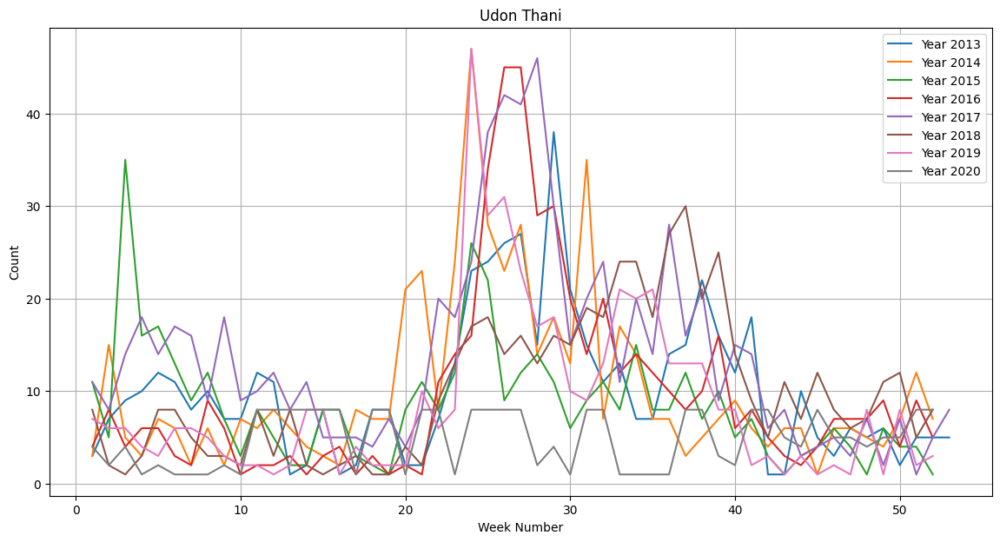


RMSE: 1.167462077552045


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,LightGBM,-1.119226,-1.119226,-2.723442,root_mean_squared_error,0.014268,0.003094,0.375489,0.014268,0.003094,0.375489,1,True,4
1,WeightedEnsemble_L2,-1.167462,-1.167462,-1.959572,root_mean_squared_error,0.223768,0.075878,6.936567,0.009897,0.000523,0.015808,2,True,11
2,LightGBMXT,-1.195944,-1.195944,-2.361614,root_mean_squared_error,0.048838,0.019321,0.990355,0.048838,0.019321,0.990355,1,True,3
3,ExtraTreesMSE,-1.378625,-1.378625,-3.200211,root_mean_squared_error,0.091759,0.055461,0.911936,0.091759,0.055461,0.911936,1,True,6
4,XGBoost,-1.447666,-1.447666,-3.385126,root_mean_squared_error,0.019110,0.007265,0.488949,0.019110,0.007265,0.488949,1,True,8
5,RandomForestMSE,-1.476634,-1.476634,-3.341057,root_mean_squared_error,0.079476,0.065256,0.642825,0.079476,0.065256,0.642825,1,True,5
6,NeuralNetTorch,-1.592799,-1.592799,-2.495229,root_mean_squared_error,0.011007,0.008070,2.956705,0.011007,0.008070,2.956705,1,True,9
7,LightGBMLarge,-1.707631,-1.707631,-3.052111,root_mean_squared_error,0.139466,0.035509,1.987486,0.139466,0.035509,1.987486,1,True,10
8,NeuralNetFastAI,-1.818147,-1.818147,-2.537487,root_mean_squared_error,0.014560,0.012455,0.986214,0.014560,0.012455,0.986214,1,True,7
9,KNeighborsUnif,-3.681032,-3.681032,-4.628408,root_mean_squared_error,0.014361,0.024466,0.007616,0.014361,0.024466,0.007616,1,True,1


In [35]:
province = "Udon Thani"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Udon_Thani = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Udon_Thani.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Udon_Thani.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Loei

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192110"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.65 GB / 12.67 GB (84.0%)
Disk Space Avail:   75.96 GB / 107.72 GB (70.5%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 6.25123
[2000]	valid_set's rmse: 5.73249
[3000]	valid_set's rmse: 5.55483
[4000]	valid_set's rmse: 5.45608
[5000]	valid_set's rmse: 5.44407
[6000]	valid_set's rmse: 5.45104


	-5.4355	 = Validation score   (-root_mean_squared_error)
	1.21s	 = Training   runtime
	0.03s	 = Validation runtime
Fitting model: LightGBM ...
	-5.5798	 = Validation score   (-root_mean_squared_error)
	0.35s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-5.3286	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-5.8904	 = Validation score   (-root_mean_squared_error)
	0.6s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-4.7469	 = Validation score   (-root_mean_squared_error)
	0.77s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-5.8098	 = Validation score   (-root_mean_squared_error)
	0.52s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-5.3308	 = Validation score   (-root_mean_squared_error)
	2.93s	 = Training   runt

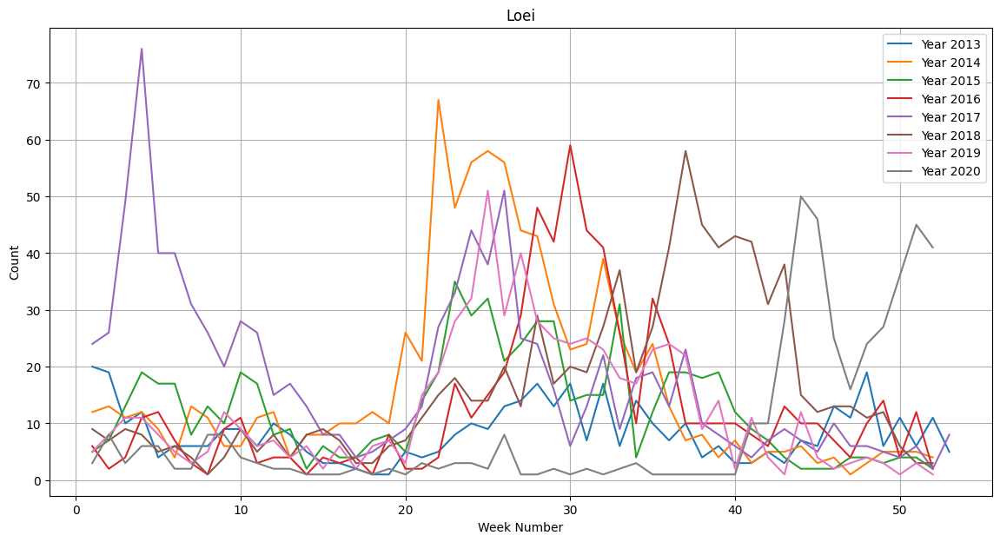


RMSE: 3.7583560500957116


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-3.758356,-3.758356,-4.462120,root_mean_squared_error,0.098521,0.050637,4.926507,0.003492,0.000496,0.015466,2,True,11
1,NeuralNetFastAI,-3.868459,-3.868459,-4.746858,root_mean_squared_error,0.016462,0.011723,0.767569,0.016462,0.011723,0.767569,1,True,7
2,LightGBM,-3.969855,-3.969855,-5.579825,root_mean_squared_error,0.012346,0.002887,0.350215,0.012346,0.002887,0.350215,1,True,4
3,LightGBMXT,-4.223241,-4.223241,-5.435463,root_mean_squared_error,0.066744,0.026396,1.211767,0.066744,0.026396,1.211767,1,True,3
4,RandomForestMSE,-4.326730,-4.326730,-5.328592,root_mean_squared_error,0.102586,0.079243,0.635890,0.102586,0.079243,0.635890,1,True,5
5,ExtraTreesMSE,-4.390378,-4.390378,-5.890358,root_mean_squared_error,0.083654,0.078083,0.604750,0.083654,0.078083,0.604750,1,True,6
6,XGBoost,-4.673888,-4.673888,-5.809798,root_mean_squared_error,0.020150,0.007551,0.516189,0.020150,0.007551,0.516189,1,True,8
7,LightGBMLarge,-5.083338,-5.083338,-5.882871,root_mean_squared_error,0.014760,0.003765,0.519417,0.014760,0.003765,0.519417,1,True,10
8,NeuralNetTorch,-5.214830,-5.214830,-5.330793,root_mean_squared_error,0.011823,0.012022,2.931704,0.011823,0.012022,2.931704,1,True,9
9,KNeighborsDist,-8.259135,-8.259135,-7.366099,root_mean_squared_error,0.014627,0.014416,0.012054,0.014627,0.014416,0.012054,1,True,2


In [36]:
province = "Loei"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Loei = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Loei.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Loei.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Nong Khai

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192119"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.65 GB / 12.67 GB (84.0%)
Disk Space Avail:   75.94 GB / 107.72 GB (70.5%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.42694
[2000]	valid_set's rmse: 2.35762


	-2.3427	 = Validation score   (-root_mean_squared_error)
	0.76s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-2.4448	 = Validation score   (-root_mean_squared_error)
	0.37s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.572	 = Validation score   (-root_mean_squared_error)
	0.62s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.4539	 = Validation score   (-root_mean_squared_error)
	0.62s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.9731	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.5646	 = Validation score   (-root_mean_squared_error)
	0.26s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.4346	 = Validation score   (-root_mean_squared_error)
	2.21s	 = Training   runti

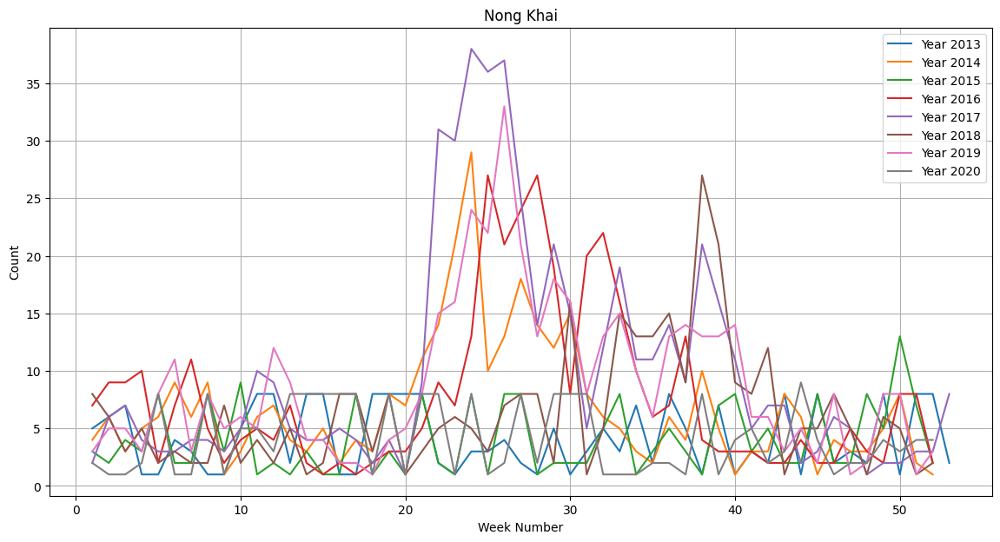


RMSE: 1.0979376124307325


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,RandomForestMSE,-0.961376,-0.961376,-2.571997,root_mean_squared_error,0.088108,0.076938,0.615100,0.088108,0.076938,0.615100,1,True,5
1,NeuralNetTorch,-1.064902,-1.064902,-1.434594,root_mean_squared_error,0.010718,0.009449,2.211128,0.010718,0.009449,2.211128,1,True,9
2,ExtraTreesMSE,-1.078654,-1.078654,-2.453936,root_mean_squared_error,0.089549,0.076123,0.618485,0.089549,0.076123,0.618485,1,True,6
3,WeightedEnsemble_L2,-1.097938,-1.097938,-1.326129,root_mean_squared_error,0.033437,0.018199,2.873844,0.003333,0.000543,0.020032,2,True,11
4,LightGBM,-1.123647,-1.123647,-2.444847,root_mean_squared_error,0.005891,0.001541,0.374130,0.005891,0.001541,0.374130,1,True,4
5,LightGBMXT,-1.139544,-1.139544,-2.342690,root_mean_squared_error,0.025466,0.011173,0.758335,0.025466,0.011173,0.758335,1,True,3
6,XGBoost,-1.159144,-1.159144,-2.564618,root_mean_squared_error,0.017615,0.004318,0.262790,0.017615,0.004318,0.262790,1,True,8
7,LightGBMLarge,-1.203369,-1.203369,-2.414897,root_mean_squared_error,0.015903,0.003402,0.530343,0.015903,0.003402,0.530343,1,True,10
8,NeuralNetFastAI,-2.055891,-2.055891,-1.973144,root_mean_squared_error,0.019385,0.008207,0.642684,0.019385,0.008207,0.642684,1,True,7
9,KNeighborsDist,-2.874693,-2.874693,-3.317910,root_mean_squared_error,0.013936,0.014139,0.009647,0.013936,0.014139,0.009647,1,True,2


In [37]:
province = "Nong Khai"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Nong_Khai = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Nong_Khai.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Nong_Khai.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Maha Sarakham

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_194607"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.31 GB / 12.67 GB (81.4%)
Disk Space Avail:   74.85 GB / 107.72 GB (69.5%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 4.45186
[2000]	valid_set's rmse: 4.31647
[3000]	valid_set's rmse: 4.30082


	-4.2881	 = Validation score   (-root_mean_squared_error)
	1.71s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-4.4684	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-4.596	 = Validation score   (-root_mean_squared_error)
	1.15s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-4.6033	 = Validation score   (-root_mean_squared_error)
	1.03s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-3.011	 = Validation score   (-root_mean_squared_error)
	1.0s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-4.7994	 = Validation score   (-root_mean_squared_error)
	0.53s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-3.4245	 = Validation score   (-root_mean_squared_error)
	2.94s	 = Training   runti

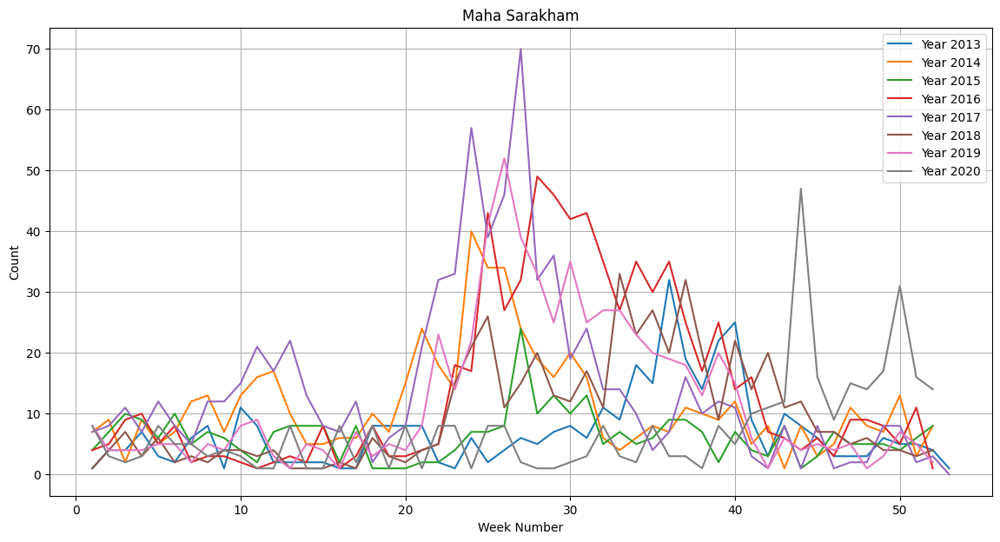


RMSE: 3.5254873624798875


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,LightGBMXT,-3.458948,-3.458948,-4.288076,root_mean_squared_error,0.127641,0.023125,1.707397,0.127641,0.023125,1.707397,1,True,3
1,NeuralNetFastAI,-3.491701,-3.491701,-3.010950,root_mean_squared_error,0.037778,0.013427,0.998945,0.037778,0.013427,0.998945,1,True,7
2,WeightedEnsemble_L2,-3.525487,-3.525487,-2.793597,root_mean_squared_error,0.086012,0.027260,3.988100,0.015699,0.000789,0.051506,2,True,11
3,LightGBM,-3.537243,-3.537243,-4.468357,root_mean_squared_error,0.040936,0.005722,0.638933,0.040936,0.005722,0.638933,1,True,4
4,XGBoost,-3.718081,-3.718081,-4.799426,root_mean_squared_error,0.064466,0.007756,0.533840,0.064466,0.007756,0.533840,1,True,8
5,LightGBMLarge,-4.003853,-4.003853,-5.001337,root_mean_squared_error,0.082979,0.015486,1.248871,0.082979,0.015486,1.248871,1,True,10
6,NeuralNetTorch,-4.275174,-4.275174,-3.424516,root_mean_squared_error,0.032536,0.013044,2.937649,0.032536,0.013044,2.937649,1,True,9
7,RandomForestMSE,-4.343963,-4.343963,-4.595952,root_mean_squared_error,0.130906,0.073422,1.152919,0.130906,0.073422,1.152919,1,True,5
8,ExtraTreesMSE,-4.483947,-4.483947,-4.603303,root_mean_squared_error,0.134976,0.067096,1.034750,0.134976,0.067096,1.034750,1,True,6
9,KNeighborsDist,-6.309019,-6.309019,-6.119545,root_mean_squared_error,0.034558,0.028624,0.018167,0.034558,0.028624,0.018167,1,True,2


In [96]:
province = "Maha Sarakham"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Maha_Sarakham = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Maha_Sarakham.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Maha_Sarakham.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Roi Et

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192136"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.91 GB / 107.72 GB (70.5%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 5.17445
[2000]	valid_set's rmse: 5.08254


	-5.0723	 = Validation score   (-root_mean_squared_error)
	0.66s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-4.3031	 = Validation score   (-root_mean_squared_error)
	0.31s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-4.2142	 = Validation score   (-root_mean_squared_error)
	0.66s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-4.1502	 = Validation score   (-root_mean_squared_error)
	0.61s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-4.6603	 = Validation score   (-root_mean_squared_error)
	0.71s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-4.014	 = Validation score   (-root_mean_squared_error)
	0.41s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.9588	 = Validation score   (-root_mean_squared_error)
	4.55s	 = Training   runt

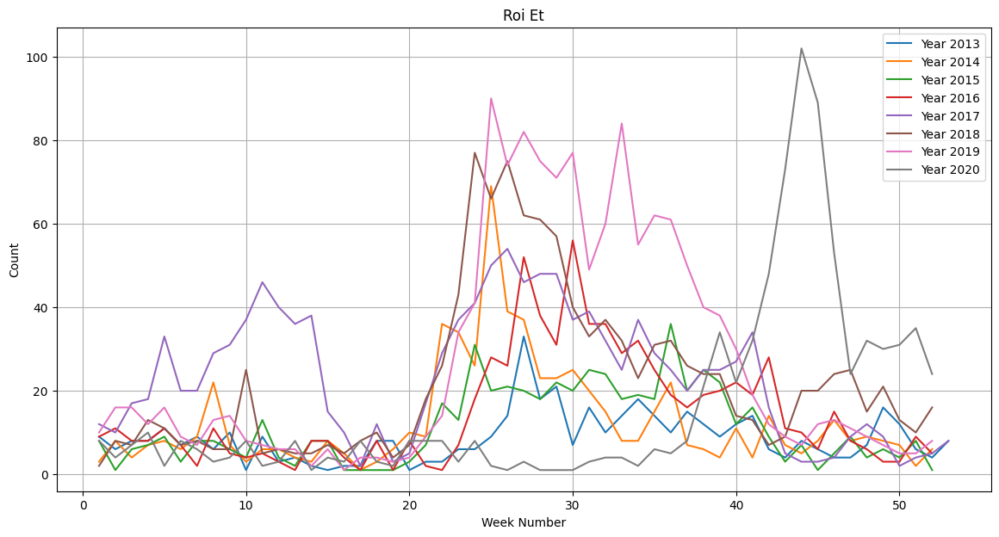


RMSE: 6.2877829030512755


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-6.287783,-6.287783,-2.632799,root_mean_squared_error,0.051456,0.026861,5.679990,0.005339,0.000528,0.015239,2,True,11
1,NeuralNetTorch,-6.488621,-6.488621,-2.958831,root_mean_squared_error,0.010767,0.008205,4.551905,0.010767,0.008205,4.551905,1,True,9
2,LightGBMLarge,-7.404888,-7.404888,-4.911936,root_mean_squared_error,0.016703,0.003649,0.552884,0.016703,0.003649,0.552884,1,True,10
3,RandomForestMSE,-7.866710,-7.866710,-4.214174,root_mean_squared_error,0.090014,0.076538,0.663617,0.090014,0.076538,0.663617,1,True,5
4,ExtraTreesMSE,-8.154202,-8.154202,-4.150189,root_mean_squared_error,0.098855,0.075635,0.611042,0.098855,0.075635,0.611042,1,True,6
5,NeuralNetFastAI,-8.475738,-8.475738,-4.660303,root_mean_squared_error,0.014413,0.011587,0.706143,0.014413,0.011587,0.706143,1,True,7
6,XGBoost,-8.977353,-8.977353,-4.014003,root_mean_squared_error,0.020937,0.006541,0.406703,0.020937,0.006541,0.406703,1,True,8
7,LightGBM,-9.289092,-9.289092,-4.303088,root_mean_squared_error,0.005226,0.001432,0.312196,0.005226,0.001432,0.312196,1,True,4
8,LightGBMXT,-9.827686,-9.827686,-5.072339,root_mean_squared_error,0.027165,0.012125,0.662033,0.027165,0.012125,0.662033,1,True,3
9,KNeighborsDist,-10.198449,-10.198449,-5.144547,root_mean_squared_error,0.014059,0.014190,0.007662,0.014059,0.014190,0.007662,1,True,2


In [39]:
province = "Roi Et"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Roi_Et = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Roi_Et.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Roi_Et.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Kalasin

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192147"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.62 GB / 12.67 GB (83.8%)
Disk Space Avail:   75.89 GB / 107.72 GB (70.5%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 3.60635
[2000]	valid_set's rmse: 3.3689
[3000]	valid_set's rmse: 3.40208


	-3.3239	 = Validation score   (-root_mean_squared_error)
	1.06s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-3.7283	 = Validation score   (-root_mean_squared_error)
	0.4s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.4986	 = Validation score   (-root_mean_squared_error)
	1.13s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.2738	 = Validation score   (-root_mean_squared_error)
	0.6s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.8605	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-3.2142	 = Validation score   (-root_mean_squared_error)
	0.35s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.5227	 = Validation score   (-root_mean_squared_error)
	4.17s	 = Training   runti

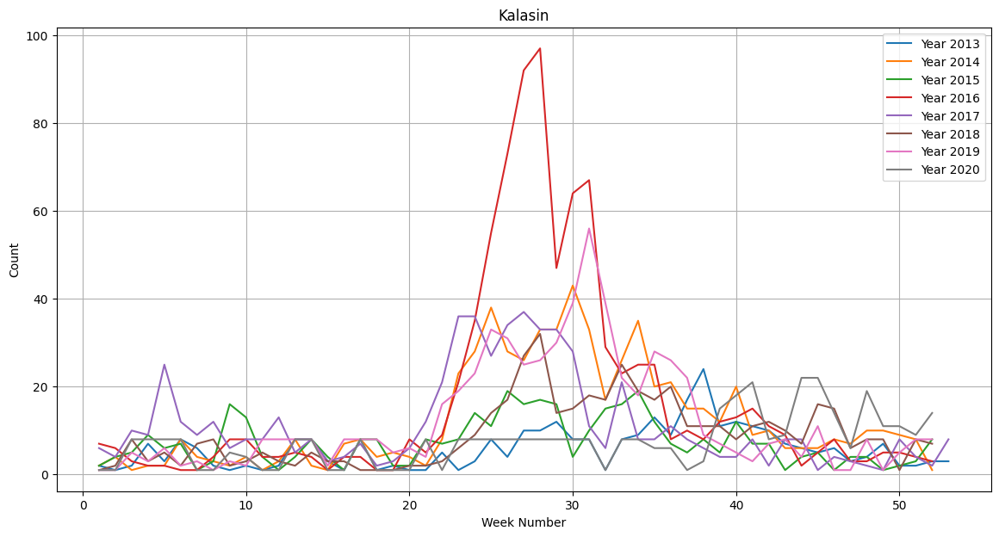


RMSE: 2.184077897293447


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,LightGBMXT,-1.735167,-1.735167,-3.323886,root_mean_squared_error,0.062873,0.017623,1.062903,0.062873,0.017623,1.062903,1,True,3
1,WeightedEnsemble_L2,-2.184078,-2.184078,-2.242097,root_mean_squared_error,0.091105,0.038896,5.903520,0.003623,0.000803,0.027195,2,True,11
2,ExtraTreesMSE,-2.463938,-2.463938,-3.273789,root_mean_squared_error,0.079864,0.077451,0.603125,0.079864,0.077451,0.603125,1,True,6
3,NeuralNetTorch,-2.553311,-2.553311,-2.522676,root_mean_squared_error,0.010737,0.012477,4.172930,0.010737,0.012477,4.172930,1,True,9
4,XGBoost,-2.583385,-2.583385,-3.214186,root_mean_squared_error,0.019498,0.005143,0.351664,0.019498,0.005143,0.351664,1,True,8
5,RandomForestMSE,-2.658313,-2.658313,-3.498592,root_mean_squared_error,0.086966,0.077500,1.134614,0.086966,0.077500,1.134614,1,True,5
6,LightGBMLarge,-2.690219,-2.690219,-3.501403,root_mean_squared_error,0.010689,0.003284,0.629209,0.010689,0.003284,0.629209,1,True,10
7,LightGBM,-2.939445,-2.939445,-3.728254,root_mean_squared_error,0.006198,0.001378,0.398378,0.006198,0.001378,0.398378,1,True,4
8,NeuralNetFastAI,-3.004616,-3.004616,-2.860451,root_mean_squared_error,0.013872,0.007992,0.640491,0.013872,0.007992,0.640491,1,True,7
9,KNeighborsDist,-4.860194,-4.860194,-5.112446,root_mean_squared_error,0.015502,0.019515,0.014771,0.015502,0.019515,0.014771,1,True,2


In [40]:
province = "Kalasin"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Kalasin = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Kalasin.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Kalasin.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Sakon Nakhon

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192158"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.62 GB / 12.67 GB (83.8%)
Disk Space Avail:   75.88 GB / 107.72 GB (70.4%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.19124
[2000]	valid_set's rmse: 2.13576


	-2.1234	 = Validation score   (-root_mean_squared_error)
	0.59s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-2.092	 = Validation score   (-root_mean_squared_error)
	0.3s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.079	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.9199	 = Validation score   (-root_mean_squared_error)
	0.61s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.2403	 = Validation score   (-root_mean_squared_error)
	0.66s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.9617	 = Validation score   (-root_mean_squared_error)
	0.22s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.1429	 = Validation score   (-root_mean_squared_error)
	1.78s	 = Training   runtime

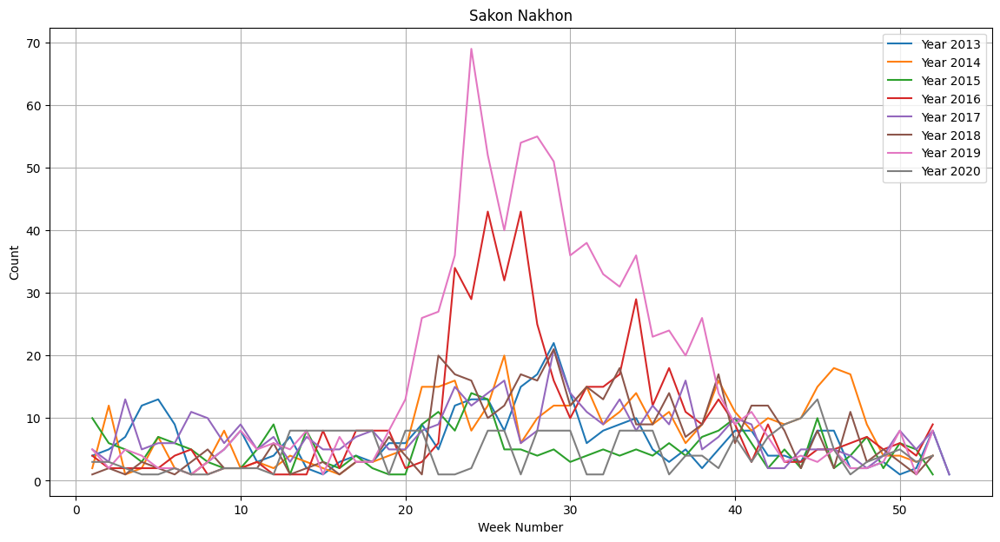


RMSE: 1.5393463698699374


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,LightGBMXT,-1.075958,-1.075958,-2.123431,root_mean_squared_error,0.027635,0.010067,0.593089,0.027635,0.010067,0.593089,1,True,3
1,XGBoost,-1.455467,-1.455467,-2.961664,root_mean_squared_error,0.011775,0.003273,0.223977,0.011775,0.003273,0.223977,1,True,8
2,RandomForestMSE,-1.515899,-1.515899,-3.078969,root_mean_squared_error,0.079181,0.078143,0.641420,0.079181,0.078143,0.641420,1,True,5
3,WeightedEnsemble_L2,-1.539346,-1.539346,-1.804819,root_mean_squared_error,0.061639,0.031722,3.352826,0.004379,0.000510,0.015241,2,True,11
4,ExtraTreesMSE,-1.601103,-1.601103,-2.919904,root_mean_squared_error,0.091843,0.081929,0.610360,0.091843,0.081929,0.610360,1,True,6
5,LightGBMLarge,-1.757230,-1.757230,-3.125626,root_mean_squared_error,0.018823,0.003629,0.521593,0.018823,0.003629,0.521593,1,True,10
6,NeuralNetFastAI,-1.971075,-1.971075,-2.240284,root_mean_squared_error,0.013906,0.011085,0.663625,0.013906,0.011085,0.663625,1,True,7
7,NeuralNetTorch,-2.033753,-2.033753,-2.142950,root_mean_squared_error,0.010498,0.008327,1.779508,0.010498,0.008327,1.779508,1,True,9
8,LightGBM,-2.375118,-2.375118,-2.092032,root_mean_squared_error,0.005220,0.001734,0.301363,0.005220,0.001734,0.301363,1,True,4
9,KNeighborsDist,-3.139781,-3.139781,-3.534772,root_mean_squared_error,0.013829,0.013834,0.009700,0.013829,0.013834,0.009700,1,True,2


In [41]:
province = "Sakon Nakhon"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Sakon_Nakhon = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Sakon_Nakhon.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Sakon_Nakhon.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Nakhon Phanom

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192205"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.86 GB / 107.72 GB (70.4%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.89642
[2000]	valid_set's rmse: 2.7821
[3000]	valid_set's rmse: 2.72909
[4000]	valid_set's rmse: 2.70478
[5000]	valid_set's rmse: 2.68471
[6000]	valid_set's rmse: 2.68057
[7000]	valid_set's rmse: 2.68096
[8000]	valid_set's rmse: 2.6785
[9000]	valid_set's rmse: 2.68621


	-2.6767	 = Validation score   (-root_mean_squared_error)
	1.57s	 = Training   runtime
	0.04s	 = Validation runtime
Fitting model: LightGBM ...
	-2.8855	 = Validation score   (-root_mean_squared_error)
	0.45s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.9694	 = Validation score   (-root_mean_squared_error)
	1.03s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.0253	 = Validation score   (-root_mean_squared_error)
	0.97s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.6327	 = Validation score   (-root_mean_squared_error)
	0.74s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.6924	 = Validation score   (-root_mean_squared_error)
	0.29s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.0167	 = Validation score   (-root_mean_squared_error)
	2.43s	 = Training   run

[1000]	valid_set's rmse: 2.47406
[2000]	valid_set's rmse: 2.45672
[3000]	valid_set's rmse: 2.45628
[4000]	valid_set's rmse: 2.45608
[5000]	valid_set's rmse: 2.45604
[6000]	valid_set's rmse: 2.45604
[7000]	valid_set's rmse: 2.45604
[8000]	valid_set's rmse: 2.45604
[9000]	valid_set's rmse: 2.45604
[10000]	valid_set's rmse: 2.45604


	-2.456	 = Validation score   (-root_mean_squared_error)
	6.58s	 = Training   runtime
	0.28s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.588, 'LightGBMLarge': 0.294, 'LightGBMXT': 0.118}
	-1.8904	 = Validation score   (-root_mean_squared_error)
	0.03s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 18.96s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 223.7 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192205")


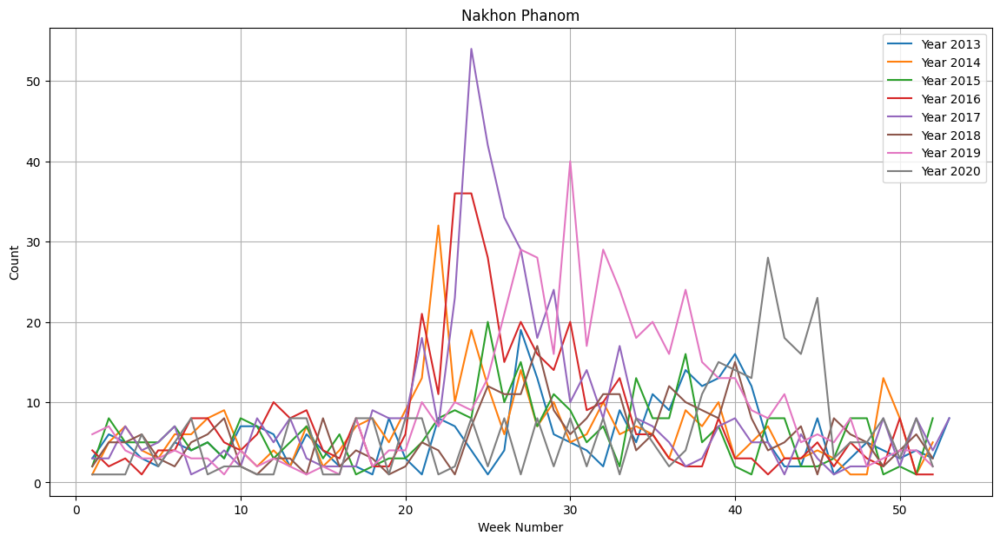


RMSE: 2.085918151367566


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-2.085918,-2.085918,-1.890410,root_mean_squared_error,0.881980,0.330769,10.599716,0.026610,0.000777,0.025444,2,True,11
1,LightGBMXT,-2.172396,-2.172396,-2.676672,root_mean_squared_error,0.135903,0.039570,1.565082,0.135903,0.039570,1.565082,1,True,3
2,NeuralNetTorch,-2.188771,-2.188771,-2.016694,root_mean_squared_error,0.014609,0.012152,2.428732,0.014609,0.012152,2.428732,1,True,9
3,LightGBM,-2.289527,-2.289527,-2.885500,root_mean_squared_error,0.012692,0.002813,0.451713,0.012692,0.002813,0.451713,1,True,4
4,NeuralNetFastAI,-2.700792,-2.700792,-2.632717,root_mean_squared_error,0.014862,0.013891,0.736670,0.014862,0.013891,0.736670,1,True,7
5,ExtraTreesMSE,-2.805933,-2.805933,-3.025341,root_mean_squared_error,0.092120,0.066158,0.966703,0.092120,0.066158,0.966703,1,True,6
6,LightGBMLarge,-2.973027,-2.973027,-2.456038,root_mean_squared_error,0.704857,0.278269,6.580458,0.704857,0.278269,6.580458,1,True,10
7,XGBoost,-3.062716,-3.062716,-2.692378,root_mean_squared_error,0.019526,0.005111,0.289229,0.019526,0.005111,0.289229,1,True,8
8,RandomForestMSE,-3.217052,-3.217052,-2.969394,root_mean_squared_error,0.088952,0.055621,1.029119,0.088952,0.055621,1.029119,1,True,5
9,KNeighborsDist,-4.248171,-4.248171,-4.552439,root_mean_squared_error,0.016599,0.013271,0.007668,0.016599,0.013271,0.007668,1,True,2


In [42]:
province = "Nakhon Phanom"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Nakhon_Phanom = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Nakhon_Phanom.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Nakhon_Phanom.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Mukdahan

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192227"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.62 GB / 12.67 GB (83.8%)
Disk Space Avail:   75.80 GB / 107.72 GB (70.4%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.10905
[2000]	valid_set's rmse: 2.03807


	-2.025	 = Validation score   (-root_mean_squared_error)
	0.74s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-1.7368	 = Validation score   (-root_mean_squared_error)
	0.51s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-1.9671	 = Validation score   (-root_mean_squared_error)
	0.7s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.1848	 = Validation score   (-root_mean_squared_error)
	0.6s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.7517	 = Validation score   (-root_mean_squared_error)
	0.65s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-1.636	 = Validation score   (-root_mean_squared_error)
	0.26s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.4385	 = Validation score   (-root_mean_squared_error)
	2.08s	 = Training   runtime


[1000]	valid_set's rmse: 1.82149


	-1.8204	 = Validation score   (-root_mean_squared_error)
	1.2s	 = Training   runtime
	0.03s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.429, 'NeuralNetFastAI': 0.286, 'XGBoost': 0.19, 'LightGBM': 0.095}
	-1.1982	 = Validation score   (-root_mean_squared_error)
	0.02s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 8.16s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 2971.6 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192227")


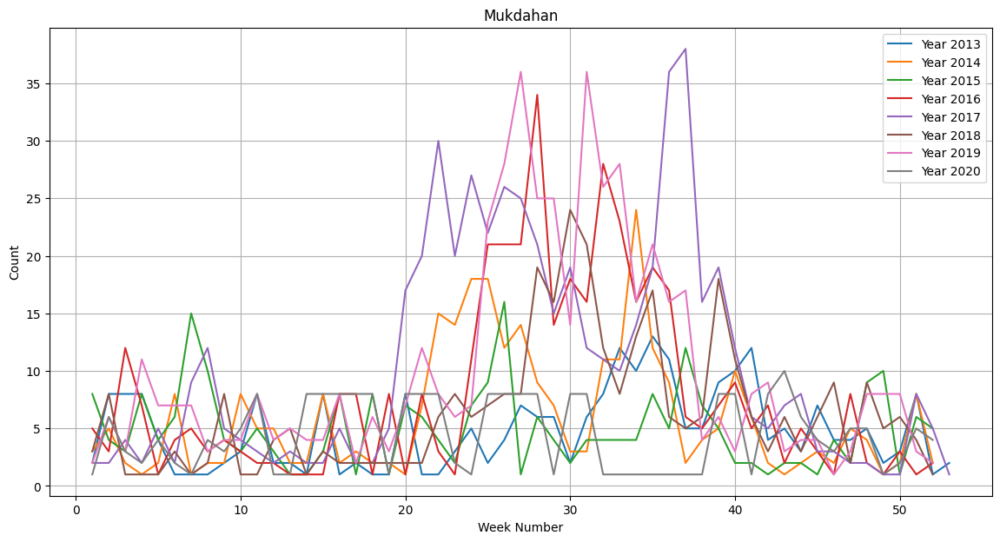


RMSE: 1.055630406826392


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,XGBoost,-1.039629,-1.039629,-1.636001,root_mean_squared_error,0.023726,0.004187,0.261192,0.023726,0.004187,0.261192,1,True,8
1,LightGBMXT,-1.045653,-1.045653,-2.024993,root_mean_squared_error,0.044151,0.010661,0.739332,0.044151,0.010661,0.739332,1,True,3
2,WeightedEnsemble_L2,-1.055630,-1.055630,-1.198182,root_mean_squared_error,0.085180,0.024902,3.520099,0.009758,0.000813,0.024487,2,True,11
3,RandomForestMSE,-1.147825,-1.147825,-1.967081,root_mean_squared_error,0.077239,0.078165,0.698880,0.077239,0.078165,0.698880,1,True,5
4,ExtraTreesMSE,-1.177099,-1.177099,-2.184759,root_mean_squared_error,0.084353,0.076973,0.604746,0.084353,0.076973,0.604746,1,True,6
5,LightGBM,-1.185355,-1.185355,-1.736828,root_mean_squared_error,0.017866,0.003619,0.508572,0.017866,0.003619,0.508572,1,True,4
6,NeuralNetTorch,-1.356796,-1.356796,-1.438485,root_mean_squared_error,0.014726,0.007752,2.079493,0.014726,0.007752,2.079493,1,True,9
7,LightGBMLarge,-1.397555,-1.397555,-1.820441,root_mean_squared_error,0.106348,0.025338,1.200034,0.106348,0.025338,1.200034,1,True,10
8,NeuralNetFastAI,-2.055203,-2.055203,-1.751662,root_mean_squared_error,0.019104,0.008531,0.646356,0.019104,0.008531,0.646356,1,True,7
9,KNeighborsDist,-3.216759,-3.216759,-3.042889,root_mean_squared_error,0.014166,0.013552,0.007416,0.014166,0.013552,0.007416,1,True,2


In [43]:
province = "Mukdahan"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Mukdahan = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Mukdahan.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Mukdahan.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Chiang Mai

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192236"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.61 GB / 12.67 GB (83.7%)
Disk Space Avail:   75.78 GB / 107.72 GB (70.3%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

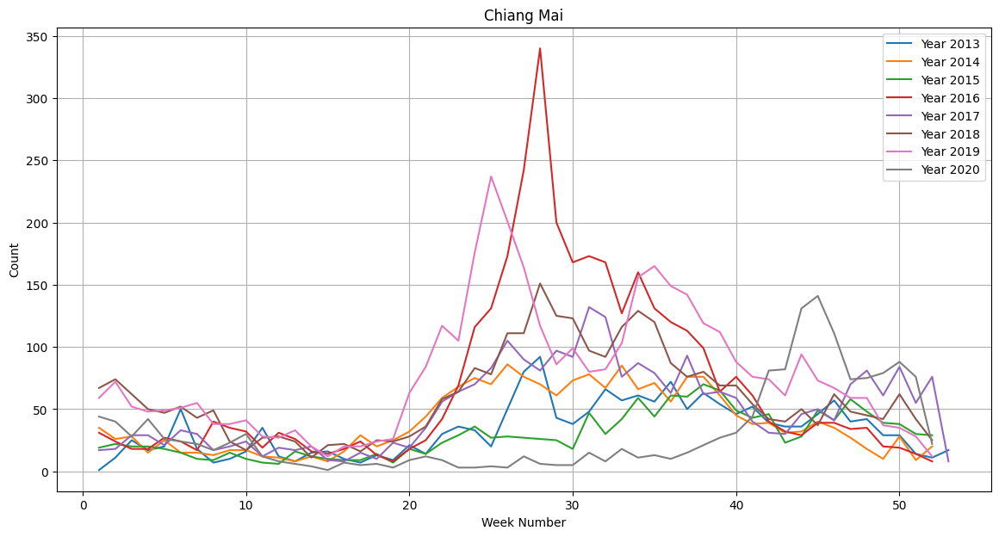


RMSE: 10.771599815300954


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-10.771600,-10.771600,-7.224863,root_mean_squared_error,0.034487,0.018720,3.723106,0.003195,0.000544,0.015917,2,True,11
1,NeuralNetTorch,-11.014677,-11.014677,-7.329051,root_mean_squared_error,0.016679,0.009798,3.063442,0.016679,0.009798,3.063442,1,True,9
2,ExtraTreesMSE,-11.565224,-11.565224,-10.786827,root_mean_squared_error,0.091899,0.077581,0.610797,0.091899,0.077581,0.610797,1,True,6
3,LightGBMLarge,-11.855328,-11.855328,-13.219319,root_mean_squared_error,0.011092,0.003014,0.616225,0.011092,0.003014,0.616225,1,True,10
4,RandomForestMSE,-12.517123,-12.517123,-12.251003,root_mean_squared_error,0.091465,0.076691,0.958764,0.091465,0.076691,0.958764,1,True,5
5,XGBoost,-13.597391,-13.597391,-12.936826,root_mean_squared_error,0.015232,0.003734,0.362482,0.015232,0.003734,0.362482,1,True,8
6,LightGBM,-13.981104,-13.981104,-12.627306,root_mean_squared_error,0.002524,0.002300,0.442957,0.002524,0.002300,0.442957,1,True,4
7,KNeighborsDist,-14.759184,-14.759184,-12.829835,root_mean_squared_error,0.013991,0.015830,0.013297,0.013991,0.015830,0.013297,1,True,2
8,KNeighborsUnif,-14.810106,-14.810106,-12.973070,root_mean_squared_error,0.014998,0.026968,0.007361,0.014998,0.026968,0.007361,1,True,1
9,NeuralNetFastAI,-15.403775,-15.403775,-9.266987,root_mean_squared_error,0.014612,0.008379,0.643747,0.014612,0.008379,0.643747,1,True,7


In [44]:
province = "Chiang Mai"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Chiang_Mai = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Chiang_Mai.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Chiang_Mai.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Lamphun

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192245"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.65 GB / 12.67 GB (84.0%)
Disk Space Avail:   75.76 GB / 107.72 GB (70.3%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 3.40233
[2000]	valid_set's rmse: 3.36265


	-3.36	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-3.2471	 = Validation score   (-root_mean_squared_error)
	0.3s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.9578	 = Validation score   (-root_mean_squared_error)
	0.62s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.1578	 = Validation score   (-root_mean_squared_error)
	0.77s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.311	 = Validation score   (-root_mean_squared_error)
	0.91s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-3.0564	 = Validation score   (-root_mean_squared_error)
	0.41s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.0346	 = Validation score   (-root_mean_squared_error)
	2.48s	 = Training   runtime

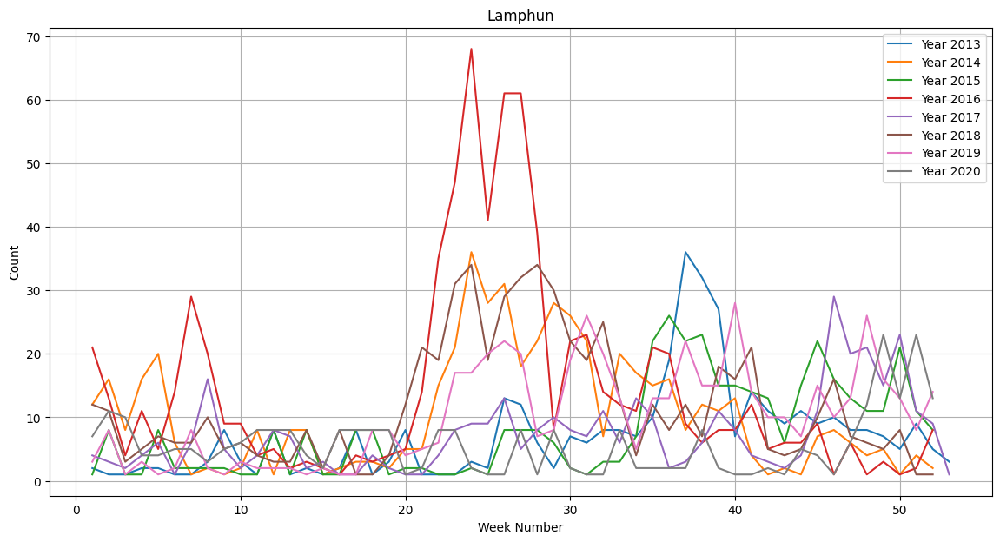


RMSE: 2.4581773171597314


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,ExtraTreesMSE,-2.158064,-2.158064,-3.157838,root_mean_squared_error,0.090489,0.068802,0.772304,0.090489,0.068802,0.772304,1,True,6
1,XGBoost,-2.163941,-2.163941,-3.056362,root_mean_squared_error,0.015058,0.005444,0.414709,0.015058,0.005444,0.414709,1,True,8
2,RandomForestMSE,-2.218110,-2.218110,-2.957824,root_mean_squared_error,0.081188,0.076099,0.617920,0.081188,0.076099,0.617920,1,True,5
3,LightGBM,-2.265910,-2.265910,-3.247140,root_mean_squared_error,0.004799,0.001420,0.302365,0.004799,0.001420,0.302365,1,True,4
4,LightGBMXT,-2.392885,-2.392885,-3.360010,root_mean_squared_error,0.024123,0.011627,0.644611,0.024123,0.011627,0.644611,1,True,3
5,WeightedEnsemble_L2,-2.458177,-2.458177,-1.891582,root_mean_squared_error,0.043646,0.026840,3.818863,0.003268,0.000536,0.015590,2,True,11
6,LightGBMLarge,-2.469645,-2.469645,-3.201345,root_mean_squared_error,0.010648,0.002094,0.442195,0.010648,0.002094,0.442195,1,True,10
7,NeuralNetTorch,-2.644653,-2.644653,-2.034556,root_mean_squared_error,0.010523,0.009237,2.478105,0.010523,0.009237,2.478105,1,True,9
8,NeuralNetFastAI,-2.776238,-2.776238,-2.310959,root_mean_squared_error,0.014798,0.011623,0.910460,0.014798,0.011623,0.910460,1,True,7
9,KNeighborsDist,-4.412186,-4.412186,-5.163998,root_mean_squared_error,0.014476,0.014232,0.012857,0.014476,0.014232,0.012857,1,True,2


In [45]:
province = "Lamphun"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Lamphun = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Lamphun.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Lamphun.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Lampang

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192253"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.74 GB / 107.72 GB (70.3%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 6.31043
[2000]	valid_set's rmse: 5.80663


	-5.7842	 = Validation score   (-root_mean_squared_error)
	0.67s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-6.357	 = Validation score   (-root_mean_squared_error)
	0.33s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-5.6301	 = Validation score   (-root_mean_squared_error)
	0.67s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-5.7722	 = Validation score   (-root_mean_squared_error)
	0.6s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-5.0088	 = Validation score   (-root_mean_squared_error)
	0.78s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-5.0021	 = Validation score   (-root_mean_squared_error)
	0.42s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-4.0813	 = Validation score   (-root_mean_squared_error)
	2.1s	 = Training   runtim

[1000]	valid_set's rmse: 6.2688
[2000]	valid_set's rmse: 6.23328
[3000]	valid_set's rmse: 6.21248
[4000]	valid_set's rmse: 6.20461
[5000]	valid_set's rmse: 6.20207
[6000]	valid_set's rmse: 6.20078
[7000]	valid_set's rmse: 6.20027
[8000]	valid_set's rmse: 6.20003
[9000]	valid_set's rmse: 6.19994
[10000]	valid_set's rmse: 6.1999


	-6.1999	 = Validation score   (-root_mean_squared_error)
	8.08s	 = Training   runtime
	0.21s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.81, 'XGBoost': 0.19}
	-4.0177	 = Validation score   (-root_mean_squared_error)
	0.02s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 16.87s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 4704.2 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192253")


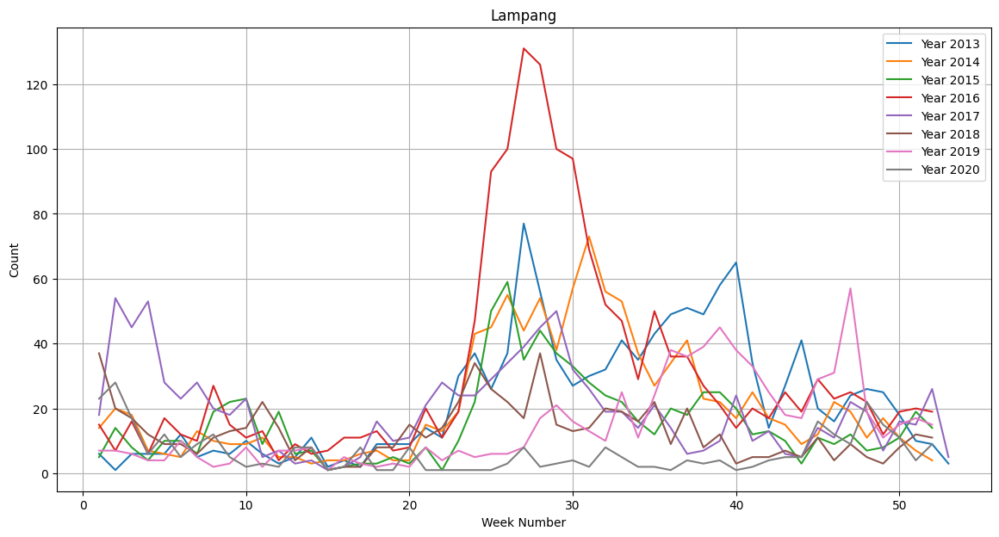


RMSE: 5.206284340428799


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,LightGBMLarge,-4.782602,-4.782602,-6.199897,root_mean_squared_error,0.758494,0.208766,8.075519,0.758494,0.208766,8.075519,1,True,10
1,ExtraTreesMSE,-4.888975,-4.888975,-5.772159,root_mean_squared_error,0.108132,0.080992,0.602797,0.108132,0.080992,0.602797,1,True,6
2,XGBoost,-4.911273,-4.911273,-5.002109,root_mean_squared_error,0.028939,0.005737,0.415652,0.028939,0.005737,0.415652,1,True,8
3,RandomForestMSE,-5.047072,-5.047072,-5.630074,root_mean_squared_error,0.095037,0.070675,0.674212,0.095037,0.070675,0.674212,1,True,5
4,LightGBM,-5.181749,-5.181749,-6.356955,root_mean_squared_error,0.007630,0.001742,0.328412,0.007630,0.001742,0.328412,1,True,4
5,WeightedEnsemble_L2,-5.206284,-5.206284,-4.017671,root_mean_squared_error,0.068742,0.015731,2.532497,0.026568,0.000718,0.017764,2,True,11
6,NeuralNetTorch,-5.375509,-5.375509,-4.081264,root_mean_squared_error,0.013234,0.009276,2.099080,0.013234,0.009276,2.099080,1,True,9
7,LightGBMXT,-5.742454,-5.742454,-5.784153,root_mean_squared_error,0.033419,0.013992,0.672694,0.033419,0.013992,0.672694,1,True,3
8,KNeighborsUnif,-5.869019,-5.869019,-8.724925,root_mean_squared_error,0.016200,0.013890,0.019696,0.016200,0.013890,0.019696,1,True,1
9,KNeighborsDist,-5.894557,-5.894557,-8.636772,root_mean_squared_error,0.015188,0.013543,0.007582,0.015188,0.013543,0.007582,1,True,2


In [46]:
province = "Lampang"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Lampang = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Lampang.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Lampang.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Uttaradit

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192312"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.8%)
Disk Space Avail:   75.68 GB / 107.72 GB (70.3%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.50835


	-2.6496	 = Validation score   (-root_mean_squared_error)
	0.45s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.2633	 = Validation score   (-root_mean_squared_error)
	0.72s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.447	 = Validation score   (-root_mean_squared_error)
	0.79s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.8496	 = Validation score   (-root_mean_squared_error)
	0.89s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.0649	 = Validation score   (-root_mean_squared_error)
	0.44s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.6019	 = Validation score   (-root_mean_squared_error)
	4.43s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-2.6979	 = Validation score   (-root_mean_squared_error)
	0.67s	 = Training  

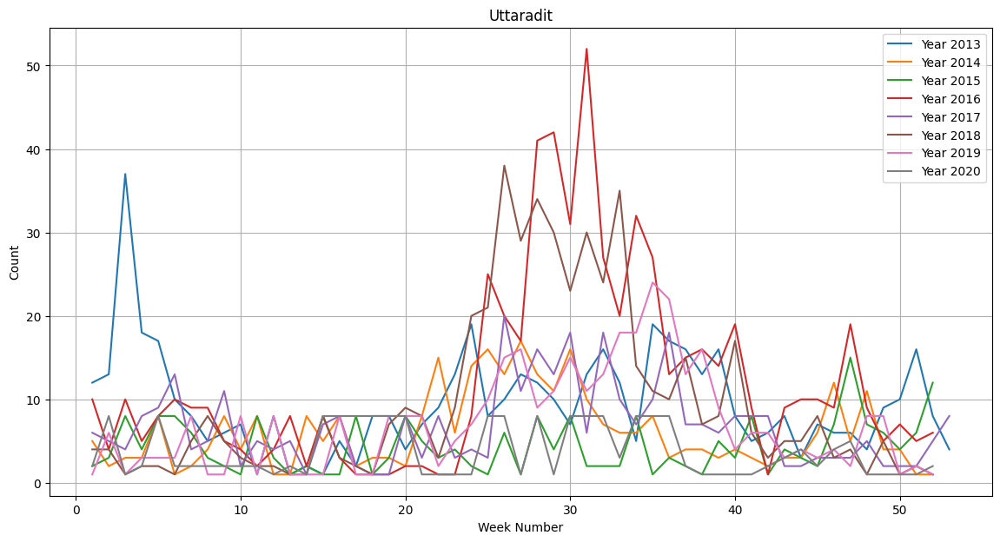


RMSE: 0.8943704622286672


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-0.894370,-0.894370,-1.371016,root_mean_squared_error,0.046928,0.028360,5.781274,0.003808,0.000630,0.022218,2,True,11
1,ExtraTreesMSE,-1.125146,-1.125146,-2.447042,root_mean_squared_error,0.081389,0.066454,0.790879,0.081389,0.066454,0.790879,1,True,6
2,LightGBMXT,-1.132749,-1.132749,-2.433455,root_mean_squared_error,0.020500,0.007788,0.637559,0.020500,0.007788,0.637559,1,True,3
3,LightGBMLarge,-1.139694,-1.139694,-2.697894,root_mean_squared_error,0.016097,0.004134,0.672346,0.016097,0.004134,0.672346,1,True,10
4,LightGBM,-1.317828,-1.317828,-2.649572,root_mean_squared_error,0.004417,0.001733,0.445721,0.004417,0.001733,0.445721,1,True,4
5,NeuralNetTorch,-1.359236,-1.359236,-1.601950,root_mean_squared_error,0.011030,0.011120,4.430034,0.011030,0.011120,4.430034,1,True,9
6,RandomForestMSE,-1.452901,-1.452901,-2.263320,root_mean_squared_error,0.077544,0.069150,0.718230,0.077544,0.069150,0.718230,1,True,5
7,NeuralNetFastAI,-1.690155,-1.690155,-1.849577,root_mean_squared_error,0.015296,0.010197,0.893611,0.015296,0.010197,0.893611,1,True,7
8,XGBoost,-1.788760,-1.788760,-2.064923,root_mean_squared_error,0.016794,0.006413,0.435411,0.016794,0.006413,0.435411,1,True,8
9,KNeighborsDist,-2.801150,-2.801150,-3.732914,root_mean_squared_error,0.013735,0.015496,0.012419,0.013735,0.015496,0.012419,1,True,2


In [47]:
province = "Uttaradit"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Uttaradit = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Uttaradit.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Uttaradit.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Phrae

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192323"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.62 GB / 12.67 GB (83.8%)
Disk Space Avail:   75.67 GB / 107.72 GB (70.2%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.74337
[2000]	valid_set's rmse: 2.69528


	-1.6889	 = Validation score   (-root_mean_squared_error)
	0.3s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-1.9344	 = Validation score   (-root_mean_squared_error)
	0.83s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-1.7468	 = Validation score   (-root_mean_squared_error)
	0.75s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.2307	 = Validation score   (-root_mean_squared_error)
	0.62s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.1231	 = Validation score   (-root_mean_squared_error)
	0.3s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.3347	 = Validation score   (-root_mean_squared_error)
	3.43s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-1.7734	 = Validation score   (-root_mean_squared_error)
	1.07s	 = Training   

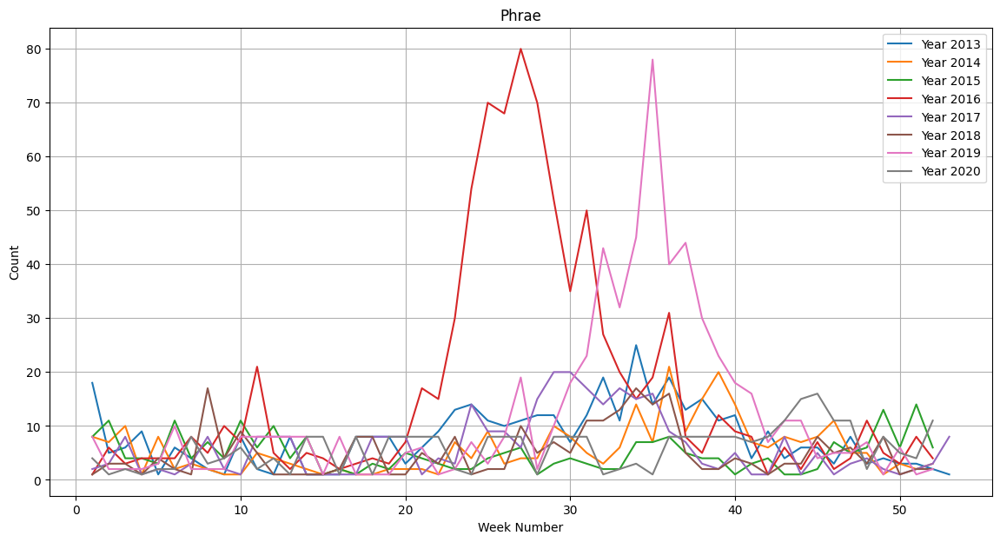


RMSE: 1.174548511164456


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-1.174549,-1.174549,-1.143698,root_mean_squared_error,0.095945,0.042300,6.010054,0.006438,0.000540,0.015236,2,True,11
1,LightGBMXT,-1.538225,-1.538225,-2.607233,root_mean_squared_error,0.022564,0.008158,0.569048,0.022564,0.008158,0.569048,1,True,3
2,NeuralNetTorch,-1.548691,-1.548691,-1.334654,root_mean_squared_error,0.011020,0.013076,3.428730,0.011020,0.013076,3.428730,1,True,9
3,LightGBM,-1.573411,-1.573411,-1.688859,root_mean_squared_error,0.004567,0.001946,0.300860,0.004567,0.001946,0.300860,1,True,4
4,ExtraTreesMSE,-1.787879,-1.787879,-1.746848,root_mean_squared_error,0.082371,0.076251,0.749500,0.082371,0.076251,0.749500,1,True,6
5,LightGBMLarge,-1.876027,-1.876027,-1.773420,root_mean_squared_error,0.031912,0.010927,1.071966,0.031912,0.010927,1.071966,1,True,10
6,RandomForestMSE,-1.907291,-1.907291,-1.934363,root_mean_squared_error,0.068521,0.078564,0.829449,0.068521,0.078564,0.829449,1,True,5
7,NeuralNetFastAI,-2.194692,-2.194692,-2.230711,root_mean_squared_error,0.019444,0.007652,0.624214,0.019444,0.007652,0.624214,1,True,7
8,XGBoost,-2.798827,-2.798827,-2.123145,root_mean_squared_error,0.017674,0.005128,0.296526,0.017674,0.005128,0.296526,1,True,8
9,KNeighborsUnif,-3.470203,-3.470203,-2.789362,root_mean_squared_error,0.014222,0.021684,0.015512,0.014222,0.021684,0.015512,1,True,1


In [48]:
province = "Phrae"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Phrae = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Phrae.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Phrae.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Nan

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192333"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.61 GB / 12.67 GB (83.7%)
Disk Space Avail:   75.65 GB / 107.72 GB (70.2%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 3.94282
[2000]	valid_set's rmse: 3.82573


	-3.7756	 = Validation score   (-root_mean_squared_error)
	0.74s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-3.825	 = Validation score   (-root_mean_squared_error)
	0.34s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.6447	 = Validation score   (-root_mean_squared_error)
	0.67s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.7392	 = Validation score   (-root_mean_squared_error)
	0.78s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-3.6522	 = Validation score   (-root_mean_squared_error)
	0.75s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: XGBoost ...
	-2.9628	 = Validation score   (-root_mean_squared_error)
	0.41s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.1152	 = Validation score   (-root_mean_squared_error)
	3.61s	 = Training   runt

[1000]	valid_set's rmse: 3.33269
[2000]	valid_set's rmse: 3.31933
[3000]	valid_set's rmse: 3.31356
[4000]	valid_set's rmse: 3.31344


	-3.313	 = Validation score   (-root_mean_squared_error)
	3.95s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.714, 'LightGBM': 0.143, 'NeuralNetFastAI': 0.071, 'XGBoost': 0.071}
	-1.9594	 = Validation score   (-root_mean_squared_error)
	0.02s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 13.03s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 2238.2 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192333")


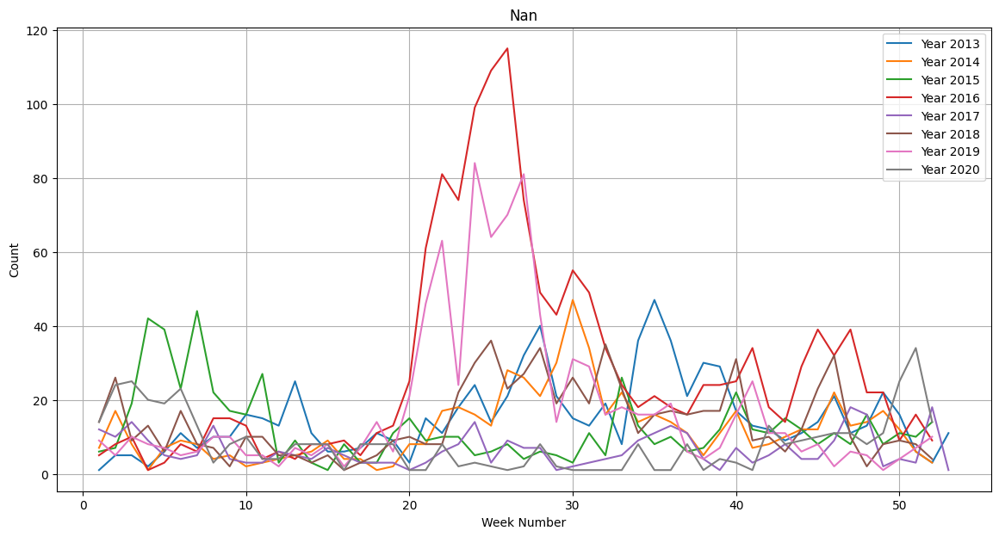


RMSE: 4.290140908527044


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-4.290141,-4.290141,-1.959412,root_mean_squared_error,0.066513,0.033063,5.128997,0.007503,0.000522,0.015681,2,True,11
1,XGBoost,-4.371651,-4.371651,-2.962761,root_mean_squared_error,0.022667,0.006278,0.409210,0.022667,0.006278,0.409210,1,True,8
2,RandomForestMSE,-4.466630,-4.466630,-3.644746,root_mean_squared_error,0.091127,0.076832,0.665197,0.091127,0.076832,0.665197,1,True,5
3,ExtraTreesMSE,-4.478986,-4.478986,-3.739214,root_mean_squared_error,0.081080,0.076224,0.780523,0.081080,0.076224,0.780523,1,True,6
4,NeuralNetTorch,-4.608624,-4.608624,-2.115232,root_mean_squared_error,0.011749,0.008711,3.612670,0.011749,0.008711,3.612670,1,True,9
5,LightGBMXT,-4.734497,-4.734497,-3.775596,root_mean_squared_error,0.030333,0.011140,0.739254,0.030333,0.011140,0.739254,1,True,3
6,LightGBM,-5.003088,-5.003088,-3.825004,root_mean_squared_error,0.009456,0.002479,0.339981,0.009456,0.002479,0.339981,1,True,4
7,LightGBMLarge,-5.367438,-5.367438,-3.313035,root_mean_squared_error,0.180552,0.064263,3.953855,0.180552,0.064263,3.953855,1,True,10
8,KNeighborsDist,-5.494681,-5.494681,-5.612244,root_mean_squared_error,0.013952,0.014557,0.011406,0.013952,0.014557,0.011406,1,True,2
9,KNeighborsUnif,-5.855832,-5.855832,-5.650114,root_mean_squared_error,0.014240,0.023936,0.018243,0.014240,0.023936,0.018243,1,True,1


In [49]:
province = "Nan"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Nan = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Nan.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Nan.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Phayao

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192347"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.62 GB / 107.72 GB (70.2%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 4.25871
[2000]	valid_set's rmse: 4.03796
[3000]	valid_set's rmse: 3.92157


	-3.9094	 = Validation score   (-root_mean_squared_error)
	0.82s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-3.9156	 = Validation score   (-root_mean_squared_error)
	0.41s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.7995	 = Validation score   (-root_mean_squared_error)
	1.08s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.3515	 = Validation score   (-root_mean_squared_error)
	0.9s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.9768	 = Validation score   (-root_mean_squared_error)
	0.91s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-4.0202	 = Validation score   (-root_mean_squared_error)
	0.35s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.9175	 = Validation score   (-root_mean_squared_error)
	1.84s	 = Training   runt

[1000]	valid_set's rmse: 4.04648


	-4.0416	 = Validation score   (-root_mean_squared_error)
	1.23s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.52, 'NeuralNetFastAI': 0.48}
	-2.4918	 = Validation score   (-root_mean_squared_error)
	0.02s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 8.98s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 4159.7 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192347")


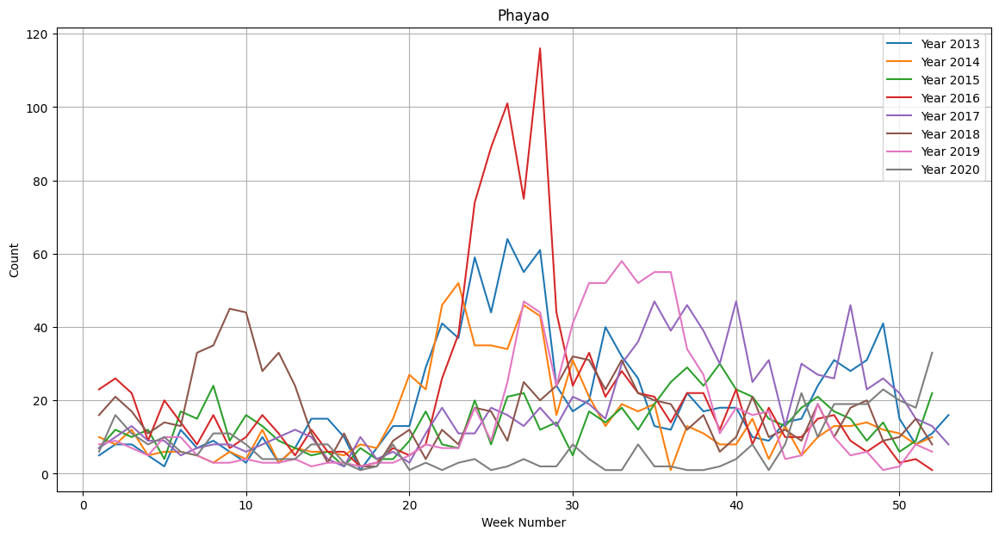


RMSE: 3.333670187311755


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,XGBoost,-2.536795,-2.536795,-4.020224,root_mean_squared_error,0.030876,0.007849,0.354826,0.030876,0.007849,0.354826,1,True,8
1,ExtraTreesMSE,-2.832591,-2.832591,-3.351532,root_mean_squared_error,0.081401,0.076926,0.896163,0.081401,0.076926,0.896163,1,True,6
2,LightGBMXT,-2.880122,-2.880122,-3.909422,root_mean_squared_error,0.071889,0.015520,0.817595,0.071889,0.015520,0.817595,1,True,3
3,RandomForestMSE,-3.068417,-3.068417,-3.799506,root_mean_squared_error,0.077600,0.060073,1.080462,0.077600,0.060073,1.080462,1,True,5
4,LightGBMLarge,-3.107846,-3.107846,-4.041571,root_mean_squared_error,0.089872,0.022339,1.228754,0.089872,0.022339,1.228754,1,True,10
5,LightGBM,-3.140178,-3.140178,-3.915557,root_mean_squared_error,0.023700,0.003678,0.409822,0.023700,0.003678,0.409822,1,True,4
6,NeuralNetTorch,-3.226197,-3.226197,-2.917530,root_mean_squared_error,0.014976,0.009492,1.835429,0.014976,0.009492,1.835429,1,True,9
7,WeightedEnsemble_L2,-3.333670,-3.333670,-2.491766,root_mean_squared_error,0.040920,0.017790,2.767688,0.006812,0.000710,0.022099,2,True,11
8,NeuralNetFastAI,-3.960879,-3.960879,-2.976788,root_mean_squared_error,0.019132,0.007588,0.910159,0.019132,0.007588,0.910159,1,True,7
9,KNeighborsDist,-5.285811,-5.285811,-5.202108,root_mean_squared_error,0.013875,0.014887,0.011173,0.013875,0.014887,0.011173,1,True,2


In [50]:
province = "Phayao"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Phayao = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Phayao.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Phayao.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Chiang Rai

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192357"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.60 GB / 12.67 GB (83.7%)
Disk Space Avail:   75.60 GB / 107.72 GB (70.2%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 11.0691
[2000]	valid_set's rmse: 9.9483
[3000]	valid_set's rmse: 9.28653
[4000]	valid_set's rmse: 8.8165
[5000]	valid_set's rmse: 8.59494
[6000]	valid_set's rmse: 8.44169
[7000]	valid_set's rmse: 8.37617
[8000]	valid_set's rmse: 8.27937
[9000]	valid_set's rmse: 8.24852
[10000]	valid_set's rmse: 8.26929


	-8.2327	 = Validation score   (-root_mean_squared_error)
	2.43s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: LightGBM ...
	-10.0132	 = Validation score   (-root_mean_squared_error)
	0.42s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-9.5948	 = Validation score   (-root_mean_squared_error)
	0.76s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-9.2106	 = Validation score   (-root_mean_squared_error)
	0.79s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-8.3677	 = Validation score   (-root_mean_squared_error)
	0.78s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-9.3272	 = Validation score   (-root_mean_squared_error)
	0.5s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-8.5315	 = Validation score   (-root_mean_squared_error)
	1.57s	 = Training   run

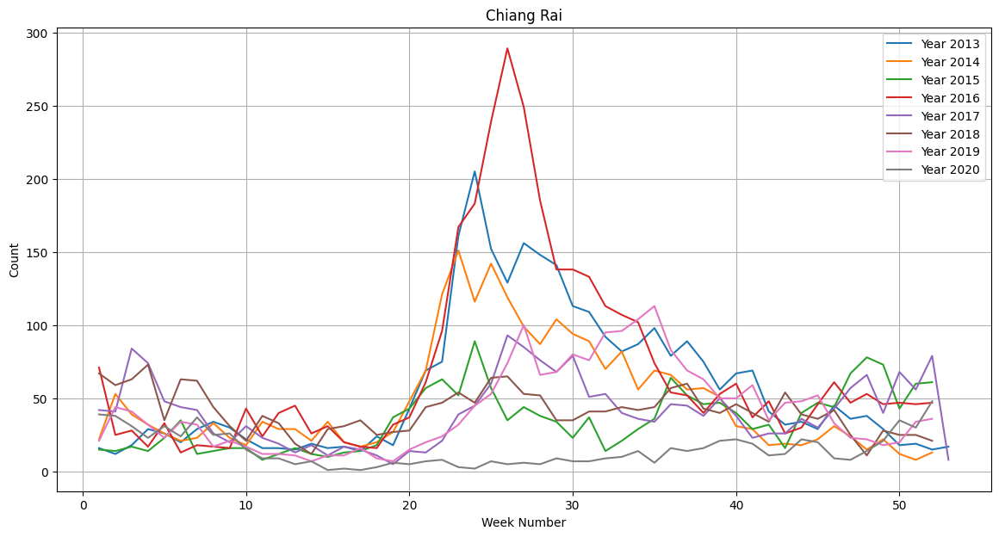


RMSE: 9.298064047216055


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,LightGBMLarge,-7.914798,-7.914798,-8.674594,root_mean_squared_error,0.019294,0.004651,0.718064,0.019294,0.004651,0.718064,1,True,10
1,ExtraTreesMSE,-7.919179,-7.919179,-9.210634,root_mean_squared_error,0.090977,0.088739,0.792623,0.090977,0.088739,0.792623,1,True,6
2,NeuralNetTorch,-8.113487,-8.113487,-8.531518,root_mean_squared_error,0.014655,0.012990,1.572394,0.014655,0.012990,1.572394,1,True,9
3,RandomForestMSE,-8.196561,-8.196561,-9.594788,root_mean_squared_error,0.080509,0.087381,0.761400,0.080509,0.087381,0.761400,1,True,5
4,XGBoost,-8.297092,-8.297092,-9.327161,root_mean_squared_error,0.022173,0.006156,0.504799,0.022173,0.006156,0.504799,1,True,8
5,KNeighborsDist,-9.043829,-9.043829,-10.467182,root_mean_squared_error,0.013978,0.019734,0.011422,0.013978,0.019734,0.011422,1,True,2
6,KNeighborsUnif,-9.127684,-9.127684,-10.200663,root_mean_squared_error,0.014392,0.019992,0.019992,0.014392,0.019992,0.019992,1,True,1
7,LightGBM,-9.281428,-9.281428,-10.013181,root_mean_squared_error,0.011012,0.001307,0.423449,0.011012,0.001307,0.423449,1,True,4
8,WeightedEnsemble_L2,-9.298064,-9.298064,-6.513075,root_mean_squared_error,0.193027,0.099141,5.517268,0.004267,0.000563,0.015698,2,True,11
9,LightGBMXT,-9.466333,-9.466333,-8.232689,root_mean_squared_error,0.136680,0.070383,2.426943,0.136680,0.070383,2.426943,1,True,3


In [51]:
province = "Chiang Rai"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Chiang_Rai = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Chiang_Rai.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Chiang_Rai.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Mae Hong Son

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192408"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.64 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.57 GB / 107.72 GB (70.2%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.3504
[2000]	valid_set's rmse: 2.26737
[3000]	valid_set's rmse: 2.24959


	-2.2386	 = Validation score   (-root_mean_squared_error)
	0.82s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-2.3065	 = Validation score   (-root_mean_squared_error)
	0.45s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.9873	 = Validation score   (-root_mean_squared_error)
	1.08s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.8449	 = Validation score   (-root_mean_squared_error)
	0.97s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.0211	 = Validation score   (-root_mean_squared_error)
	0.78s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.4535	 = Validation score   (-root_mean_squared_error)
	0.32s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.0859	 = Validation score   (-root_mean_squared_error)
	1.51s	 = Training   run

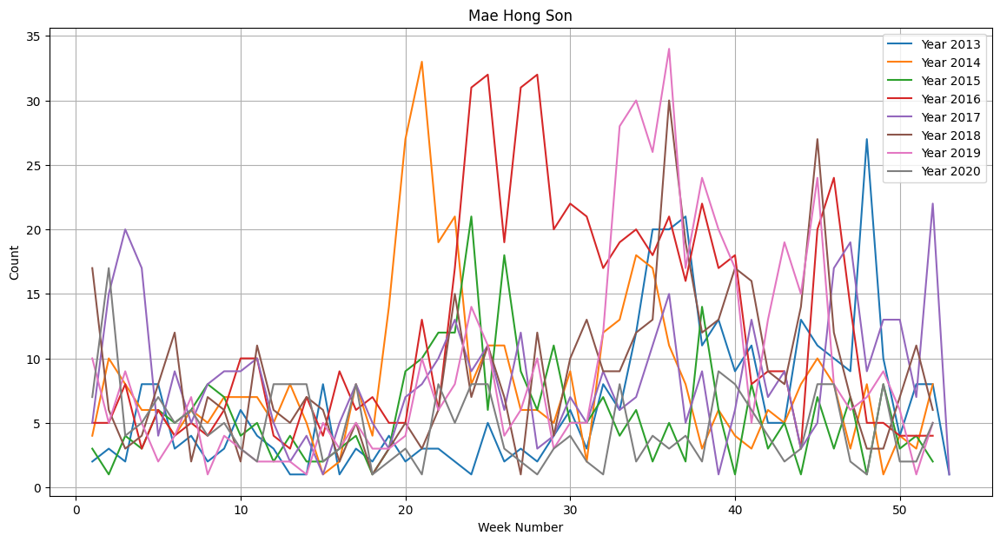


RMSE: 2.6439388895959


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,LightGBM,-2.410432,-2.410432,-2.306548,root_mean_squared_error,0.007169,0.002343,0.446914,0.007169,0.002343,0.446914,1,True,4
1,LightGBMXT,-2.603062,-2.603062,-2.238578,root_mean_squared_error,0.038396,0.013722,0.824587,0.038396,0.013722,0.824587,1,True,3
2,XGBoost,-2.618730,-2.618730,-2.453452,root_mean_squared_error,0.020688,0.006867,0.317215,0.020688,0.006867,0.317215,1,True,8
3,WeightedEnsemble_L2,-2.643939,-2.643939,-1.809148,root_mean_squared_error,0.075147,0.032024,3.130885,0.005736,0.000785,0.018876,2,True,11
4,LightGBMLarge,-2.668494,-2.668494,-2.815549,root_mean_squared_error,0.025458,0.005641,0.730283,0.025458,0.005641,0.730283,1,True,10
5,RandomForestMSE,-2.672851,-2.672851,-2.987292,root_mean_squared_error,0.091444,0.072611,1.077489,0.091444,0.072611,1.077489,1,True,5
6,NeuralNetTorch,-2.693183,-2.693183,-2.085950,root_mean_squared_error,0.014384,0.009977,1.509064,0.014384,0.009977,1.509064,1,True,9
7,ExtraTreesMSE,-2.717662,-2.717662,-2.844863,root_mean_squared_error,0.081740,0.089654,0.967499,0.081740,0.089654,0.967499,1,True,6
8,NeuralNetFastAI,-2.971537,-2.971537,-2.021116,root_mean_squared_error,0.016631,0.007540,0.778359,0.016631,0.007540,0.778359,1,True,7
9,KNeighborsUnif,-3.813841,-3.813841,-4.274437,root_mean_squared_error,0.014228,0.029275,0.007989,0.014228,0.029275,0.007989,1,True,1


In [52]:
province = "Mae Hong Son"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Mae_Hong_Son = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Mae_Hong_Son.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Mae_Hong_Son.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Nakhon Sawan

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192416"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.64 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.55 GB / 107.72 GB (70.1%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

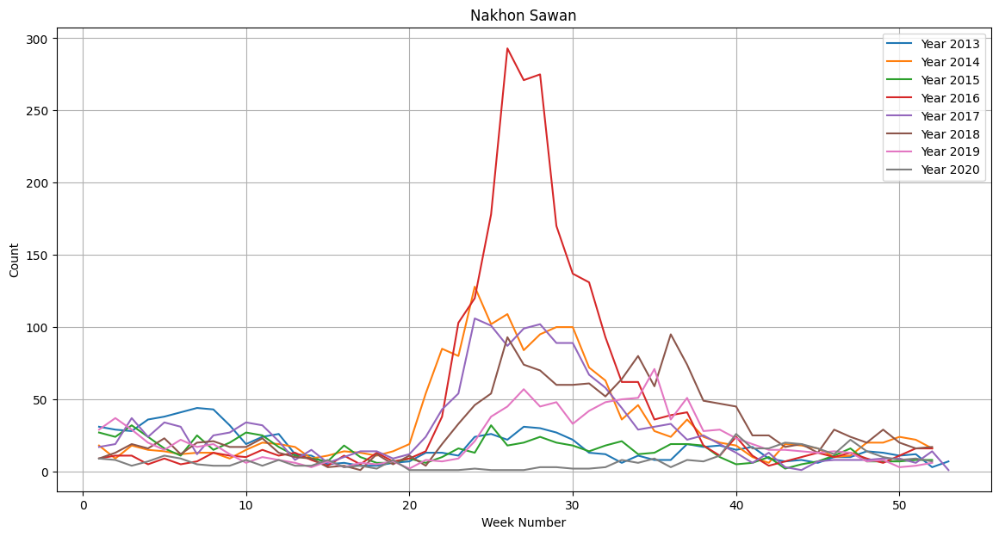


RMSE: 1.9683477321530436


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-1.968348,-1.968348,-5.505075,root_mean_squared_error,0.056008,0.017243,3.416358,0.003988,0.000781,0.023954,2,True,11
1,NeuralNetTorch,-2.588420,-2.588420,-5.625377,root_mean_squared_error,0.016134,0.011096,2.983553,0.016134,0.011096,2.983553,1,True,9
2,KNeighborsUnif,-4.173082,-4.173082,-9.640736,root_mean_squared_error,0.016065,0.020286,0.017115,0.016065,0.020286,0.017115,1,True,1
3,KNeighborsDist,-4.264497,-4.264497,-9.543289,root_mean_squared_error,0.015467,0.013382,0.006409,0.015467,0.013382,0.006409,1,True,2
4,LightGBM,-4.695106,-4.695106,-9.700095,root_mean_squared_error,0.004512,0.001291,0.340895,0.004512,0.001291,0.340895,1,True,4
5,ExtraTreesMSE,-5.150446,-5.150446,-6.487096,root_mean_squared_error,0.087646,0.077404,0.786230,0.087646,0.077404,0.786230,1,True,6
6,XGBoost,-5.329129,-5.329129,-6.738301,root_mean_squared_error,0.035886,0.005366,0.408851,0.035886,0.005366,0.408851,1,True,8
7,LightGBMXT,-6.097301,-6.097301,-10.469034,root_mean_squared_error,0.002823,0.000957,0.320899,0.002823,0.000957,0.320899,1,True,3
8,RandomForestMSE,-6.379189,-6.379189,-6.561455,root_mean_squared_error,0.099434,0.075957,0.694674,0.099434,0.075957,0.694674,1,True,5
9,LightGBMLarge,-6.704620,-6.704620,-7.588300,root_mean_squared_error,0.008893,0.002099,0.620898,0.008893,0.002099,0.620898,1,True,10


In [53]:
province = "Nakhon Sawan"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Nakhon_Sawan = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Nakhon_Sawan.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Nakhon_Sawan.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Uthai Thani

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192425"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.62 GB / 12.67 GB (83.8%)
Disk Space Avail:   75.54 GB / 107.72 GB (70.1%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 1.79361
[2000]	valid_set's rmse: 1.51044
[3000]	valid_set's rmse: 1.39227
[4000]	valid_set's rmse: 1.35015
[5000]	valid_set's rmse: 1.33792
[6000]	valid_set's rmse: 1.35178


	-1.3348	 = Validation score   (-root_mean_squared_error)
	1.19s	 = Training   runtime
	0.03s	 = Validation runtime
Fitting model: LightGBM ...
	-1.3968	 = Validation score   (-root_mean_squared_error)
	0.5s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.5331	 = Validation score   (-root_mean_squared_error)
	0.82s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.5106	 = Validation score   (-root_mean_squared_error)
	0.7s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.2206	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.4366	 = Validation score   (-root_mean_squared_error)
	0.31s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.8757	 = Validation score   (-root_mean_squared_error)
	2.53s	 = Training   runti

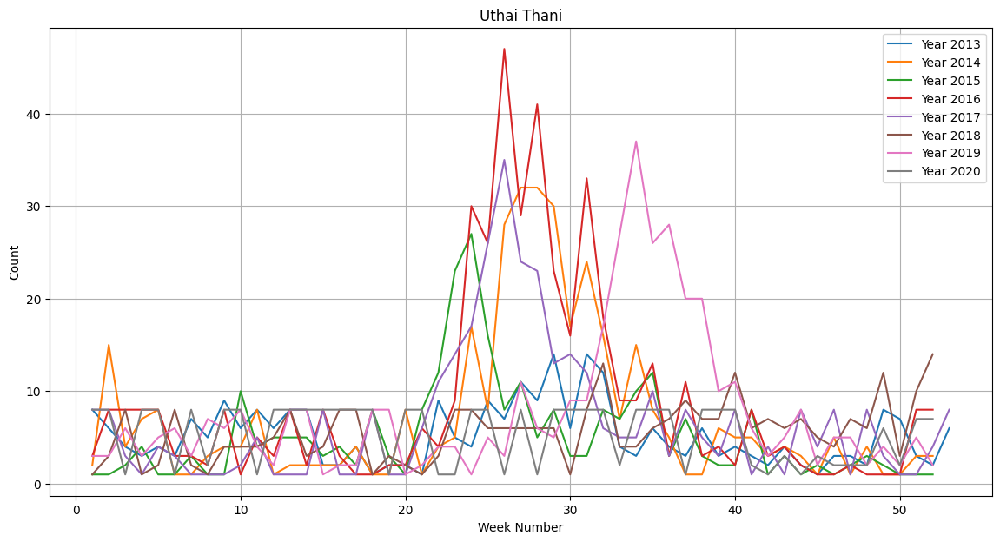


RMSE: 1.50217077621016


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,XGBoost,-0.983267,-0.983267,-2.436645,root_mean_squared_error,0.019833,0.005507,0.306919,0.019833,0.005507,0.306919,1,True,8
1,RandomForestMSE,-1.327727,-1.327727,-2.533065,root_mean_squared_error,0.089300,0.087369,0.817054,0.089300,0.087369,0.817054,1,True,5
2,ExtraTreesMSE,-1.338224,-1.338224,-2.510621,root_mean_squared_error,0.100058,0.077004,0.701072,0.100058,0.077004,0.701072,1,True,6
3,LightGBM,-1.445205,-1.445205,-1.396843,root_mean_squared_error,0.013536,0.003741,0.504242,0.013536,0.003741,0.504242,1,True,4
4,WeightedEnsemble_L2,-1.502171,-1.502171,-1.270031,root_mean_squared_error,0.109774,0.045558,4.885966,0.004203,0.000527,0.019312,2,True,11
5,LightGBMXT,-1.596164,-1.596164,-1.334809,root_mean_squared_error,0.064647,0.025322,1.190689,0.064647,0.025322,1.190689,1,True,3
6,LightGBMLarge,-1.724970,-1.724970,-2.364044,root_mean_squared_error,0.030071,0.007910,0.721172,0.030071,0.007910,0.721172,1,True,10
7,NeuralNetTorch,-1.909288,-1.909288,-1.875680,root_mean_squared_error,0.011654,0.008127,2.527665,0.011654,0.008127,2.527665,1,True,9
8,NeuralNetFastAI,-2.110746,-2.110746,-2.220648,root_mean_squared_error,0.015734,0.007841,0.644057,0.015734,0.007841,0.644057,1,True,7
9,KNeighborsDist,-3.407092,-3.407092,-3.633218,root_mean_squared_error,0.014116,0.013726,0.007929,0.014116,0.013726,0.007929,1,True,2


In [54]:
province = "Uthai Thani"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Uthai_Thani = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Uthai_Thani.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Uthai_Thani.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Kamphaeng Phet

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192435"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.52 GB / 107.72 GB (70.1%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

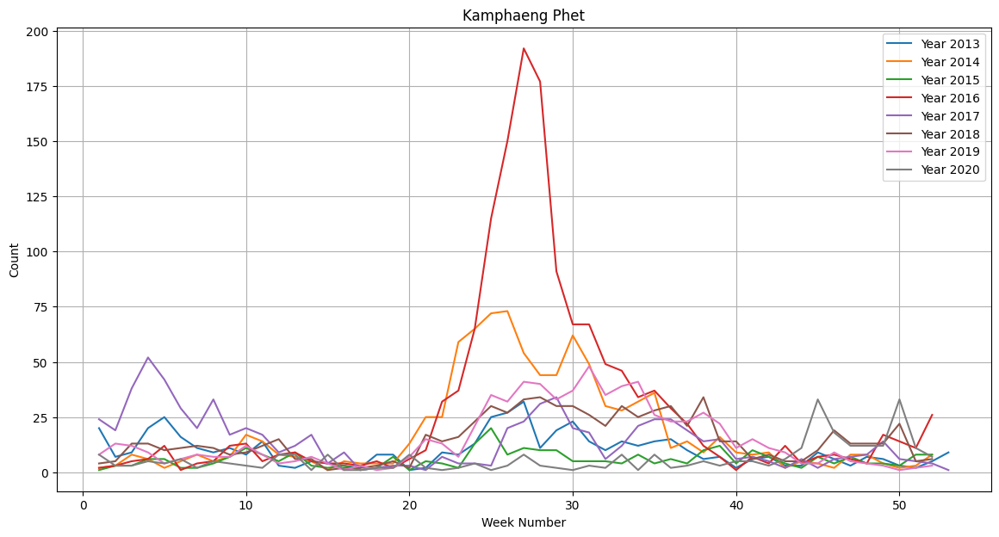


RMSE: 3.190883201217457


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-3.190883,-3.190883,-2.813824,root_mean_squared_error,0.128380,0.083544,4.928895,0.004762,0.000523,0.015390,2,True,11
1,RandomForestMSE,-3.350481,-3.350481,-3.942443,root_mean_squared_error,0.088557,0.066584,1.171370,0.088557,0.066584,1.171370,1,True,5
2,ExtraTreesMSE,-3.473485,-3.473485,-3.896312,root_mean_squared_error,0.095366,0.067974,0.947406,0.095366,0.067974,0.947406,1,True,6
3,NeuralNetTorch,-3.643245,-3.643245,-2.959160,root_mean_squared_error,0.017105,0.008176,3.123935,0.017105,0.008176,3.123935,1,True,9
4,XGBoost,-3.677016,-3.677016,-4.313095,root_mean_squared_error,0.030617,0.006335,0.395581,0.030617,0.006335,0.395581,1,True,8
5,LightGBMLarge,-3.677404,-3.677404,-3.977519,root_mean_squared_error,0.006968,0.001651,0.392215,0.006968,0.001651,0.392215,1,True,10
6,KNeighborsDist,-4.909349,-4.909349,-5.286598,root_mean_squared_error,0.013573,0.019661,0.007519,0.013573,0.019661,0.007519,1,True,2
7,LightGBM,-4.967518,-4.967518,-6.316273,root_mean_squared_error,0.001541,0.001814,0.577439,0.001541,0.001814,0.577439,1,True,4
8,KNeighborsUnif,-5.155057,-5.155057,-5.311996,root_mean_squared_error,0.014052,0.023537,0.007409,0.014052,0.023537,0.007409,1,True,1
9,LightGBMXT,-5.610775,-5.610775,-6.444826,root_mean_squared_error,0.002024,0.001764,0.384612,0.002024,0.001764,0.384612,1,True,3


In [55]:
province = "Kamphaeng Phet"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Kamphaeng_Phet = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Kamphaeng_Phet.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Kamphaeng_Phet.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Tak

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192445"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.8%)
Disk Space Avail:   75.51 GB / 107.72 GB (70.1%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.13886
[2000]	valid_set's rmse: 1.93562
[3000]	valid_set's rmse: 1.83906
[4000]	valid_set's rmse: 1.78959
[5000]	valid_set's rmse: 1.77599
[6000]	valid_set's rmse: 1.75981
[7000]	valid_set's rmse: 1.74881
[8000]	valid_set's rmse: 1.73249
[9000]	valid_set's rmse: 1.72845
[10000]	valid_set's rmse: 1.72638


	-1.7237	 = Validation score   (-root_mean_squared_error)
	1.75s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: LightGBM ...
	-1.7844	 = Validation score   (-root_mean_squared_error)
	0.44s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...


[1000]	valid_set's rmse: 1.79125


	-2.2321	 = Validation score   (-root_mean_squared_error)
	0.66s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.459	 = Validation score   (-root_mean_squared_error)
	0.68s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.8743	 = Validation score   (-root_mean_squared_error)
	0.89s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-1.6685	 = Validation score   (-root_mean_squared_error)
	0.43s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.5537	 = Validation score   (-root_mean_squared_error)
	3.64s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-2.2923	 = Validation score   (-root_mean_squared_error)
	0.6s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.389, 'XGBoost': 0.278, 'LightGBMXT'

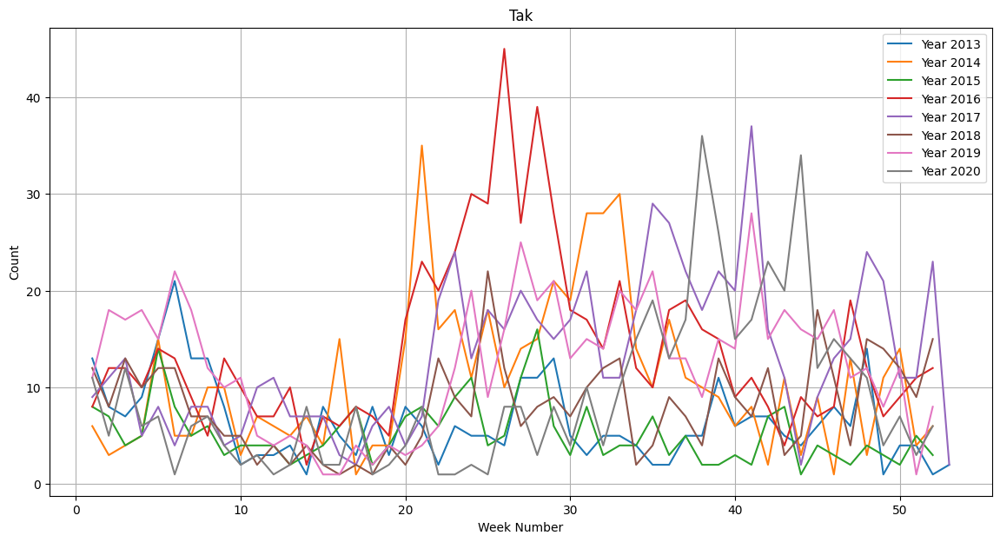


RMSE: 2.2848638240261017


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-2.284864,-2.284864,-1.225286,root_mean_squared_error,0.227523,0.092510,7.177268,0.005102,0.000640,0.020849,2,True,11
1,NeuralNetFastAI,-2.589020,-2.589020,-1.874335,root_mean_squared_error,0.017993,0.010993,0.891641,0.017993,0.010993,0.891641,1,True,7
2,NeuralNetTorch,-2.632751,-2.632751,-1.553723,root_mean_squared_error,0.014376,0.010613,3.641059,0.014376,0.010613,3.641059,1,True,9
3,LightGBM,-2.701882,-2.701882,-1.784391,root_mean_squared_error,0.030361,0.006169,0.444033,0.030361,0.006169,0.444033,1,True,4
4,LightGBMXT,-2.784654,-2.784654,-1.723707,root_mean_squared_error,0.137614,0.057058,1.745041,0.137614,0.057058,1.745041,1,True,3
5,XGBoost,-3.020563,-3.020563,-1.668518,root_mean_squared_error,0.022077,0.007038,0.434645,0.022077,0.007038,0.434645,1,True,8
6,ExtraTreesMSE,-3.096090,-3.096090,-2.458953,root_mean_squared_error,0.095755,0.067120,0.681517,0.095755,0.067120,0.681517,1,True,6
7,RandomForestMSE,-3.174892,-3.174892,-2.232133,root_mean_squared_error,0.104440,0.077309,0.662007,0.104440,0.077309,0.662007,1,True,5
8,LightGBMLarge,-3.307785,-3.307785,-2.292306,root_mean_squared_error,0.011885,0.003006,0.604134,0.011885,0.003006,0.604134,1,True,10
9,KNeighborsDist,-4.610225,-4.610225,-4.112578,root_mean_squared_error,0.015152,0.013983,0.007961,0.015152,0.013983,0.007961,1,True,2


In [56]:
province = "Tak"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Tak = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Tak.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Tak.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Sukhothai

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192457"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.62 GB / 12.67 GB (83.8%)
Disk Space Avail:   75.48 GB / 107.72 GB (70.1%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 5.47516
[2000]	valid_set's rmse: 5.06378
[3000]	valid_set's rmse: 4.96965


	-4.9267	 = Validation score   (-root_mean_squared_error)
	0.89s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-5.772	 = Validation score   (-root_mean_squared_error)
	0.39s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-4.0436	 = Validation score   (-root_mean_squared_error)
	0.63s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.9211	 = Validation score   (-root_mean_squared_error)
	0.61s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-3.22	 = Validation score   (-root_mean_squared_error)
	0.65s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-3.4179	 = Validation score   (-root_mean_squared_error)
	0.34s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.482	 = Validation score   (-root_mean_squared_error)
	4.41s	 = Training   runtime

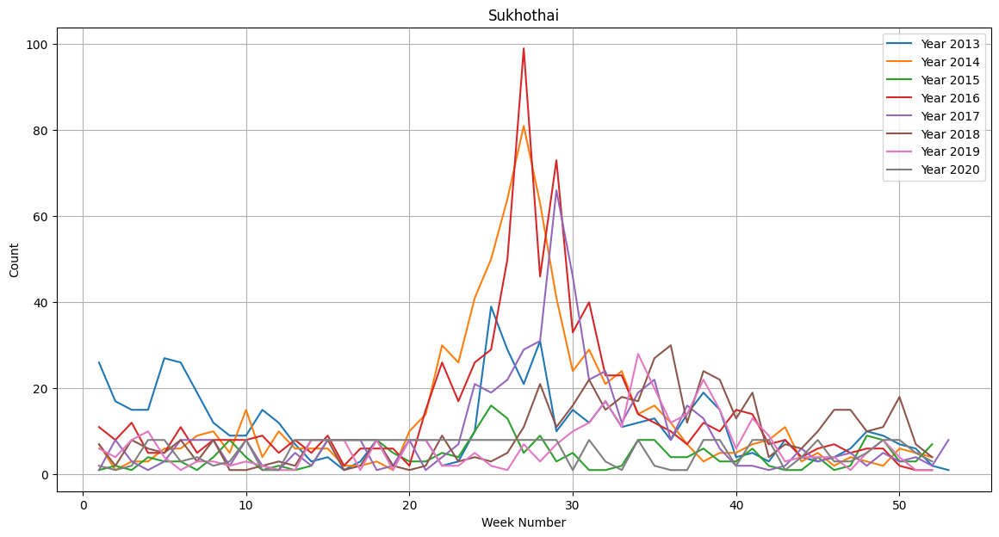


RMSE: 1.2808851428622705


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-1.280885,-1.280885,-2.427859,root_mean_squared_error,0.037906,0.024438,5.082274,0.004712,0.000572,0.020339,2,True,11
1,LightGBM,-1.337662,-1.337662,-5.771963,root_mean_squared_error,0.008658,0.001850,0.393458,0.008658,0.001850,0.393458,1,True,4
2,NeuralNetTorch,-1.423085,-1.423085,-2.481972,root_mean_squared_error,0.013608,0.015385,4.412876,0.013608,0.015385,4.412876,1,True,9
3,LightGBMXT,-1.432951,-1.432951,-4.926679,root_mean_squared_error,0.045609,0.012748,0.888431,0.045609,0.012748,0.888431,1,True,3
4,LightGBMLarge,-1.750751,-1.750751,-4.048860,root_mean_squared_error,0.038423,0.010157,0.805802,0.038423,0.010157,0.805802,1,True,10
5,NeuralNetFastAI,-2.023845,-2.023845,-3.219964,root_mean_squared_error,0.019587,0.008481,0.649060,0.019587,0.008481,0.649060,1,True,7
6,ExtraTreesMSE,-2.438695,-2.438695,-3.921130,root_mean_squared_error,0.111456,0.087261,0.613157,0.111456,0.087261,0.613157,1,True,6
7,RandomForestMSE,-3.497533,-3.497533,-4.043553,root_mean_squared_error,0.094132,0.086068,0.630839,0.094132,0.086068,0.630839,1,True,5
8,KNeighborsDist,-3.896346,-3.896346,-5.577426,root_mean_squared_error,0.014376,0.014344,0.010890,0.014376,0.014344,0.010890,1,True,2
9,KNeighborsUnif,-3.900592,-3.900592,-5.767711,root_mean_squared_error,0.013984,0.015499,0.016323,0.013984,0.015499,0.016323,1,True,1


In [57]:
province = "Sukhothai"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Sukhothai = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Sukhothai.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Sukhothai.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Phitsanulok

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192507"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.62 GB / 12.67 GB (83.8%)
Disk Space Avail:   75.47 GB / 107.72 GB (70.1%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 7.08722
[2000]	valid_set's rmse: 6.51941
[3000]	valid_set's rmse: 6.13073
[4000]	valid_set's rmse: 5.8586
[5000]	valid_set's rmse: 5.6953
[6000]	valid_set's rmse: 5.55069
[7000]	valid_set's rmse: 5.39216
[8000]	valid_set's rmse: 5.28916
[9000]	valid_set's rmse: 5.21552
[10000]	valid_set's rmse: 5.11789


	-5.1162	 = Validation score   (-root_mean_squared_error)
	1.8s	 = Training   runtime
	0.05s	 = Validation runtime
Fitting model: LightGBM ...
	-6.4508	 = Validation score   (-root_mean_squared_error)
	0.33s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-5.4222	 = Validation score   (-root_mean_squared_error)
	0.66s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-4.3074	 = Validation score   (-root_mean_squared_error)
	0.6s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-5.8674	 = Validation score   (-root_mean_squared_error)
	0.63s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-4.4609	 = Validation score   (-root_mean_squared_error)
	0.42s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-3.5012	 = Validation score   (-root_mean_squared_error)
	4.87s	 = Training   runti

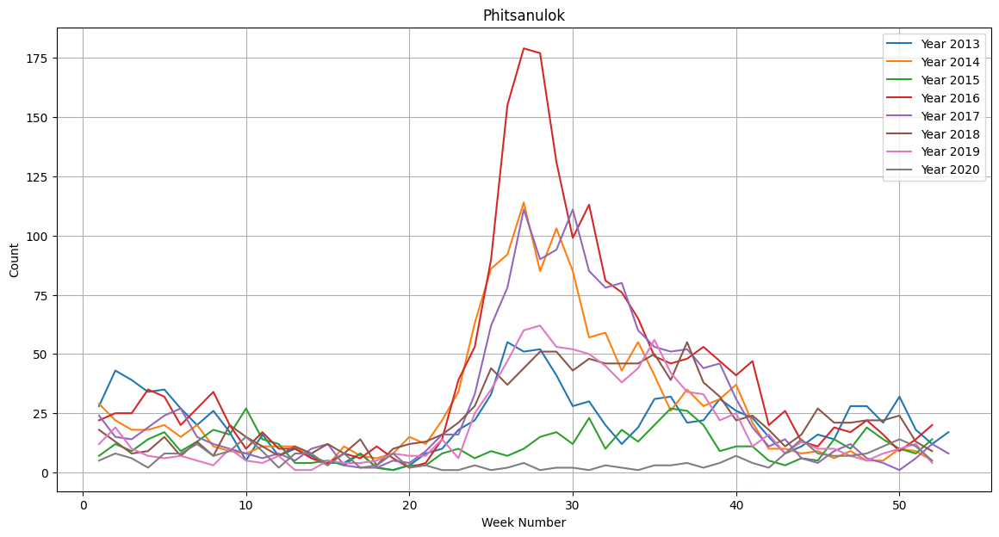


RMSE: 1.6779362531897022


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-1.677936,-1.677936,-3.320081,root_mean_squared_error,0.036006,0.019456,5.303482,0.003386,0.000530,0.016646,2,True,11
1,NeuralNetTorch,-1.976752,-1.976752,-3.501192,root_mean_squared_error,0.012286,0.012516,4.865336,0.012286,0.012516,4.865336,1,True,9
2,ExtraTreesMSE,-3.629419,-3.629419,-4.307395,root_mean_squared_error,0.082035,0.086931,0.604322,0.082035,0.086931,0.604322,1,True,6
3,LightGBMXT,-3.905682,-3.905682,-5.116209,root_mean_squared_error,0.143329,0.052480,1.803743,0.143329,0.052480,1.803743,1,True,3
4,KNeighborsUnif,-4.257843,-4.257843,-6.493406,root_mean_squared_error,0.015386,0.018311,0.016273,0.015386,0.018311,0.016273,1,True,1
5,KNeighborsDist,-4.328124,-4.328124,-5.865912,root_mean_squared_error,0.014127,0.013447,0.009461,0.014127,0.013447,0.009461,1,True,2
6,RandomForestMSE,-4.338683,-4.338683,-5.422187,root_mean_squared_error,0.090612,0.076265,0.662333,0.090612,0.076265,0.662333,1,True,5
7,LightGBMLarge,-4.620139,-4.620139,-6.287249,root_mean_squared_error,0.021843,0.008070,0.925652,0.021843,0.008070,0.925652,1,True,10
8,LightGBM,-4.727743,-4.727743,-6.450841,root_mean_squared_error,0.012303,0.001431,0.328505,0.012303,0.001431,0.328505,1,True,4
9,XGBoost,-6.321053,-6.321053,-4.460896,root_mean_squared_error,0.020335,0.006410,0.421500,0.020335,0.006410,0.421500,1,True,8


In [58]:
province = "Phitsanulok"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Phitsanulok = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Phitsanulok.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Phitsanulok.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Phichit

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192520"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.61 GB / 12.67 GB (83.7%)
Disk Space Avail:   75.44 GB / 107.72 GB (70.0%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

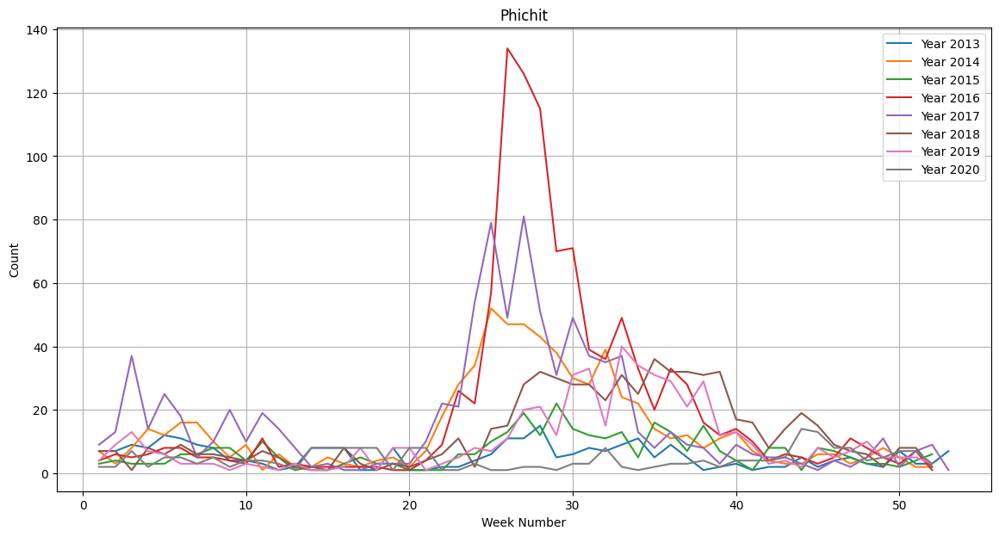


RMSE: 1.2943102281414638


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-1.294310,-1.294310,-2.811158,root_mean_squared_error,0.135113,0.105930,3.775480,0.003783,0.000652,0.020730,2,True,11
1,ExtraTreesMSE,-1.352057,-1.352057,-4.019933,root_mean_squared_error,0.095220,0.076715,0.599082,0.095220,0.076715,0.599082,1,True,6
2,RandomForestMSE,-1.433804,-1.433804,-3.541443,root_mean_squared_error,0.100078,0.087543,0.808392,0.100078,0.087543,0.808392,1,True,5
3,XGBoost,-1.522220,-1.522220,-4.916481,root_mean_squared_error,0.018058,0.004548,0.292769,0.018058,0.004548,0.292769,1,True,8
4,LightGBM,-1.708352,-1.708352,-5.746217,root_mean_squared_error,0.007859,0.002666,0.373867,0.007859,0.002666,0.373867,1,True,4
5,NeuralNetTorch,-1.857214,-1.857214,-3.686499,root_mean_squared_error,0.014464,0.010360,2.347229,0.014464,0.010360,2.347229,1,True,9
6,LightGBMLarge,-2.124889,-2.124889,-4.208820,root_mean_squared_error,0.005590,0.001668,0.520175,0.005590,0.001668,0.520175,1,True,10
7,LightGBMXT,-2.798762,-2.798762,-6.544860,root_mean_squared_error,0.002427,0.001388,0.326785,0.002427,0.001388,0.326785,1,True,3
8,NeuralNetFastAI,-3.370954,-3.370954,-4.786739,root_mean_squared_error,0.016788,0.007375,0.599129,0.016788,0.007375,0.599129,1,True,7
9,KNeighborsDist,-3.382563,-3.382563,-6.609234,root_mean_squared_error,0.014996,0.013769,0.011140,0.014996,0.013769,0.011140,1,True,2


In [59]:
province = "Phichit"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Phichit = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Phichit.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Phichit.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Phetchabun

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192528"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.43 GB / 107.72 GB (70.0%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

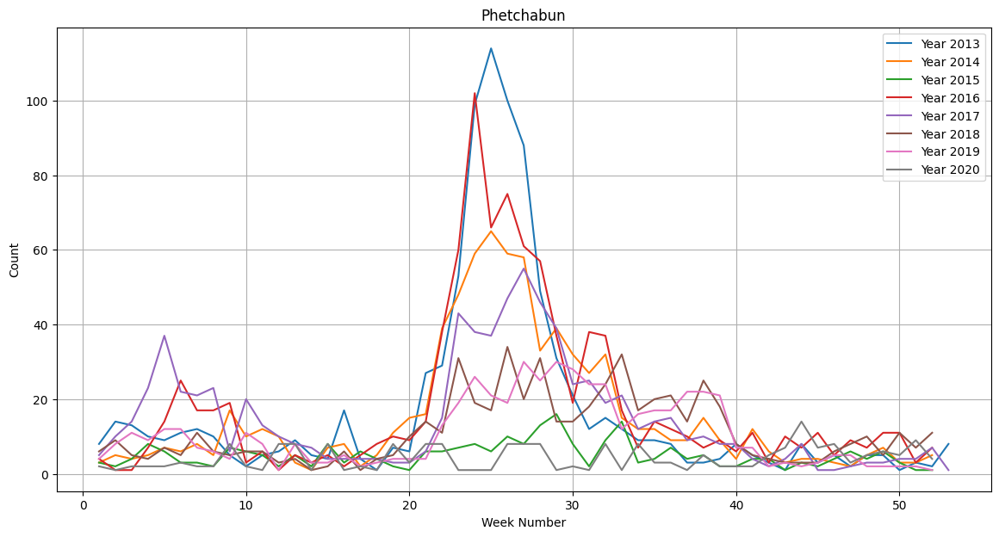


RMSE: 1.8661826660724872


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetTorch,-1.572240,-1.572240,-3.461484,root_mean_squared_error,0.010846,0.008004,2.957733,0.010846,0.008004,2.957733,1,True,9
1,WeightedEnsemble_L2,-1.866183,-1.866183,-3.146446,root_mean_squared_error,0.054233,0.027856,4.521982,0.003921,0.000515,0.014951,2,True,11
2,LightGBM,-2.024386,-2.024386,-4.270187,root_mean_squared_error,0.005490,0.002275,0.463998,0.005490,0.002275,0.463998,1,True,4
3,LightGBMLarge,-2.117374,-2.117374,-5.352333,root_mean_squared_error,0.011224,0.002685,0.451913,0.011224,0.002685,0.451913,1,True,10
4,ExtraTreesMSE,-2.161616,-2.161616,-3.867597,root_mean_squared_error,0.092468,0.112345,0.937830,0.092468,0.112345,0.937830,1,True,6
5,RandomForestMSE,-2.180618,-2.180618,-4.345951,root_mean_squared_error,0.079854,0.055500,1.108874,0.079854,0.055500,1.108874,1,True,5
6,XGBoost,-2.354911,-2.354911,-4.323137,root_mean_squared_error,0.018676,0.004851,0.328846,0.018676,0.004851,0.328846,1,True,8
7,LightGBMXT,-2.679941,-2.679941,-5.308584,root_mean_squared_error,0.009170,0.003281,0.546242,0.009170,0.003281,0.546242,1,True,3
8,NeuralNetFastAI,-3.134660,-3.134660,-3.587070,root_mean_squared_error,0.015301,0.012210,0.756453,0.015301,0.012210,0.756453,1,True,7
9,KNeighborsUnif,-3.322302,-3.322302,-6.373425,root_mean_squared_error,0.014142,0.013470,0.021091,0.014142,0.013470,0.021091,1,True,1


In [60]:
province = "Phetchabun"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Phetchabun = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Phetchabun.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Phetchabun.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Ratchaburi

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192537"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.41 GB / 107.72 GB (70.0%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 3.22266
[2000]	valid_set's rmse: 3.0188
[3000]	valid_set's rmse: 2.92875
[4000]	valid_set's rmse: 2.89535
[5000]	valid_set's rmse: 2.88729
[6000]	valid_set's rmse: 2.86985
[7000]	valid_set's rmse: 2.87226
[8000]	valid_set's rmse: 2.88052


	-2.8631	 = Validation score   (-root_mean_squared_error)
	1.37s	 = Training   runtime
	0.03s	 = Validation runtime
Fitting model: LightGBM ...
	-3.0878	 = Validation score   (-root_mean_squared_error)
	0.33s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.4195	 = Validation score   (-root_mean_squared_error)
	0.63s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.4122	 = Validation score   (-root_mean_squared_error)
	0.58s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.5439	 = Validation score   (-root_mean_squared_error)
	0.62s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.9104	 = Validation score   (-root_mean_squared_error)
	0.3s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.5221	 = Validation score   (-root_mean_squared_error)
	2.98s	 = Training   runti

[1000]	valid_set's rmse: 3.04233


	-3.0416	 = Validation score   (-root_mean_squared_error)
	0.82s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.471, 'NeuralNetFastAI': 0.235, 'LightGBMLarge': 0.235, 'LightGBMXT': 0.059}
	-2.1722	 = Validation score   (-root_mean_squared_error)
	0.01s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 8.89s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 1167.0 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192537")


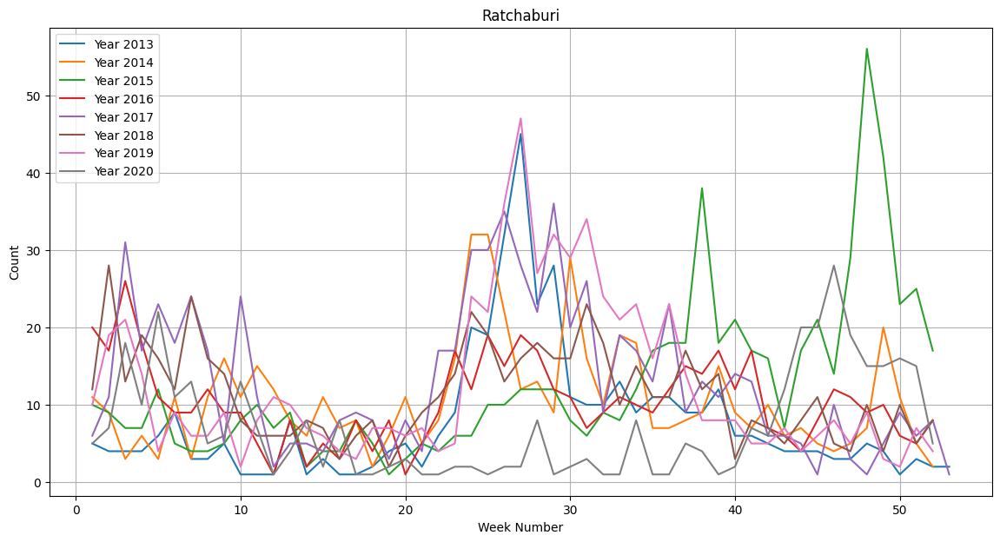


RMSE: 2.0957481723906524


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-2.095748,-2.095748,-2.172218,root_mean_squared_error,0.165598,0.063408,5.800601,0.005867,0.000510,0.014937,2,True,11
1,XGBoost,-2.100010,-2.100010,-2.910354,root_mean_squared_error,0.023559,0.004829,0.304312,0.023559,0.004829,0.304312,1,True,8
2,LightGBM,-2.323704,-2.323704,-3.087812,root_mean_squared_error,0.009758,0.001818,0.329447,0.009758,0.001818,0.329447,1,True,4
3,RandomForestMSE,-2.350433,-2.350433,-3.419492,root_mean_squared_error,0.079491,0.077411,0.634568,0.079491,0.077411,0.634568,1,True,5
4,ExtraTreesMSE,-2.585750,-2.585750,-3.412241,root_mean_squared_error,0.090234,0.075994,0.583825,0.090234,0.075994,0.583825,1,True,6
5,LightGBMLarge,-2.803024,-2.803024,-3.041650,root_mean_squared_error,0.038888,0.009642,0.818064,0.038888,0.009642,0.818064,1,True,10
6,NeuralNetFastAI,-2.864724,-2.864724,-2.543913,root_mean_squared_error,0.015517,0.007942,0.617191,0.015517,0.007942,0.617191,1,True,7
7,NeuralNetTorch,-2.932316,-2.932316,-2.522128,root_mean_squared_error,0.012684,0.012415,2.980438,0.012684,0.012415,2.980438,1,True,9
8,LightGBMXT,-3.367046,-3.367046,-2.863075,root_mean_squared_error,0.092643,0.032899,1.369971,0.092643,0.032899,1.369971,1,True,3
9,KNeighborsDist,-4.555188,-4.555188,-4.895271,root_mean_squared_error,0.013793,0.014027,0.011501,0.013793,0.014027,0.011501,1,True,2


In [61]:
province = "Ratchaburi"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Ratchaburi = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Ratchaburi.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Ratchaburi.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Kanchanaburi

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192547"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.64 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.39 GB / 107.72 GB (70.0%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 3.17045
[2000]	valid_set's rmse: 3.01742
[3000]	valid_set's rmse: 2.98335
[4000]	valid_set's rmse: 2.9806
[5000]	valid_set's rmse: 2.95041
[6000]	valid_set's rmse: 2.94276
[7000]	valid_set's rmse: 2.93134
[8000]	valid_set's rmse: 2.93613
[9000]	valid_set's rmse: 2.93141
[10000]	valid_set's rmse: 2.91673


	-2.9158	 = Validation score   (-root_mean_squared_error)
	1.84s	 = Training   runtime
	0.05s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's rmse: 3.14813


	-3.138	 = Validation score   (-root_mean_squared_error)
	0.55s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.0458	 = Validation score   (-root_mean_squared_error)
	0.62s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.3582	 = Validation score   (-root_mean_squared_error)
	0.65s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.6853	 = Validation score   (-root_mean_squared_error)
	0.89s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-3.3289	 = Validation score   (-root_mean_squared_error)
	0.49s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-3.2422	 = Validation score   (-root_mean_squared_error)
	1.9s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBMLarge ...


[1000]	valid_set's rmse: 2.8165
[2000]	valid_set's rmse: 2.74883
[3000]	valid_set's rmse: 2.73523
[4000]	valid_set's rmse: 2.73276
[5000]	valid_set's rmse: 2.73153
[6000]	valid_set's rmse: 2.731
[7000]	valid_set's rmse: 2.73078
[8000]	valid_set's rmse: 2.73068
[9000]	valid_set's rmse: 2.73063
[10000]	valid_set's rmse: 2.73063


	-2.7306	 = Validation score   (-root_mean_squared_error)
	7.59s	 = Training   runtime
	0.22s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetFastAI': 0.48, 'LightGBMXT': 0.28, 'LightGBMLarge': 0.24}
	-2.2858	 = Validation score   (-root_mean_squared_error)
	0.02s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 18.11s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 260.6 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192547")


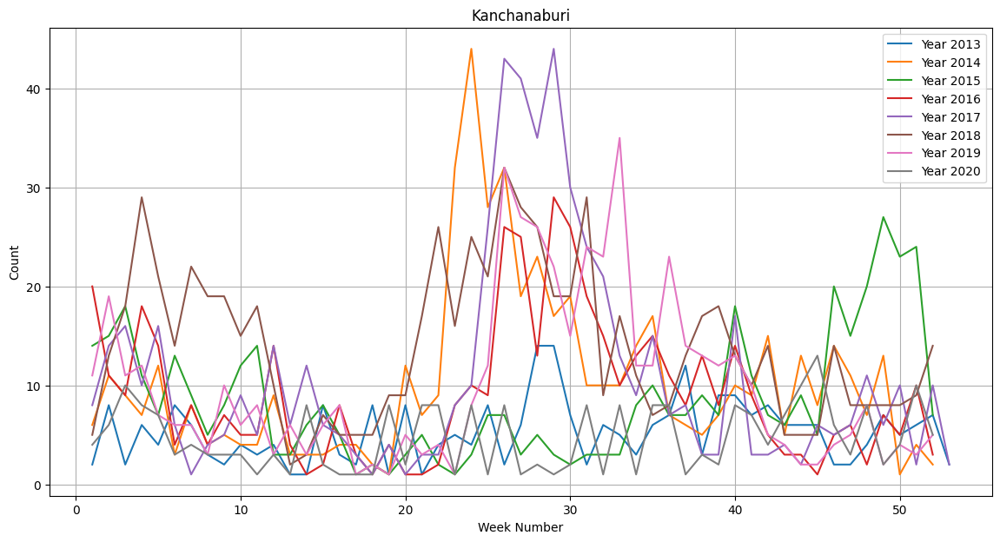


RMSE: 1.652356657653298


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,XGBoost,-1.236297,-1.236297,-3.328947,root_mean_squared_error,0.019843,0.008456,0.492496,0.019843,0.008456,0.492496,1,True,8
1,LightGBMXT,-1.320659,-1.320659,-2.915754,root_mean_squared_error,0.142252,0.054069,1.838087,0.142252,0.054069,1.838087,1,True,3
2,RandomForestMSE,-1.604511,-1.604511,-3.045845,root_mean_squared_error,0.093150,0.078407,0.624518,0.093150,0.078407,0.624518,1,True,5
3,ExtraTreesMSE,-1.646072,-1.646072,-3.358218,root_mean_squared_error,0.078816,0.077252,0.646972,0.078816,0.077252,0.646972,1,True,6
4,WeightedEnsemble_L2,-1.652357,-1.652357,-2.285801,root_mean_squared_error,0.819095,0.283932,10.342443,0.020423,0.000525,0.016222,2,True,11
5,LightGBMLarge,-1.660642,-1.660642,-2.730625,root_mean_squared_error,0.641755,0.218540,7.594035,0.641755,0.218540,7.594035,1,True,10
6,LightGBM,-1.768997,-1.768997,-3.138014,root_mean_squared_error,0.030689,0.008257,0.546361,0.030689,0.008257,0.546361,1,True,4
7,NeuralNetTorch,-1.991296,-1.991296,-3.242228,root_mean_squared_error,0.010828,0.020563,1.897327,0.010828,0.020563,1.897327,1,True,9
8,NeuralNetFastAI,-2.271360,-2.271360,-2.685291,root_mean_squared_error,0.014664,0.010798,0.894099,0.014664,0.010798,0.894099,1,True,7
9,KNeighborsUnif,-3.421088,-3.421088,-4.854031,root_mean_squared_error,0.014491,0.031227,0.009812,0.014491,0.031227,0.009812,1,True,1


In [62]:
province = "Kanchanaburi"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Kanchanaburi = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Kanchanaburi.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Kanchanaburi.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Suphan Buri

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192608"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.62 GB / 12.67 GB (83.8%)
Disk Space Avail:   75.33 GB / 107.72 GB (69.9%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.71609
[2000]	valid_set's rmse: 2.4725


	-2.4531	 = Validation score   (-root_mean_squared_error)
	0.67s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-2.4195	 = Validation score   (-root_mean_squared_error)
	0.5s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.1296	 = Validation score   (-root_mean_squared_error)
	1.08s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.1336	 = Validation score   (-root_mean_squared_error)
	0.98s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.9698	 = Validation score   (-root_mean_squared_error)
	0.82s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.4637	 = Validation score   (-root_mean_squared_error)
	0.34s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.6579	 = Validation score   (-root_mean_squared_error)
	2.46s	 = Training   runt

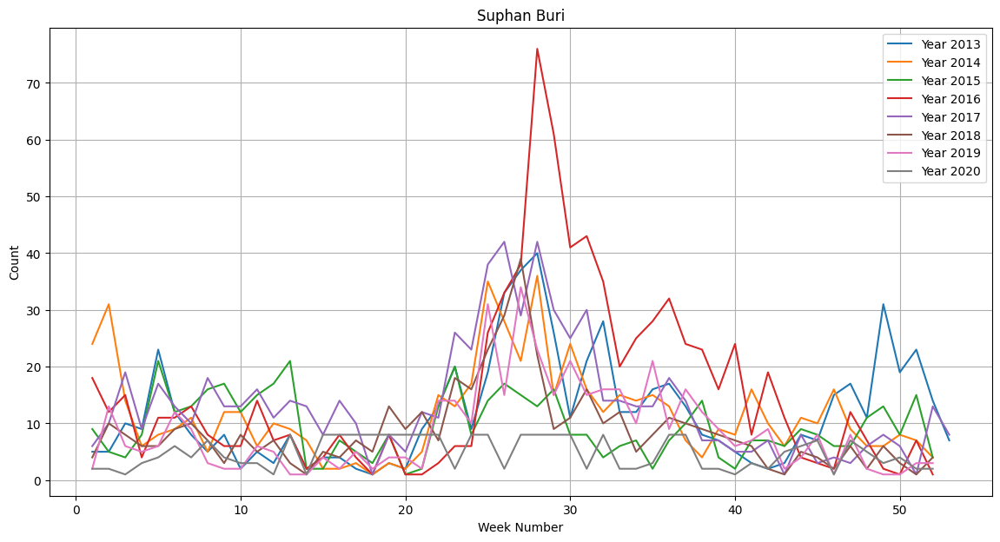


RMSE: 0.9253846706736347


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-0.925385,-0.925385,-1.438538,root_mean_squared_error,0.066506,0.030473,4.137598,0.004068,0.000559,0.016072,2,True,11
1,LightGBM,-1.040418,-1.040418,-2.419503,root_mean_squared_error,0.011330,0.003731,0.498311,0.011330,0.003731,0.498311,1,True,4
2,NeuralNetTorch,-1.061195,-1.061195,-1.657888,root_mean_squared_error,0.013033,0.012099,2.456926,0.013033,0.012099,2.456926,1,True,9
3,LightGBMXT,-1.135480,-1.135480,-2.453091,root_mean_squared_error,0.032756,0.010667,0.665903,0.032756,0.010667,0.665903,1,True,3
4,XGBoost,-1.156877,-1.156877,-2.463656,root_mean_squared_error,0.019987,0.006524,0.343803,0.019987,0.006524,0.343803,1,True,8
5,NeuralNetFastAI,-1.265276,-1.265276,-1.969790,root_mean_squared_error,0.018088,0.007560,0.822486,0.018088,0.007560,0.822486,1,True,7
6,ExtraTreesMSE,-1.294930,-1.294930,-3.133559,root_mean_squared_error,0.081223,0.092412,0.983454,0.081223,0.092412,0.983454,1,True,6
7,RandomForestMSE,-1.381788,-1.381788,-3.129578,root_mean_squared_error,0.078063,0.070354,1.080699,0.078063,0.070354,1.080699,1,True,5
8,LightGBMLarge,-1.431305,-1.431305,-4.257280,root_mean_squared_error,0.013030,0.002831,0.629650,0.013030,0.002831,0.629650,1,True,10
9,KNeighborsDist,-3.203204,-3.203204,-4.812374,root_mean_squared_error,0.013904,0.014035,0.007712,0.013904,0.014035,0.007712,1,True,2


In [63]:
province = "Suphan Buri"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Suphan_Buri = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Suphan_Buri.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Suphan_Buri.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Nakhon Pathom

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192617"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.31 GB / 107.72 GB (69.9%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 4.08386
[2000]	valid_set's rmse: 4.0798


	-4.0073	 = Validation score   (-root_mean_squared_error)
	0.56s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-3.581	 = Validation score   (-root_mean_squared_error)
	0.47s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-4.4681	 = Validation score   (-root_mean_squared_error)
	0.68s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-4.1383	 = Validation score   (-root_mean_squared_error)
	0.62s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-3.5329	 = Validation score   (-root_mean_squared_error)
	0.58s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-3.2194	 = Validation score   (-root_mean_squared_error)
	0.4s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.6676	 = Validation score   (-root_mean_squared_error)
	3.71s	 = Training   runti

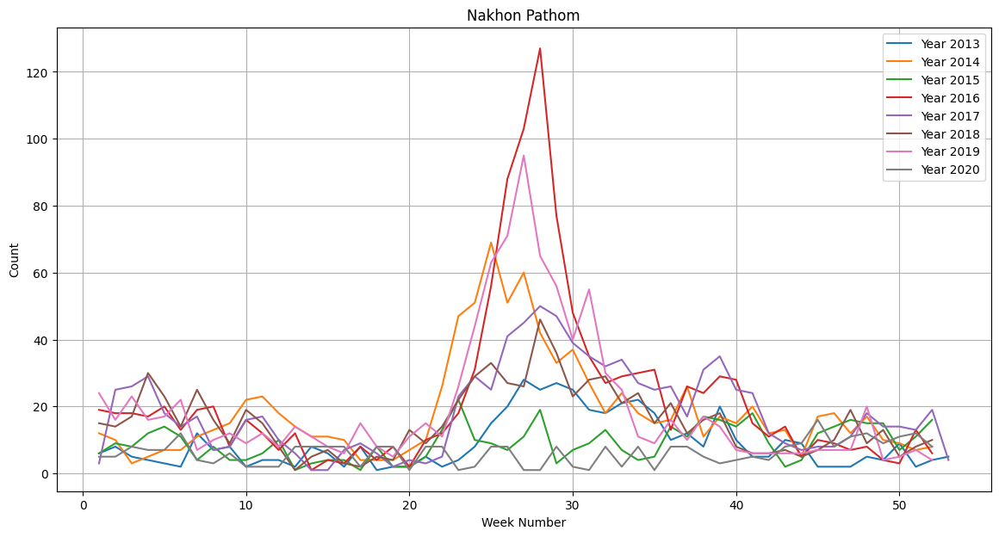


RMSE: 1.629491843572152


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-1.629492,-1.629492,-1.610464,root_mean_squared_error,0.043701,0.018488,4.128771,0.003087,0.000649,0.018420,2,True,11
1,XGBoost,-1.662421,-1.662421,-3.219426,root_mean_squared_error,0.027656,0.005422,0.398689,0.027656,0.005422,0.398689,1,True,8
2,LightGBM,-1.677339,-1.677339,-3.580958,root_mean_squared_error,0.016491,0.003831,0.466006,0.016491,0.003831,0.466006,1,True,4
3,LightGBMXT,-1.724280,-1.724280,-4.007258,root_mean_squared_error,0.023494,0.008071,0.560594,0.023494,0.008071,0.560594,1,True,3
4,NeuralNetTorch,-1.900782,-1.900782,-1.667623,root_mean_squared_error,0.012958,0.012418,3.711662,0.012958,0.012418,3.711662,1,True,9
5,ExtraTreesMSE,-1.975604,-1.975604,-4.138324,root_mean_squared_error,0.097799,0.076395,0.615865,0.097799,0.076395,0.615865,1,True,6
6,RandomForestMSE,-2.048131,-2.048131,-4.468064,root_mean_squared_error,0.086889,0.078043,0.682525,0.086889,0.078043,0.682525,1,True,5
7,LightGBMLarge,-2.907289,-2.907289,-4.061881,root_mean_squared_error,0.005165,0.001605,0.500731,0.005165,0.001605,0.500731,1,True,10
8,NeuralNetFastAI,-4.000076,-4.000076,-3.532905,root_mean_squared_error,0.017917,0.007490,0.584506,0.017917,0.007490,0.584506,1,True,7
9,KNeighborsDist,-4.183135,-4.183135,-4.880361,root_mean_squared_error,0.015064,0.013184,0.007189,0.015064,0.013184,0.007189,1,True,2


In [64]:
province = "Nakhon Pathom"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Nakhon_Pathom = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Nakhon_Pathom.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Nakhon_Pathom.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Samut Sakhon

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192627"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.61 GB / 12.67 GB (83.7%)
Disk Space Avail:   75.29 GB / 107.72 GB (69.9%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.87848
[2000]	valid_set's rmse: 2.7402


	-2.7159	 = Validation score   (-root_mean_squared_error)
	0.73s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-2.95	 = Validation score   (-root_mean_squared_error)
	0.47s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.5279	 = Validation score   (-root_mean_squared_error)
	0.77s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.5902	 = Validation score   (-root_mean_squared_error)
	0.76s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.5897	 = Validation score   (-root_mean_squared_error)
	0.8s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.3253	 = Validation score   (-root_mean_squared_error)
	0.32s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.0282	 = Validation score   (-root_mean_squared_error)
	1.72s	 = Training   runtim

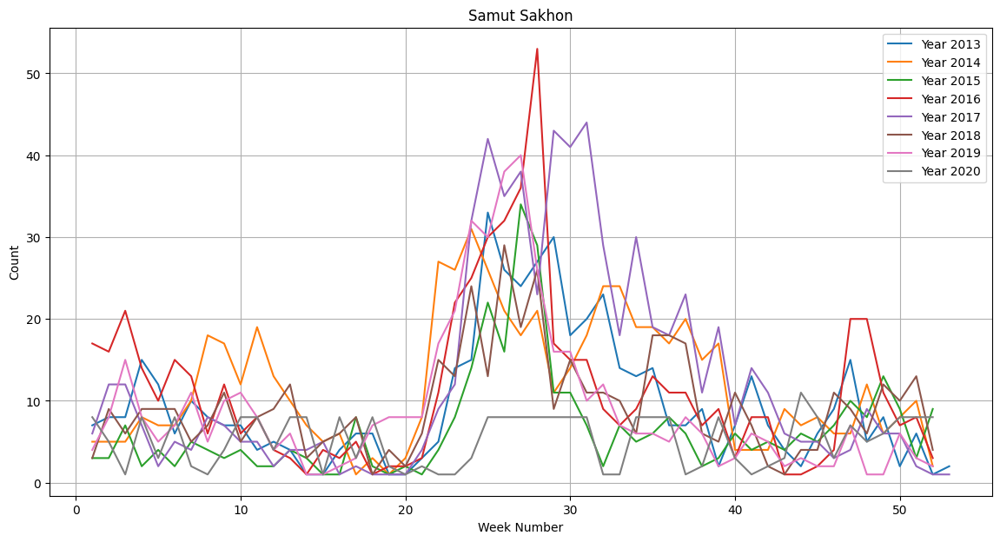


RMSE: 1.4290450097175769


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,XGBoost,-1.253742,-1.253742,-2.325317,root_mean_squared_error,0.023567,0.005066,0.319207,0.023567,0.005066,0.319207,1,True,8
1,LightGBM,-1.268440,-1.268440,-2.950023,root_mean_squared_error,0.011863,0.003231,0.468564,0.011863,0.003231,0.468564,1,True,4
2,LightGBMXT,-1.366498,-1.366498,-2.715933,root_mean_squared_error,0.022776,0.008446,0.728745,0.022776,0.008446,0.728745,1,True,3
3,WeightedEnsemble_L2,-1.429045,-1.429045,-1.565252,root_mean_squared_error,0.069239,0.029331,3.324246,0.004063,0.000603,0.015488,2,True,11
4,ExtraTreesMSE,-1.553100,-1.553100,-2.590210,root_mean_squared_error,0.093870,0.077887,0.764811,0.093870,0.077887,0.764811,1,True,6
5,RandomForestMSE,-1.568581,-1.568581,-2.527885,root_mean_squared_error,0.079585,0.088811,0.766310,0.079585,0.088811,0.766310,1,True,5
6,LightGBMLarge,-1.766031,-1.766031,-3.302373,root_mean_squared_error,0.008138,0.001904,0.538674,0.008138,0.001904,0.538674,1,True,10
7,NeuralNetTorch,-1.909453,-1.909453,-2.028190,root_mean_squared_error,0.011177,0.009552,1.723092,0.011177,0.009552,1.723092,1,True,9
8,NeuralNetFastAI,-2.416216,-2.416216,-2.589727,root_mean_squared_error,0.018569,0.010880,0.797896,0.018569,0.010880,0.797896,1,True,7
9,KNeighborsDist,-2.941544,-2.941544,-3.658185,root_mean_squared_error,0.014009,0.014421,0.013051,0.014009,0.014421,0.013051,1,True,2


In [65]:
province = "Samut Sakhon"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Samut_Sakhon = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Samut_Sakhon.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Samut_Sakhon.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Samut Songkhram

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192635"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.28 GB / 107.72 GB (69.9%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 0.828401
[2000]	valid_set's rmse: 0.826126


	-0.8223	 = Validation score   (-root_mean_squared_error)
	0.85s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-0.8941	 = Validation score   (-root_mean_squared_error)
	0.47s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-0.796	 = Validation score   (-root_mean_squared_error)
	0.94s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-0.7894	 = Validation score   (-root_mean_squared_error)
	0.83s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-0.8841	 = Validation score   (-root_mean_squared_error)
	0.63s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-1.1444	 = Validation score   (-root_mean_squared_error)
	0.18s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-0.2907	 = Validation score   (-root_mean_squared_error)
	1.04s	 = Training   runti

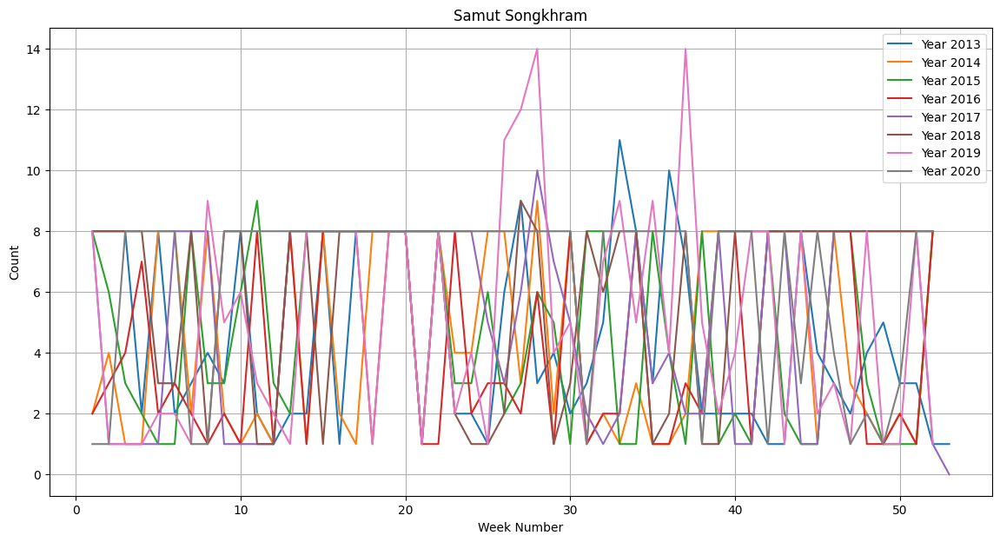


RMSE: 0.22436360099259522


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-0.224364,-0.224364,-0.283563,root_mean_squared_error,0.037808,0.016701,1.903105,0.004777,0.000513,0.017678,2,True,11
1,NeuralNetTorch,-0.238470,-0.238470,-0.290690,root_mean_squared_error,0.006860,0.003860,1.036392,0.006860,0.003860,1.036392,1,True,9
2,NeuralNetFastAI,-0.451476,-0.451476,-0.884130,root_mean_squared_error,0.014861,0.008156,0.633781,0.014861,0.008156,0.633781,1,True,7
3,LightGBMXT,-0.563620,-0.563620,-0.822316,root_mean_squared_error,0.026171,0.012328,0.849035,0.026171,0.012328,0.849035,1,True,3
4,LightGBM,-0.651284,-0.651284,-0.894116,root_mean_squared_error,0.009005,0.003172,0.469649,0.009005,0.003172,0.469649,1,True,4
5,ExtraTreesMSE,-0.976173,-0.976173,-0.789366,root_mean_squared_error,0.090772,0.077219,0.832703,0.090772,0.077219,0.832703,1,True,6
6,LightGBMLarge,-1.067213,-1.067213,-1.121772,root_mean_squared_error,0.023457,0.005139,0.590649,0.023457,0.005139,0.590649,1,True,10
7,RandomForestMSE,-1.098366,-1.098366,-0.796036,root_mean_squared_error,0.085732,0.066896,0.943666,0.085732,0.066896,0.943666,1,True,5
8,XGBoost,-1.476375,-1.476375,-1.144353,root_mean_squared_error,0.013896,0.004166,0.184084,0.013896,0.004166,0.184084,1,True,8
9,KNeighborsDist,-2.921665,-2.921665,-2.844562,root_mean_squared_error,0.014175,0.013349,0.007267,0.014175,0.013349,0.007267,1,True,2


In [66]:
province = "Samut Songkhram"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Samut_Songkhram = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Samut_Songkhram.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Samut_Songkhram.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Phetchaburi

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192642"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.61 GB / 12.67 GB (83.7%)
Disk Space Avail:   75.27 GB / 107.72 GB (69.9%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

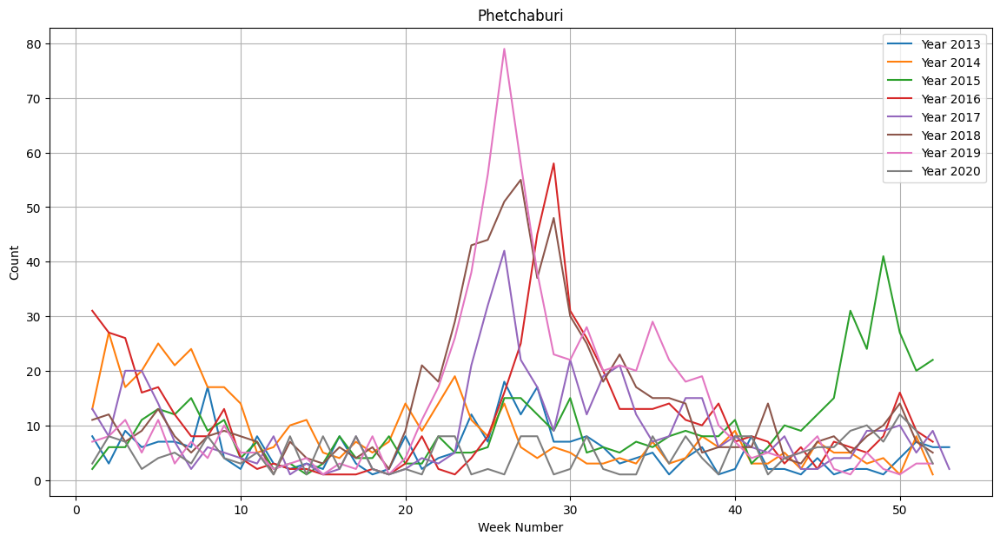


RMSE: 2.3577338396019565


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,ExtraTreesMSE,-1.696269,-1.696269,-3.165741,root_mean_squared_error,0.101891,0.075442,0.617503,0.101891,0.075442,0.617503,1,True,6
1,RandomForestMSE,-1.851953,-1.851953,-3.383391,root_mean_squared_error,0.103135,0.076663,0.677651,0.103135,0.076663,0.677651,1,True,5
2,NeuralNetTorch,-2.014814,-2.014814,-2.676440,root_mean_squared_error,0.017296,0.009248,2.199009,0.017296,0.009248,2.199009,1,True,9
3,XGBoost,-2.135525,-2.135525,-3.518677,root_mean_squared_error,0.017283,0.003196,0.222561,0.017283,0.003196,0.222561,1,True,8
4,WeightedEnsemble_L2,-2.357734,-2.357734,-2.166039,root_mean_squared_error,0.038685,0.017982,2.826807,0.003341,0.000816,0.025425,2,True,11
5,LightGBM,-2.530514,-2.530514,-3.591268,root_mean_squared_error,0.002351,0.001241,0.485806,0.002351,0.001241,0.485806,1,True,4
6,LightGBMLarge,-2.668273,-2.668273,-3.814029,root_mean_squared_error,0.005031,0.001481,0.472328,0.005031,0.001481,0.472328,1,True,10
7,LightGBMXT,-3.188525,-3.188525,-4.114844,root_mean_squared_error,0.002397,0.001238,0.429619,0.002397,0.001238,0.429619,1,True,3
8,NeuralNetFastAI,-3.204581,-3.204581,-2.427736,root_mean_squared_error,0.018048,0.007918,0.602373,0.018048,0.007918,0.602373,1,True,7
9,KNeighborsDist,-3.368830,-3.368830,-5.215884,root_mean_squared_error,0.014155,0.014581,0.008867,0.014155,0.014581,0.008867,1,True,2


In [67]:
province = "Phetchaburi"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Phetchaburi = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Phetchaburi.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Phetchaburi.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Prachuap Khiri Khan

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192650"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.61 GB / 12.67 GB (83.7%)
Disk Space Avail:   75.25 GB / 107.72 GB (69.9%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 4.0194
[2000]	valid_set's rmse: 3.62983
[3000]	valid_set's rmse: 3.50294
[4000]	valid_set's rmse: 3.44532
[5000]	valid_set's rmse: 3.43285


	-3.4123	 = Validation score   (-root_mean_squared_error)
	1.65s	 = Training   runtime
	0.03s	 = Validation runtime
Fitting model: LightGBM ...
	-4.0863	 = Validation score   (-root_mean_squared_error)
	0.53s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.9589	 = Validation score   (-root_mean_squared_error)
	0.67s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.2714	 = Validation score   (-root_mean_squared_error)
	0.59s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.5287	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.6914	 = Validation score   (-root_mean_squared_error)
	0.35s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.2212	 = Validation score   (-root_mean_squared_error)
	2.07s	 = Training   run

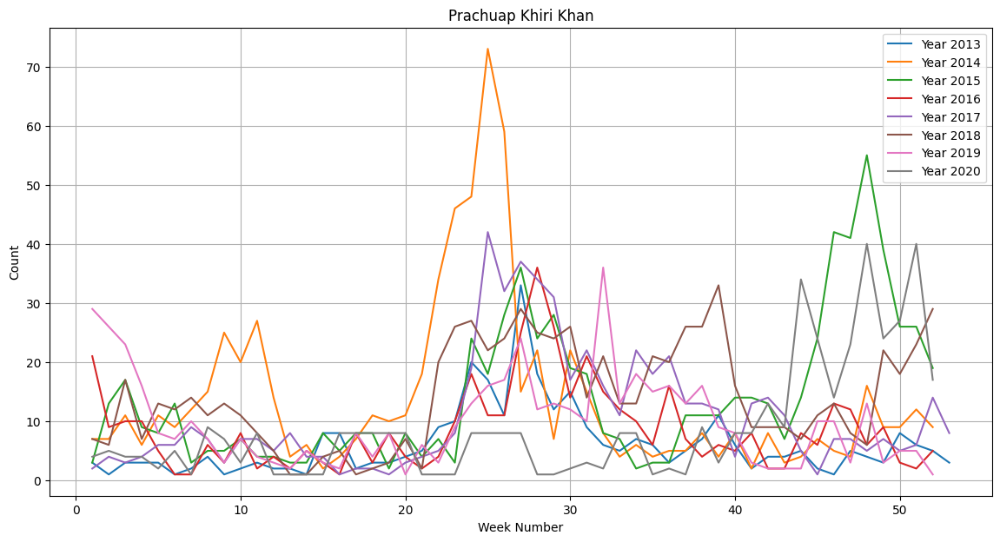


RMSE: 2.610216401085868


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-2.610216,-2.610216,-1.998995,root_mean_squared_error,0.120618,0.049956,4.733036,0.005234,0.000524,0.015298,2,True,11
1,NeuralNetFastAI,-2.825083,-2.825083,-2.528652,root_mean_squared_error,0.013965,0.009986,0.641452,0.013965,0.009986,0.641452,1,True,7
2,NeuralNetTorch,-2.836448,-2.836448,-2.221152,root_mean_squared_error,0.015747,0.008434,2.074985,0.015747,0.008434,2.074985,1,True,9
3,XGBoost,-3.384097,-3.384097,-2.691362,root_mean_squared_error,0.023121,0.006011,0.346859,0.023121,0.006011,0.346859,1,True,8
4,RandomForestMSE,-3.626121,-3.626121,-2.958932,root_mean_squared_error,0.089835,0.076326,0.670500,0.089835,0.076326,0.670500,1,True,5
5,ExtraTreesMSE,-3.727932,-3.727932,-3.271376,root_mean_squared_error,0.079671,0.076772,0.589734,0.079671,0.076772,0.589734,1,True,6
6,LightGBMXT,-4.222512,-4.222512,-3.412263,root_mean_squared_error,0.062551,0.025001,1.654443,0.062551,0.025001,1.654443,1,True,3
7,LightGBMLarge,-4.531161,-4.531161,-4.255934,root_mean_squared_error,0.010350,0.001885,0.414207,0.010350,0.001885,0.414207,1,True,10
8,LightGBM,-4.595956,-4.595956,-4.086282,root_mean_squared_error,0.013532,0.003478,0.532284,0.013532,0.003478,0.532284,1,True,4
9,KNeighborsUnif,-6.006215,-6.006215,-4.969638,root_mean_squared_error,0.014182,0.037769,0.012892,0.014182,0.037769,0.012892,1,True,1


In [68]:
province = "Prachuap Khiri Khan"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Prachuap_Khiri_Khan = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Prachuap_Khiri_Khan.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Prachuap_Khiri_Khan.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Nakhon Si Thammarat

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192659"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.23 GB / 107.72 GB (69.8%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 5.87518
[2000]	valid_set's rmse: 5.76175


	-5.7019	 = Validation score   (-root_mean_squared_error)
	0.61s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-5.9247	 = Validation score   (-root_mean_squared_error)
	0.52s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...


[1000]	valid_set's rmse: 5.92707


	-5.6054	 = Validation score   (-root_mean_squared_error)
	0.69s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-5.3233	 = Validation score   (-root_mean_squared_error)
	0.83s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-5.3167	 = Validation score   (-root_mean_squared_error)
	0.86s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-5.4241	 = Validation score   (-root_mean_squared_error)
	0.61s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-4.3846	 = Validation score   (-root_mean_squared_error)
	3.87s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-5.6606	 = Validation score   (-root_mean_squared_error)
	0.5s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.706, 'NeuralNetFastAI': 0.294}
	-4

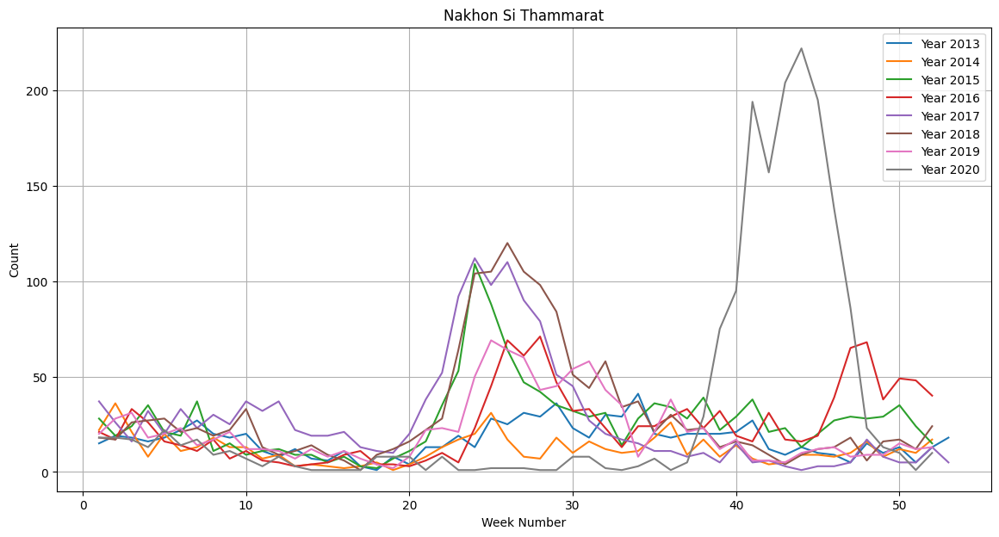


RMSE: 25.546459070365202


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-25.546459,-25.546459,-4.159804,root_mean_squared_error,0.029867,0.022034,4.739331,0.003173,0.000542,0.017165,2,True,11
1,NeuralNetTorch,-25.757984,-25.757984,-4.384562,root_mean_squared_error,0.010997,0.010434,3.865977,0.010997,0.010434,3.865977,1,True,9
2,NeuralNetFastAI,-25.836239,-25.836239,-5.316698,root_mean_squared_error,0.015697,0.011058,0.856189,0.015697,0.011058,0.856189,1,True,7
3,KNeighborsDist,-32.489795,-32.489795,-7.185912,root_mean_squared_error,0.013853,0.013991,0.009925,0.013853,0.013991,0.009925,1,True,2
4,KNeighborsUnif,-32.577836,-32.577836,-7.493529,root_mean_squared_error,0.013828,0.014013,0.021647,0.013828,0.014013,0.021647,1,True,1
5,ExtraTreesMSE,-32.856702,-32.856702,-5.323271,root_mean_squared_error,0.090532,0.068367,0.829130,0.090532,0.068367,0.829130,1,True,6
6,RandomForestMSE,-33.418249,-33.418249,-5.605444,root_mean_squared_error,0.090616,0.080729,0.686006,0.090616,0.080729,0.686006,1,True,5
7,LightGBMLarge,-34.838506,-34.838506,-5.660632,root_mean_squared_error,0.013530,0.003057,0.498355,0.013530,0.003057,0.498355,1,True,10
8,XGBoost,-37.721846,-37.721846,-5.424086,root_mean_squared_error,0.018686,0.007222,0.609566,0.018686,0.007222,0.609566,1,True,8
9,LightGBMXT,-43.424626,-43.424626,-5.701922,root_mean_squared_error,0.026087,0.009810,0.613997,0.026087,0.009810,0.613997,1,True,3


In [69]:
province = "Nakhon Si Thammarat"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Nakhon_Si_Thammarat = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Nakhon_Si_Thammarat.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Nakhon_Si_Thammarat.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Krabi

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192710"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.62 GB / 12.67 GB (83.8%)
Disk Space Avail:   75.22 GB / 107.72 GB (69.8%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 1.6928
[2000]	valid_set's rmse: 1.60593
[3000]	valid_set's rmse: 1.56654
[4000]	valid_set's rmse: 1.54352
[5000]	valid_set's rmse: 1.53239
[6000]	valid_set's rmse: 1.52105
[7000]	valid_set's rmse: 1.50952
[8000]	valid_set's rmse: 1.49712
[9000]	valid_set's rmse: 1.4912
[10000]	valid_set's rmse: 1.48379


	-1.484	 = Validation score   (-root_mean_squared_error)
	1.88s	 = Training   runtime
	0.05s	 = Validation runtime
Fitting model: LightGBM ...
	-1.6959	 = Validation score   (-root_mean_squared_error)
	0.46s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-1.7915	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-1.8134	 = Validation score   (-root_mean_squared_error)
	0.75s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-0.8303	 = Validation score   (-root_mean_squared_error)
	0.65s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-1.3914	 = Validation score   (-root_mean_squared_error)
	0.39s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.2217	 = Validation score   (-root_mean_squared_error)
	2.65s	 = Training   runt

[1000]	valid_set's rmse: 1.93008
[2000]	valid_set's rmse: 1.89557
[3000]	valid_set's rmse: 1.89144
[4000]	valid_set's rmse: 1.89039
[5000]	valid_set's rmse: 1.89019
[6000]	valid_set's rmse: 1.89015
[7000]	valid_set's rmse: 1.89015
[8000]	valid_set's rmse: 1.89015
[9000]	valid_set's rmse: 1.89015
[10000]	valid_set's rmse: 1.89015


	-1.8901	 = Validation score   (-root_mean_squared_error)
	6.12s	 = Training   runtime
	0.21s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetFastAI': 0.609, 'NeuralNetTorch': 0.261, 'LightGBMXT': 0.13}
	-0.688	 = Validation score   (-root_mean_squared_error)
	0.02s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 17.1s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 1031.3 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192710")


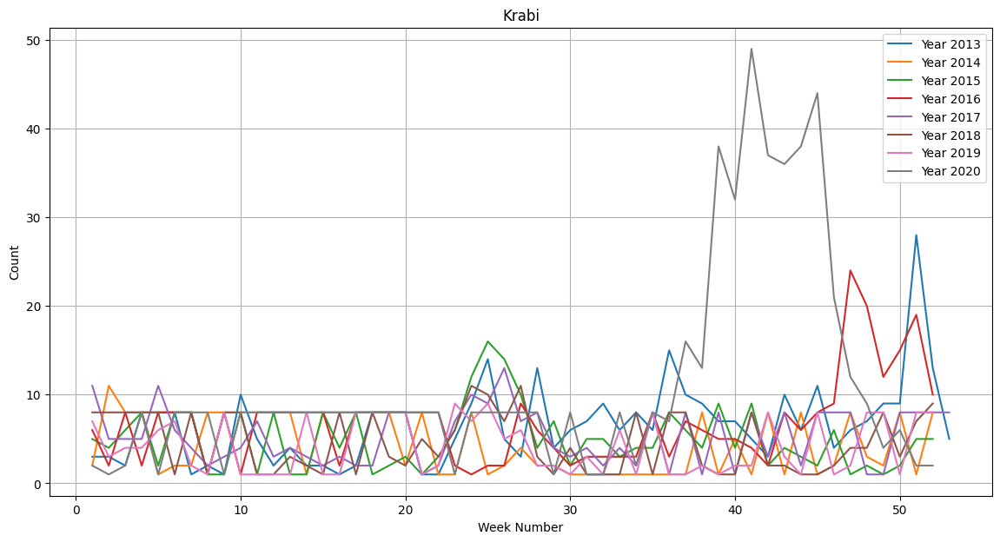


RMSE: 6.625753079405019


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetFastAI,-4.548327,-4.548327,-0.830325,root_mean_squared_error,0.020957,0.007986,0.645253,0.020957,0.007986,0.645253,1,True,7
1,WeightedEnsemble_L2,-6.625753,-6.625753,-0.687977,root_mean_squared_error,0.182374,0.071754,5.191897,0.018343,0.000550,0.015207,2,True,11
2,RandomForestMSE,-9.389781,-9.389781,-1.791459,root_mean_squared_error,0.078359,0.077441,0.642074,0.078359,0.077441,0.642074,1,True,5
3,ExtraTreesMSE,-9.413352,-9.413352,-1.813403,root_mean_squared_error,0.080278,0.075703,0.754929,0.080278,0.075703,0.754929,1,True,6
4,KNeighborsUnif,-9.633635,-9.633635,-3.436922,root_mean_squared_error,0.014434,0.020629,0.015203,0.014434,0.020629,0.015203,1,True,1
5,KNeighborsDist,-9.646652,-9.646652,-3.244347,root_mean_squared_error,0.014180,0.014271,0.009433,0.014180,0.014271,0.009433,1,True,2
6,NeuralNetTorch,-10.008330,-10.008330,-1.221709,root_mean_squared_error,0.013888,0.011949,2.654927,0.013888,0.011949,2.654927,1,True,9
7,LightGBMLarge,-10.052866,-10.052866,-1.890145,root_mean_squared_error,0.580137,0.207231,6.115974,0.580137,0.207231,6.115974,1,True,10
8,XGBoost,-10.325768,-10.325768,-1.391393,root_mean_squared_error,0.021785,0.006909,0.390651,0.021785,0.006909,0.390651,1,True,8
9,LightGBM,-10.555146,-10.555146,-1.695880,root_mean_squared_error,0.022269,0.003942,0.456403,0.022269,0.003942,0.456403,1,True,4


In [70]:
province = "Krabi"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Krabi = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Krabi.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Krabi.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Phang Nga

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192728"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.60 GB / 12.67 GB (83.6%)
Disk Space Avail:   75.15 GB / 107.72 GB (69.8%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.30943


	-2.1732	 = Validation score   (-root_mean_squared_error)
	0.54s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-1.746	 = Validation score   (-root_mean_squared_error)
	1.06s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-1.7964	 = Validation score   (-root_mean_squared_error)
	0.65s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.087	 = Validation score   (-root_mean_squared_error)
	0.61s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-1.6348	 = Validation score   (-root_mean_squared_error)
	0.27s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.3719	 = Validation score   (-root_mean_squared_error)
	1.94s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-2.1732	 = Validation score   (-root_mean_squared_error)
	0.44s	 = Training   r

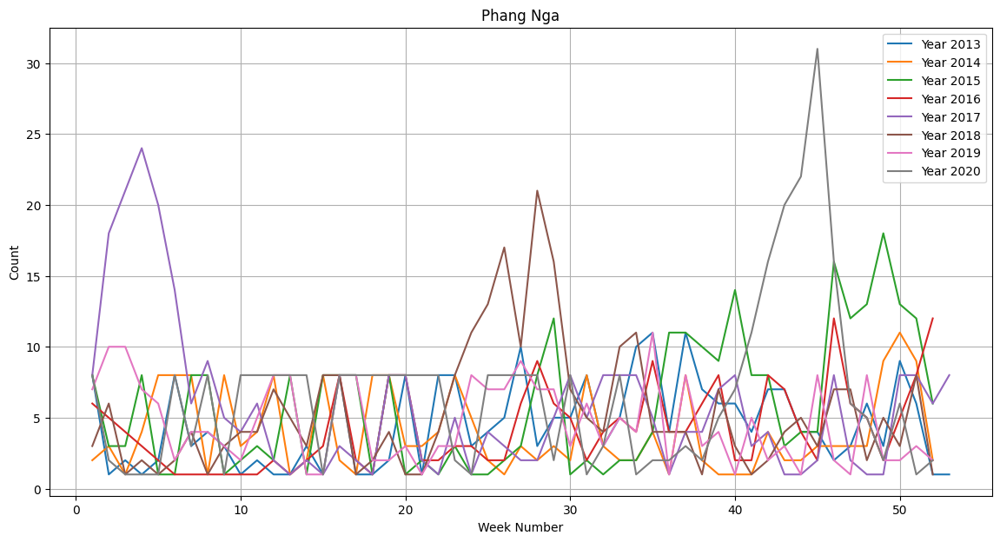


RMSE: 2.3182215624317744


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetFastAI,-2.201387,-2.201387,-1.087039,root_mean_squared_error,0.017440,0.007552,0.606553,0.017440,0.007552,0.606553,1,True,7
1,WeightedEnsemble_L2,-2.318222,-2.318222,-0.988756,root_mean_squared_error,0.061929,0.021746,2.828967,0.005922,0.000510,0.016088,2,True,11
2,NeuralNetTorch,-2.945450,-2.945450,-1.371944,root_mean_squared_error,0.014438,0.008960,1.939068,0.014438,0.008960,1.939068,1,True,9
3,ExtraTreesMSE,-2.980430,-2.980430,-1.796448,root_mean_squared_error,0.090923,0.076466,0.653167,0.090923,0.076466,0.653167,1,True,6
4,RandomForestMSE,-3.054749,-3.054749,-1.745974,root_mean_squared_error,0.087631,0.079608,1.057525,0.087631,0.079608,1.057525,1,True,5
5,LightGBMLarge,-3.429710,-3.429710,-2.173244,root_mean_squared_error,0.013244,0.002690,0.442368,0.013244,0.002690,0.442368,1,True,10
6,XGBoost,-3.603404,-3.603404,-1.634782,root_mean_squared_error,0.024129,0.004725,0.267257,0.024129,0.004725,0.267257,1,True,8
7,LightGBM,-3.790327,-3.790327,-2.173180,root_mean_squared_error,0.004036,0.001786,0.544832,0.004036,0.001786,0.544832,1,True,4
8,LightGBMXT,-3.887315,-3.887315,-2.300743,root_mean_squared_error,0.012080,0.009690,0.817965,0.012080,0.009690,0.817965,1,True,3
9,KNeighborsUnif,-4.598160,-4.598160,-3.915941,root_mean_squared_error,0.014458,0.028610,0.008378,0.014458,0.028610,0.008378,1,True,1


In [71]:
province = "Phang Nga"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Phang_Nga = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Phang_Nga.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Phang_Nga.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Phuket

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192737"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.59 GB / 12.67 GB (83.5%)
Disk Space Avail:   75.14 GB / 107.72 GB (69.8%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.19386
[2000]	valid_set's rmse: 1.95989
[3000]	valid_set's rmse: 1.89874
[4000]	valid_set's rmse: 1.89762


	-1.8886	 = Validation score   (-root_mean_squared_error)
	1.0s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-2.1569	 = Validation score   (-root_mean_squared_error)
	0.48s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.4816	 = Validation score   (-root_mean_squared_error)
	0.71s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.4978	 = Validation score   (-root_mean_squared_error)
	0.6s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.8251	 = Validation score   (-root_mean_squared_error)
	0.63s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.4634	 = Validation score   (-root_mean_squared_error)
	0.32s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.3557	 = Validation score   (-root_mean_squared_error)
	2.13s	 = Training   runti

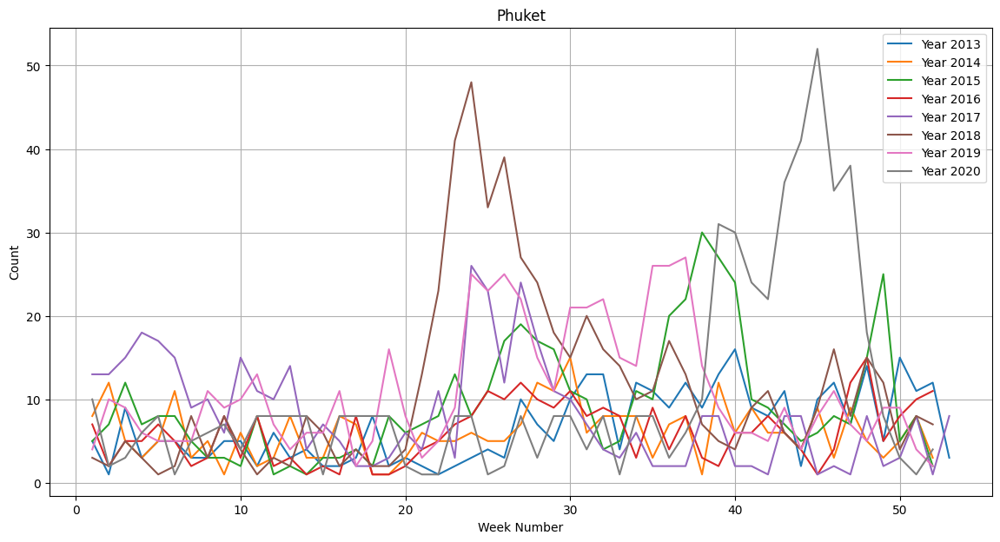


RMSE: 4.270444838739774


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetFastAI,-3.487380,-3.487380,-1.825072,root_mean_squared_error,0.022301,0.010325,0.634061,0.022301,0.010325,0.634061,1,True,7
1,NeuralNetTorch,-3.814691,-3.814691,-1.355718,root_mean_squared_error,0.017720,0.014921,2.126100,0.017720,0.014921,2.126100,1,True,9
2,WeightedEnsemble_L2,-4.270445,-4.270445,-1.280237,root_mean_squared_error,0.113395,0.043000,3.794203,0.005191,0.000710,0.029579,2,True,11
3,ExtraTreesMSE,-4.381341,-4.381341,-2.497808,root_mean_squared_error,0.089859,0.090806,0.598359,0.089859,0.090806,0.598359,1,True,6
4,RandomForestMSE,-4.911262,-4.911262,-2.481592,root_mean_squared_error,0.084873,0.076072,0.714086,0.084873,0.076072,0.714086,1,True,5
5,LightGBMLarge,-5.050728,-5.050728,-2.300577,root_mean_squared_error,0.023612,0.004195,0.776967,0.023612,0.004195,0.776967,1,True,10
6,XGBoost,-5.258173,-5.258173,-2.463371,root_mean_squared_error,0.030318,0.005839,0.320025,0.030318,0.005839,0.320025,1,True,8
7,KNeighborsDist,-7.161057,-7.161057,-3.982935,root_mean_squared_error,0.014477,0.014574,0.009106,0.014477,0.014574,0.009106,1,True,2
8,KNeighborsUnif,-7.235224,-7.235224,-4.051626,root_mean_squared_error,0.015842,0.026257,0.009001,0.015842,0.026257,0.009001,1,True,1
9,LightGBM,-7.445889,-7.445889,-2.156925,root_mean_squared_error,0.012996,0.002378,0.482138,0.012996,0.002378,0.482138,1,True,4


In [72]:
province = "Phuket"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Phuket = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Phuket.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Phuket.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Surat Thani

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192746"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.62 GB / 12.67 GB (83.8%)
Disk Space Avail:   75.12 GB / 107.72 GB (69.7%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 15.0939
[2000]	valid_set's rmse: 14.5032
[3000]	valid_set's rmse: 14.1186
[4000]	valid_set's rmse: 14.0052
[5000]	valid_set's rmse: 13.8553
[6000]	valid_set's rmse: 13.7801
[7000]	valid_set's rmse: 13.7148
[8000]	valid_set's rmse: 13.6833
[9000]	valid_set's rmse: 13.6603
[10000]	valid_set's rmse: 13.6039


	-13.6017	 = Validation score   (-root_mean_squared_error)
	1.84s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's rmse: 14.0012
[2000]	valid_set's rmse: 12.7864
[3000]	valid_set's rmse: 12.6041
[4000]	valid_set's rmse: 12.4226
[5000]	valid_set's rmse: 12.1123
[6000]	valid_set's rmse: 11.9464
[7000]	valid_set's rmse: 11.8311
[8000]	valid_set's rmse: 11.7872
[9000]	valid_set's rmse: 11.7604
[10000]	valid_set's rmse: 11.7425


	-11.7424	 = Validation score   (-root_mean_squared_error)
	2.47s	 = Training   runtime
	0.12s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-10.0106	 = Validation score   (-root_mean_squared_error)
	0.8s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-10.1513	 = Validation score   (-root_mean_squared_error)
	0.75s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-8.6092	 = Validation score   (-root_mean_squared_error)
	0.69s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-10.4195	 = Validation score   (-root_mean_squared_error)
	0.66s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-9.883	 = Validation score   (-root_mean_squared_error)
	3.66s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-11.2777	 = Validation score   (-root_mean_squared_error)
	1.14s	 = Train

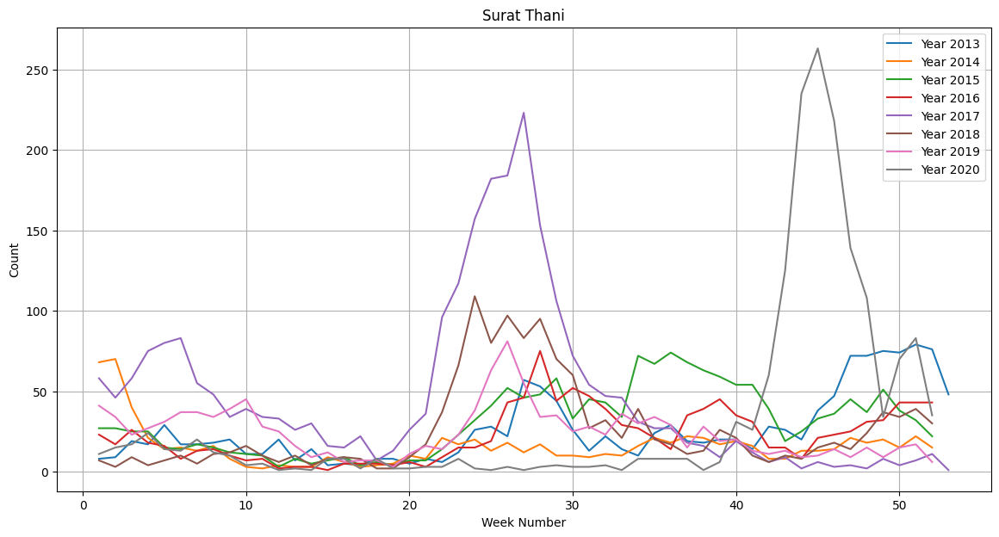


RMSE: 22.96867020437724


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetFastAI,-21.524550,-21.524550,-8.609178,root_mean_squared_error,0.018656,0.010340,0.687624,0.018656,0.010340,0.687624,1,True,7
1,WeightedEnsemble_L2,-22.968670,-22.968670,-8.495531,root_mean_squared_error,0.283690,0.142782,6.854093,0.004927,0.000721,0.028394,2,True,11
2,RandomForestMSE,-25.745074,-25.745074,-10.010627,root_mean_squared_error,0.092360,0.087492,0.800075,0.092360,0.087492,0.800075,1,True,5
3,NeuralNetTorch,-26.316647,-26.316647,-9.882955,root_mean_squared_error,0.013220,0.014241,3.663518,0.013220,0.014241,3.663518,1,True,9
4,ExtraTreesMSE,-27.220223,-27.220223,-10.151344,root_mean_squared_error,0.099070,0.077304,0.752208,0.099070,0.077304,0.752208,1,True,6
5,KNeighborsDist,-28.119723,-28.119723,-12.629650,root_mean_squared_error,0.014593,0.015047,0.008065,0.014593,0.015047,0.008065,1,True,2
6,LightGBMLarge,-29.782355,-29.782355,-11.277720,root_mean_squared_error,0.025679,0.008035,1.138331,0.025679,0.008035,1.138331,1,True,10
7,KNeighborsUnif,-30.350771,-30.350771,-13.212259,root_mean_squared_error,0.019892,0.026714,0.007432,0.019892,0.026714,0.007432,1,True,1
8,XGBoost,-36.187217,-36.187217,-10.419451,root_mean_squared_error,0.028902,0.007936,0.658584,0.028902,0.007936,0.658584,1,True,8
9,LightGBM,-46.365104,-46.365104,-11.742413,root_mean_squared_error,0.246887,0.117481,2.474557,0.246887,0.117481,2.474557,1,True,4


In [73]:
province = "Surat Thani"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Surat_Thani = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Surat_Thani.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Surat_Thani.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Ranong

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192802"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.63 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.09 GB / 107.72 GB (69.7%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.75766
[2000]	valid_set's rmse: 2.66942
[3000]	valid_set's rmse: 2.62828
[4000]	valid_set's rmse: 2.58565
[5000]	valid_set's rmse: 2.55558
[6000]	valid_set's rmse: 2.54035
[7000]	valid_set's rmse: 2.52328
[8000]	valid_set's rmse: 2.50881
[9000]	valid_set's rmse: 2.50374
[10000]	valid_set's rmse: 2.49589


	-2.4959	 = Validation score   (-root_mean_squared_error)
	1.91s	 = Training   runtime
	0.05s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's rmse: 2.46927


	-2.4554	 = Validation score   (-root_mean_squared_error)
	0.59s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.2455	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.0936	 = Validation score   (-root_mean_squared_error)
	0.6s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.701	 = Validation score   (-root_mean_squared_error)
	0.65s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-1.991	 = Validation score   (-root_mean_squared_error)
	0.25s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.31	 = Validation score   (-root_mean_squared_error)
	1.77s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-1.9625	 = Validation score   (-root_mean_squared_error)
	0.68s	 = Training   run

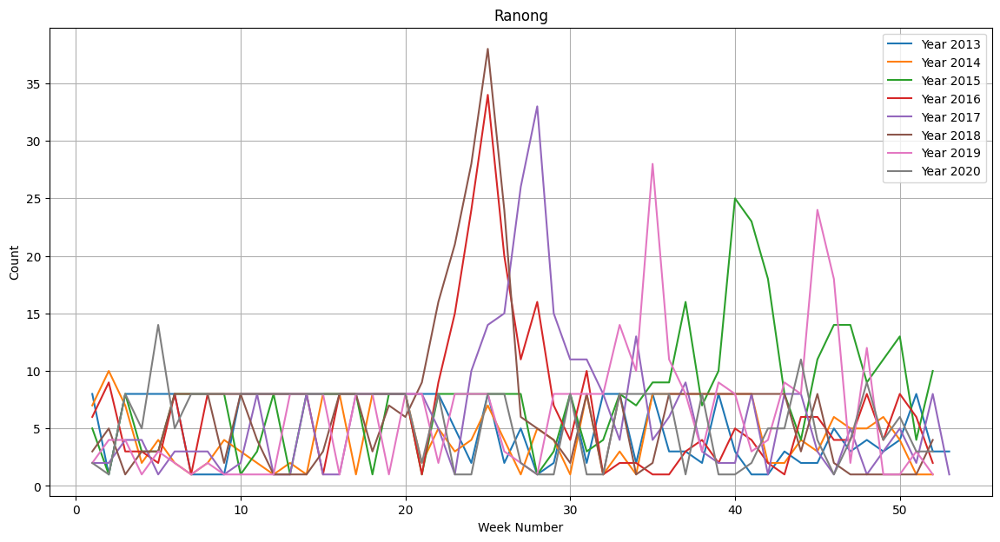


RMSE: 1.04100102713792


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-1.041001,-1.041001,-1.585649,root_mean_squared_error,0.097364,0.020863,1.595659,0.006183,0.000643,0.021381,2,True,11
1,NeuralNetFastAI,-1.201898,-1.201898,-1.700957,root_mean_squared_error,0.019896,0.007992,0.646036,0.019896,0.007992,0.646036,1,True,7
2,LightGBMXT,-1.336373,-1.336373,-2.495888,root_mean_squared_error,0.142636,0.052398,1.911254,0.142636,0.052398,1.911254,1,True,3
3,ExtraTreesMSE,-1.361739,-1.361739,-2.093563,root_mean_squared_error,0.098470,0.075840,0.595250,0.098470,0.075840,0.595250,1,True,6
4,RandomForestMSE,-1.438597,-1.438597,-2.245466,root_mean_squared_error,0.097828,0.077111,0.637515,0.097828,0.077111,0.637515,1,True,5
5,NeuralNetTorch,-1.462260,-1.462260,-2.310014,root_mean_squared_error,0.015053,0.008240,1.773660,0.015053,0.008240,1.773660,1,True,9
6,XGBoost,-1.477302,-1.477302,-1.991012,root_mean_squared_error,0.024384,0.003876,0.245246,0.024384,0.003876,0.245246,1,True,8
7,LightGBMLarge,-1.625936,-1.625936,-1.962481,root_mean_squared_error,0.046901,0.008353,0.682996,0.046901,0.008353,0.682996,1,True,10
8,LightGBM,-1.629948,-1.629948,-2.455392,root_mean_squared_error,0.031089,0.009198,0.590097,0.031089,0.009198,0.590097,1,True,4
9,KNeighborsDist,-3.222645,-3.222645,-3.354972,root_mean_squared_error,0.013997,0.015173,0.012999,0.013997,0.015173,0.012999,1,True,2


In [74]:
province = "Ranong"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Ranong = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Ranong.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Ranong.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Chumphon

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192811"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.64 GB / 12.67 GB (83.9%)
Disk Space Avail:   75.07 GB / 107.72 GB (69.7%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.95252
[2000]	valid_set's rmse: 2.78407


	-2.7752	 = Validation score   (-root_mean_squared_error)
	1.08s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-2.3033	 = Validation score   (-root_mean_squared_error)
	0.52s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.11	 = Validation score   (-root_mean_squared_error)
	0.77s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.1059	 = Validation score   (-root_mean_squared_error)
	0.58s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.3326	 = Validation score   (-root_mean_squared_error)
	0.67s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-2.8523	 = Validation score   (-root_mean_squared_error)
	0.34s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.4523	 = Validation score   (-root_mean_squared_error)
	4.27s	 = Training   runti

[1000]	valid_set's rmse: 3.18802


	-3.1859	 = Validation score   (-root_mean_squared_error)
	2.6s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.95, 'LightGBM': 0.05}
	-1.4491	 = Validation score   (-root_mean_squared_error)
	0.05s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 12.47s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 3097.2 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192811")


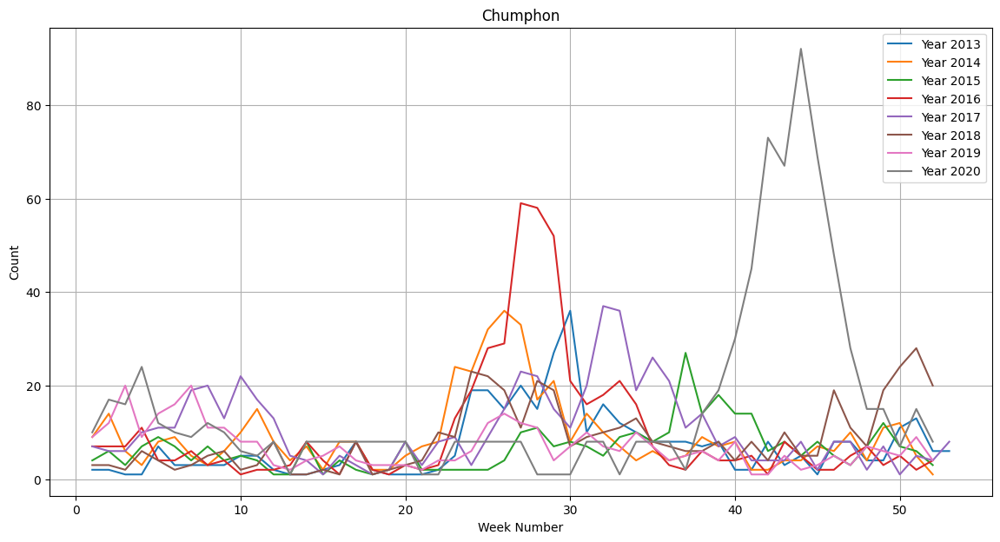


RMSE: 9.531652581144447


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetFastAI,-6.696532,-6.696532,-2.332624,root_mean_squared_error,0.067877,0.009217,0.668576,0.067877,0.009217,0.668576,1,True,7
1,NeuralNetTorch,-9.272548,-9.272548,-1.452259,root_mean_squared_error,0.069372,0.020206,4.268993,0.069372,0.020206,4.268993,1,True,9
2,WeightedEnsemble_L2,-9.531653,-9.531653,-1.449093,root_mean_squared_error,0.109656,0.023893,4.838492,0.014968,0.000776,0.052380,2,True,11
3,ExtraTreesMSE,-10.232375,-10.232375,-3.105903,root_mean_squared_error,0.239777,0.077373,0.581417,0.239777,0.077373,0.581417,1,True,6
4,RandomForestMSE,-10.655931,-10.655931,-3.109963,root_mean_squared_error,0.172924,0.075658,0.766244,0.172924,0.075658,0.766244,1,True,5
5,KNeighborsDist,-12.204049,-12.204049,-4.616251,root_mean_squared_error,0.014483,0.014832,0.011897,0.014483,0.014832,0.011897,1,True,2
6,KNeighborsUnif,-12.730430,-12.730430,-4.665515,root_mean_squared_error,0.019909,0.013580,0.012823,0.019909,0.013580,0.012823,1,True,1
7,LightGBMLarge,-13.816529,-13.816529,-3.185877,root_mean_squared_error,0.289059,0.023517,2.598492,0.289059,0.023517,2.598492,1,True,10
8,XGBoost,-14.190886,-14.190886,-2.852315,root_mean_squared_error,0.091211,0.010066,0.341483,0.091211,0.010066,0.341483,1,True,8
9,LightGBM,-16.104297,-16.104297,-2.303302,root_mean_squared_error,0.025316,0.002911,0.517119,0.025316,0.002911,0.517119,1,True,4


In [75]:
province = "Chumphon"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Chumphon = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Chumphon.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Chumphon.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Songkhla

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192827"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.51 GB / 12.67 GB (82.9%)
Disk Space Avail:   75.05 GB / 107.72 GB (69.7%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 9.2071
[2000]	valid_set's rmse: 8.7122
[3000]	valid_set's rmse: 8.5638
[4000]	valid_set's rmse: 8.44892
[5000]	valid_set's rmse: 8.41282
[6000]	valid_set's rmse: 8.41
[7000]	valid_set's rmse: 8.41622
[8000]	valid_set's rmse: 8.41743


	-8.3876	 = Validation score   (-root_mean_squared_error)
	3.09s	 = Training   runtime
	0.04s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's rmse: 8.16975


	-8.0731	 = Validation score   (-root_mean_squared_error)
	0.63s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-6.8926	 = Validation score   (-root_mean_squared_error)
	0.68s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-7.4275	 = Validation score   (-root_mean_squared_error)
	0.61s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-4.6614	 = Validation score   (-root_mean_squared_error)
	0.63s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-6.3112	 = Validation score   (-root_mean_squared_error)
	0.86s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-5.8409	 = Validation score   (-root_mean_squared_error)
	8.83s	 = Training   runtime
	0.03s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-7.1663	 = Validation score   (-root_mean_squared_error)
	1.45s	 = Training

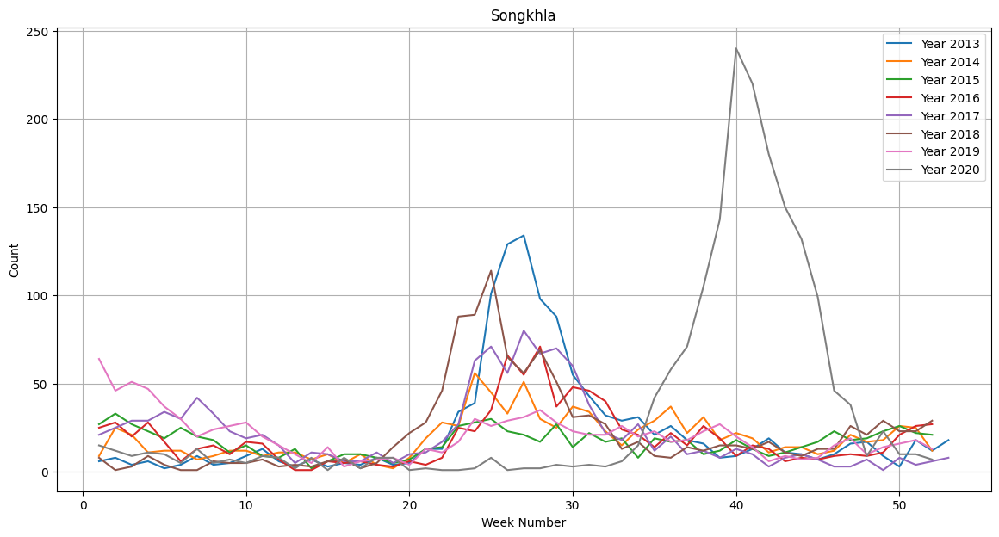


RMSE: 26.12875152596002


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetFastAI,-24.121839,-24.121839,-4.661413,root_mean_squared_error,0.019554,0.008236,0.629096,0.019554,0.008236,0.629096,1,True,7
1,WeightedEnsemble_L2,-26.128752,-26.128752,-4.526341,root_mean_squared_error,0.057703,0.017101,1.521338,0.005215,0.000720,0.029602,2,True,11
2,NeuralNetTorch,-30.830560,-30.830560,-5.840873,root_mean_squared_error,0.017072,0.026035,8.828105,0.017072,0.026035,8.828105,1,True,9
3,RandomForestMSE,-34.710653,-34.710653,-6.892580,root_mean_squared_error,0.090574,0.077350,0.678897,0.090574,0.077350,0.678897,1,True,5
4,ExtraTreesMSE,-36.958199,-36.958199,-7.427460,root_mean_squared_error,0.086645,0.087055,0.609242,0.086645,0.087055,0.609242,1,True,6
5,XGBoost,-36.976168,-36.976168,-6.311212,root_mean_squared_error,0.032934,0.008145,0.862641,0.032934,0.008145,0.862641,1,True,8
6,KNeighborsDist,-37.438564,-37.438564,-9.794076,root_mean_squared_error,0.018055,0.027837,0.019976,0.018055,0.027837,0.019976,1,True,2
7,KNeighborsUnif,-37.946349,-37.946349,-9.912019,root_mean_squared_error,0.014896,0.052400,0.014204,0.014896,0.052400,0.014204,1,True,1
8,LightGBMLarge,-41.067711,-41.067711,-7.166345,root_mean_squared_error,0.053550,0.014036,1.454303,0.053550,0.014036,1.454303,1,True,10
9,LightGBM,-44.606435,-44.606435,-8.073092,root_mean_squared_error,0.051517,0.010308,0.630050,0.051517,0.010308,0.630050,1,True,4


In [76]:
province = "Songkhla"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Songkhla = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Songkhla.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Songkhla.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Satun

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192847"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.41 GB / 12.67 GB (82.1%)
Disk Space Avail:   75.03 GB / 107.72 GB (69.7%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 1.2806


	-1.265	 = Validation score   (-root_mean_squared_error)
	0.81s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBM ...
	-1.0702	 = Validation score   (-root_mean_squared_error)
	0.46s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-1.0574	 = Validation score   (-root_mean_squared_error)
	1.09s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-1.1364	 = Validation score   (-root_mean_squared_error)
	0.94s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.0176	 = Validation score   (-root_mean_squared_error)
	0.97s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-0.9084	 = Validation score   (-root_mean_squared_error)
	0.39s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.2681	 = Validation score   (-root_mean_squared_error)
	4.65s	 = Training   runt

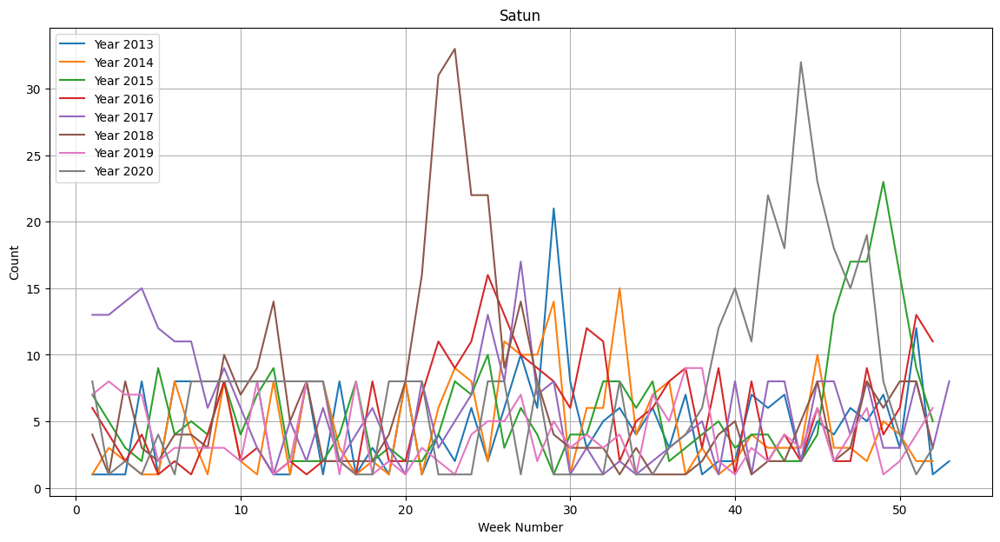


RMSE: 2.5063877949300797


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetFastAI,-2.203222,-2.203222,-1.017591,root_mean_squared_error,0.020063,0.011798,0.970296,0.020063,0.011798,0.970296,1,True,7
1,ExtraTreesMSE,-2.457508,-2.457508,-1.136415,root_mean_squared_error,0.112203,0.066246,0.943145,0.112203,0.066246,0.943145,1,True,6
2,WeightedEnsemble_L2,-2.506388,-2.506388,-0.718022,root_mean_squared_error,0.059671,0.022020,1.848874,0.005270,0.000715,0.024086,2,True,11
3,LightGBMLarge,-2.626207,-2.626207,-1.342437,root_mean_squared_error,0.013700,0.002944,0.643692,0.013700,0.002944,0.643692,1,True,10
4,RandomForestMSE,-2.709613,-2.709613,-1.057376,root_mean_squared_error,0.083215,0.066373,1.088068,0.083215,0.066373,1.088068,1,True,5
5,XGBoost,-2.923231,-2.923231,-0.908416,root_mean_squared_error,0.025440,0.006887,0.390877,0.025440,0.006887,0.390877,1,True,8
6,LightGBM,-3.410894,-3.410894,-1.070244,root_mean_squared_error,0.008898,0.002620,0.463615,0.008898,0.002620,0.463615,1,True,4
7,NeuralNetTorch,-3.532672,-3.532672,-2.268085,root_mean_squared_error,0.015254,0.014555,4.646349,0.015254,0.014555,4.646349,1,True,9
8,LightGBMXT,-3.695848,-3.695848,-1.265050,root_mean_squared_error,0.025702,0.009313,0.812948,0.025702,0.009313,0.812948,1,True,3
9,KNeighborsDist,-4.626284,-4.626284,-2.652931,root_mean_squared_error,0.014269,0.013804,0.009133,0.014269,0.013804,0.009133,1,True,2


In [77]:
province = "Satun"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Satun = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Satun.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Satun.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Trang

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192859"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.40 GB / 12.67 GB (82.0%)
Disk Space Avail:   75.01 GB / 107.72 GB (69.6%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

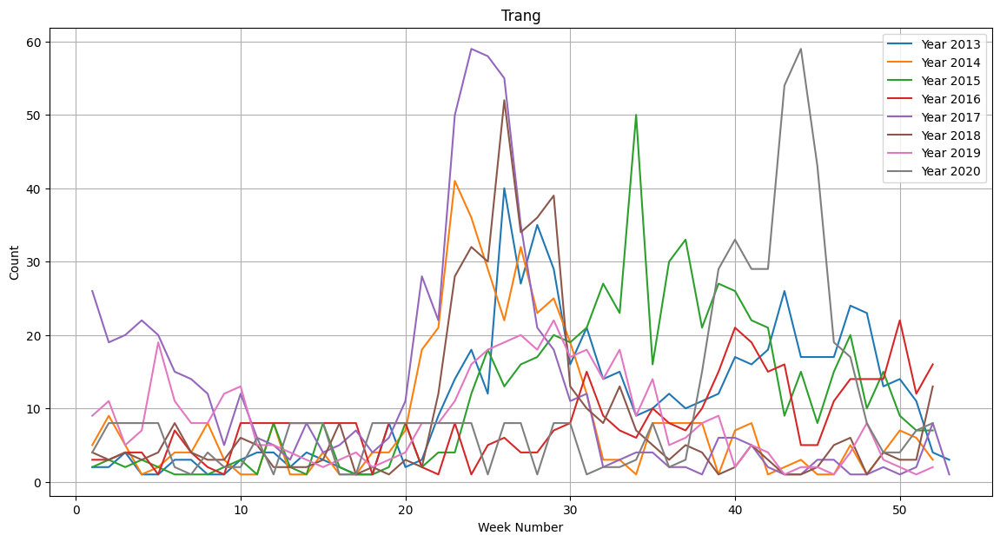


RMSE: 4.011659615827312


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,-4.011660,-4.011660,-1.618179,root_mean_squared_error,0.306260,0.133362,5.768146,0.012074,0.000658,0.022836,2,True,11
1,RandomForestMSE,-4.086084,-4.086084,-2.514471,root_mean_squared_error,0.127811,0.083572,1.153706,0.127811,0.083572,1.153706,1,True,5
2,NeuralNetFastAI,-4.135808,-4.135808,-2.342301,root_mean_squared_error,0.040910,0.011746,0.909111,0.040910,0.011746,0.909111,1,True,7
3,ExtraTreesMSE,-4.168407,-4.168407,-2.518853,root_mean_squared_error,0.125768,0.066516,0.969940,0.125768,0.066516,0.969940,1,True,6
4,XGBoost,-4.648704,-4.648704,-2.467512,root_mean_squared_error,0.075479,0.007838,0.568131,0.075479,0.007838,0.568131,1,True,8
5,NeuralNetTorch,-5.297950,-5.297950,-2.063285,root_mean_squared_error,0.049985,0.029547,3.114361,0.049985,0.029547,3.114361,1,True,9
6,LightGBMLarge,-5.885229,-5.885229,-2.976032,root_mean_squared_error,0.014895,0.005036,0.959682,0.014895,0.005036,0.959682,1,True,10
7,LightGBM,-6.587328,-6.587328,-2.671751,root_mean_squared_error,0.006608,0.001390,0.511842,0.006608,0.001390,0.511842,1,True,4
8,KNeighborsDist,-6.775560,-6.775560,-3.191784,root_mean_squared_error,0.024463,0.017876,0.009493,0.024463,0.017876,0.009493,1,True,2
9,KNeighborsUnif,-6.790548,-6.790548,-3.165694,root_mean_squared_error,0.014454,0.052037,0.011971,0.014454,0.052037,0.011971,1,True,1


In [78]:
province = "Trang"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Trang = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Trang.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Trang.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Phatthalung

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192911"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.39 GB / 12.67 GB (82.0%)
Disk Space Avail:   75.00 GB / 107.72 GB (69.6%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 4.4547
[2000]	valid_set's rmse: 4.32055


	-4.3012	 = Validation score   (-root_mean_squared_error)
	1.09s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: LightGBM ...
	-2.958	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-3.6501	 = Validation score   (-root_mean_squared_error)
	1.15s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-3.8677	 = Validation score   (-root_mean_squared_error)
	1.01s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-4.1314	 = Validation score   (-root_mean_squared_error)
	0.92s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-3.4628	 = Validation score   (-root_mean_squared_error)
	0.46s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-2.9892	 = Validation score   (-root_mean_squared_error)
	6.7s	 = Training   runt

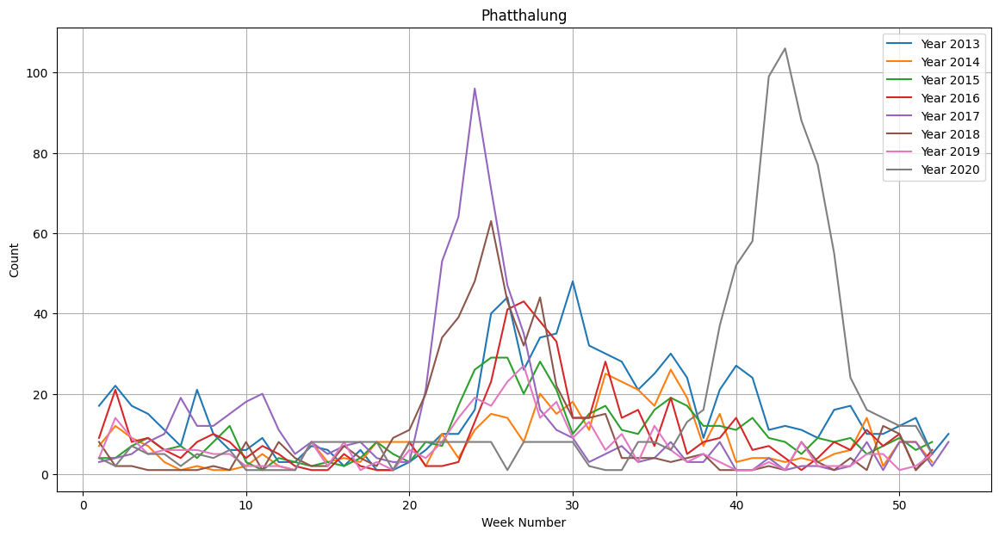


RMSE: 14.960786348737983


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetFastAI,-7.431492,-7.431492,-4.131399,root_mean_squared_error,0.031599,0.014369,0.922627,0.031599,0.014369,0.922627,1,True,7
1,NeuralNetTorch,-11.386142,-11.386142,-2.989219,root_mean_squared_error,0.017149,0.019489,6.697233,0.017149,0.019489,6.697233,1,True,9
2,ExtraTreesMSE,-11.795449,-11.795449,-3.867743,root_mean_squared_error,0.093653,0.066244,1.006680,0.093653,0.066244,1.006680,1,True,6
3,KNeighborsDist,-11.909544,-11.909544,-5.769357,root_mean_squared_error,0.014411,0.013502,0.011323,0.014411,0.013502,0.011323,1,True,2
4,RandomForestMSE,-12.205001,-12.205001,-3.650125,root_mean_squared_error,0.113687,0.066293,1.147863,0.113687,0.066293,1.147863,1,True,5
5,KNeighborsUnif,-12.554190,-12.554190,-5.813823,root_mean_squared_error,0.015254,0.025821,0.024254,0.015254,0.025821,0.024254,1,True,1
6,LightGBMLarge,-14.686732,-14.686732,-3.929202,root_mean_squared_error,0.009051,0.002571,1.080724,0.009051,0.002571,1.080724,1,True,10
7,WeightedEnsemble_L2,-14.960786,-14.960786,-2.658580,root_mean_squared_error,0.075176,0.032156,7.826715,0.004895,0.000974,0.027089,2,True,11
8,XGBoost,-15.576419,-15.576419,-3.462779,root_mean_squared_error,0.029286,0.006049,0.460093,0.029286,0.006049,0.460093,1,True,8
9,LightGBM,-19.174871,-19.174871,-2.957976,root_mean_squared_error,0.023846,0.005645,0.642300,0.023846,0.005645,0.642300,1,True,4


In [79]:
province = "Phatthalung"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Phatthalung = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Phatthalung.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Phatthalung.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Pattani

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192927"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.37 GB / 12.67 GB (81.8%)
Disk Space Avail:   74.98 GB / 107.72 GB (69.6%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 1.80972


	-1.7482	 = Validation score   (-root_mean_squared_error)
	0.44s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.0365	 = Validation score   (-root_mean_squared_error)
	1.1s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-1.9184	 = Validation score   (-root_mean_squared_error)
	0.92s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-1.3839	 = Validation score   (-root_mean_squared_error)
	0.96s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: XGBoost ...
	-1.7463	 = Validation score   (-root_mean_squared_error)
	0.36s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.5083	 = Validation score   (-root_mean_squared_error)
	2.59s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: LightGBMLarge ...
	-1.765	 = Validation score   (-root_mean_squared_error)
	1.28s	 = Training   

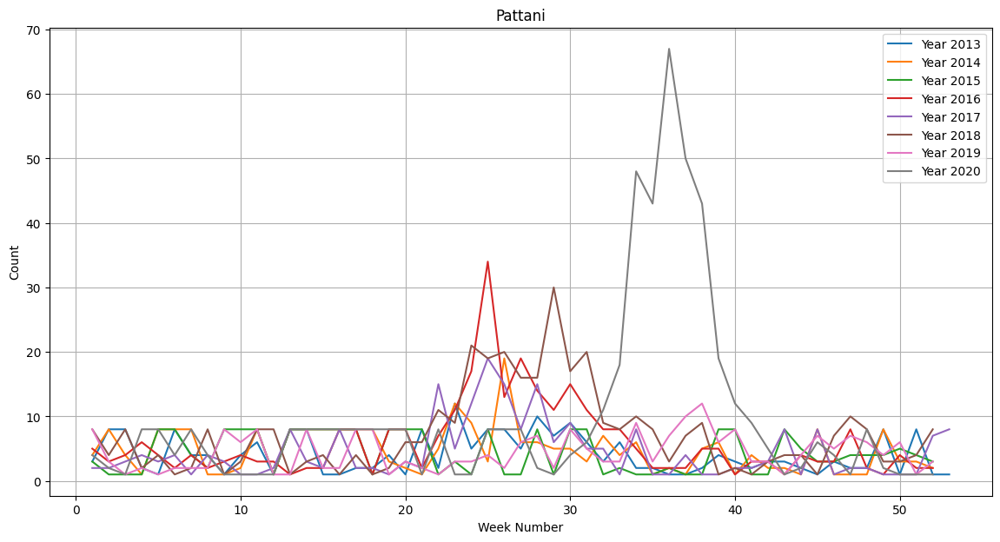


RMSE: 7.754023325621289


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetFastAI,-5.930839,-5.930839,-1.383863,root_mean_squared_error,0.034535,0.012069,0.958646,0.034535,0.012069,0.958646,1,True,7
1,WeightedEnsemble_L2,-7.754023,-7.754023,-1.197162,root_mean_squared_error,0.137578,0.032470,4.407537,0.005755,0.001263,0.054232,2,True,11
2,NeuralNetTorch,-9.468360,-9.468360,-1.508273,root_mean_squared_error,0.033849,0.012229,2.587140,0.033849,0.012229,2.587140,1,True,9
3,LightGBMLarge,-9.917407,-9.917407,-1.765042,root_mean_squared_error,0.064100,0.008191,1.284992,0.064100,0.008191,1.284992,1,True,10
4,RandomForestMSE,-10.036893,-10.036893,-2.036479,root_mean_squared_error,0.151854,0.066447,1.098836,0.151854,0.066447,1.098836,1,True,5
5,ExtraTreesMSE,-10.060700,-10.060700,-1.918364,root_mean_squared_error,0.127331,0.076082,0.921581,0.127331,0.076082,0.921581,1,True,6
6,LightGBM,-10.847893,-10.847893,-1.748151,root_mean_squared_error,0.016830,0.001880,0.443737,0.016830,0.001880,0.443737,1,True,4
7,KNeighborsDist,-10.940439,-10.940439,-3.154062,root_mean_squared_error,0.017050,0.013590,0.009995,0.017050,0.013590,0.009995,1,True,2
8,KNeighborsUnif,-10.968276,-10.968276,-3.299058,root_mean_squared_error,0.033317,0.019388,0.023346,0.033317,0.019388,0.023346,1,True,1
9,LightGBMXT,-11.009315,-11.009315,-1.803582,root_mean_squared_error,0.035819,0.005336,0.633250,0.035819,0.005336,0.633250,1,True,3


In [80]:
province = "Pattani"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Pattani = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Pattani.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Pattani.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Yala


No path specified. Models will be saved in: "AutogluonModels/ag-20240803_192938"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.35 GB / 12.67 GB (81.7%)
Disk Space Avail:   74.97 GB / 107.72 GB (69.6%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 3.78101
[2000]	valid_set's rmse: 3.70707
[3000]	valid_set's rmse: 3.6145
[4000]	valid_set's rmse: 3.53599
[5000]	valid_set's rmse: 3.48823
[6000]	valid_set's rmse: 3.47421
[7000]	valid_set's rmse: 3.4413
[8000]	valid_set's rmse: 3.438
[9000]	valid_set's rmse: 3.41705
[10000]	valid_set's rmse: 3.40761


	-3.4064	 = Validation score   (-root_mean_squared_error)
	3.22s	 = Training   runtime
	0.06s	 = Validation runtime
Fitting model: LightGBM ...
	-3.3093	 = Validation score   (-root_mean_squared_error)
	0.56s	 = Training   runtime
	0.0s	 = Validation runtime
Fitting model: RandomForestMSE ...
	-2.2362	 = Validation score   (-root_mean_squared_error)
	1.32s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
		
Fitting model: ExtraTreesMSE ...
	-2.8229	 = Validation score   (-root_mean_squared_error)
	1.06s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	-2.7205	 = Validation score   (-root_mean_squared_error)
	1.72s	 = Training   runtime
	0.02s	 = Validation runtime
Fitting model: XGBoost ...
	-2.2757	 = Validation score   (-root_mean_squared_error)
	0.64s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: NeuralNetTorch ...
	-1.9714	 = Validation score   (-root_mean_squared_error)
	5.42s	 = Training   run

[1000]	valid_set's rmse: 1.9881


	-1.974	 = Validation score   (-root_mean_squared_error)
	2.07s	 = Training   runtime
	0.03s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetTorch': 0.368, 'LightGBMLarge': 0.368, 'XGBoost': 0.158, 'RandomForestMSE': 0.105}
	-1.7088	 = Validation score   (-root_mean_squared_error)
	0.05s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 18.87s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 639.4 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_192938")


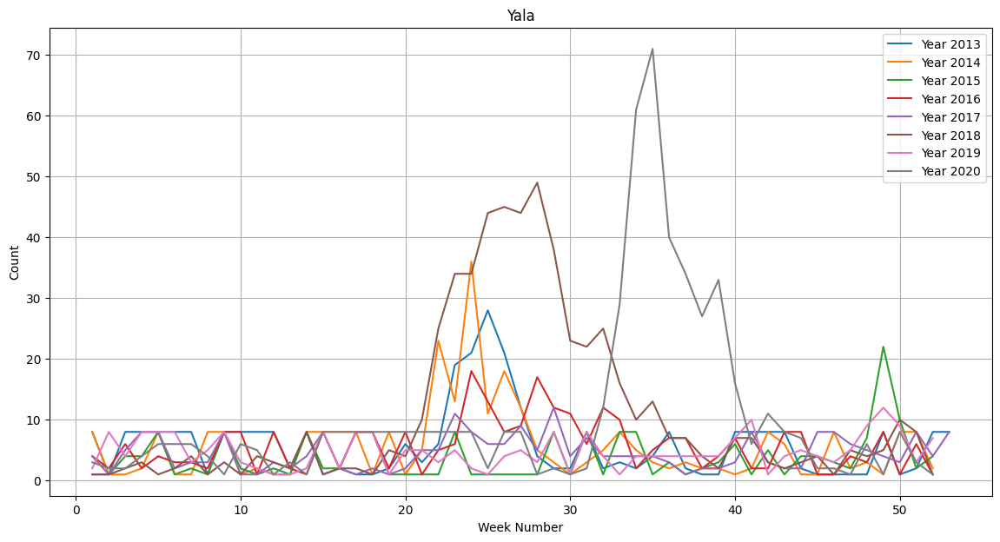


RMSE: 6.788124032651864


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetFastAI,-4.535075,-4.535075,-2.720518,root_mean_squared_error,0.054500,0.019179,1.720806,0.054500,0.019179,1.720806,1,True,7
1,NeuralNetTorch,-5.980687,-5.980687,-1.971432,root_mean_squared_error,0.027856,0.012163,5.421221,0.027856,0.012163,5.421221,1,True,9
2,WeightedEnsemble_L2,-6.788124,-6.788124,-1.708772,root_mean_squared_error,0.501066,0.115729,9.493123,0.013963,0.000691,0.048837,2,True,11
3,RandomForestMSE,-6.944698,-6.944698,-2.236248,root_mean_squared_error,0.166279,0.066718,1.316867,0.166279,0.066718,1.316867,1,True,5
4,ExtraTreesMSE,-6.986776,-6.986776,-2.822890,root_mean_squared_error,0.133970,0.068528,1.063203,0.133970,0.068528,1.063203,1,True,6
5,KNeighborsDist,-7.300635,-7.300635,-4.161847,root_mean_squared_error,0.026257,0.048740,0.019873,0.026257,0.048740,0.019873,1,True,2
6,KNeighborsUnif,-7.413605,-7.413605,-4.347972,root_mean_squared_error,0.039910,0.043284,0.023151,0.039910,0.043284,0.023151,1,True,1
7,XGBoost,-7.778202,-7.778202,-2.275688,root_mean_squared_error,0.064398,0.007223,0.635113,0.064398,0.007223,0.635113,1,True,8
8,LightGBMLarge,-8.272566,-8.272566,-1.974009,root_mean_squared_error,0.228570,0.028934,2.071085,0.228570,0.028934,2.071085,1,True,10
9,LightGBM,-10.057595,-10.057595,-3.309271,root_mean_squared_error,0.027702,0.004254,0.561838,0.027702,0.004254,0.561838,1,True,4


In [81]:
province = "Yala"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Yala = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Yala.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Yala.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<br>

## Narathiwat

No path specified. Models will be saved in: "AutogluonModels/ag-20240803_193000"
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.1.1
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       10.38 GB / 12.67 GB (81.9%)
Disk Space Avail:   74.95 GB / 107.72 GB (69.6%)
No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : F

[1000]	valid_set's rmse: 2.1787
[2000]	valid_set's rmse: 2.1274
[3000]	valid_set's rmse: 2.11127
[4000]	valid_set's rmse: 2.10791
[5000]	valid_set's rmse: 2.10698
[6000]	valid_set's rmse: 2.10682
[7000]	valid_set's rmse: 2.10678
[8000]	valid_set's rmse: 2.10677
[9000]	valid_set's rmse: 2.10677
[10000]	valid_set's rmse: 2.10677


	-2.1068	 = Validation score   (-root_mean_squared_error)
	13.51s	 = Training   runtime
	0.33s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	Ensemble Weights: {'NeuralNetFastAI': 0.52, 'LightGBMLarge': 0.36, 'NeuralNetTorch': 0.12}
	-1.605	 = Validation score   (-root_mean_squared_error)
	0.03s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 27.14s ... Best model: WeightedEnsemble_L2 | Estimated inference throughput: 194.0 rows/s (74 batch size)
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("AutogluonModels/ag-20240803_193000")


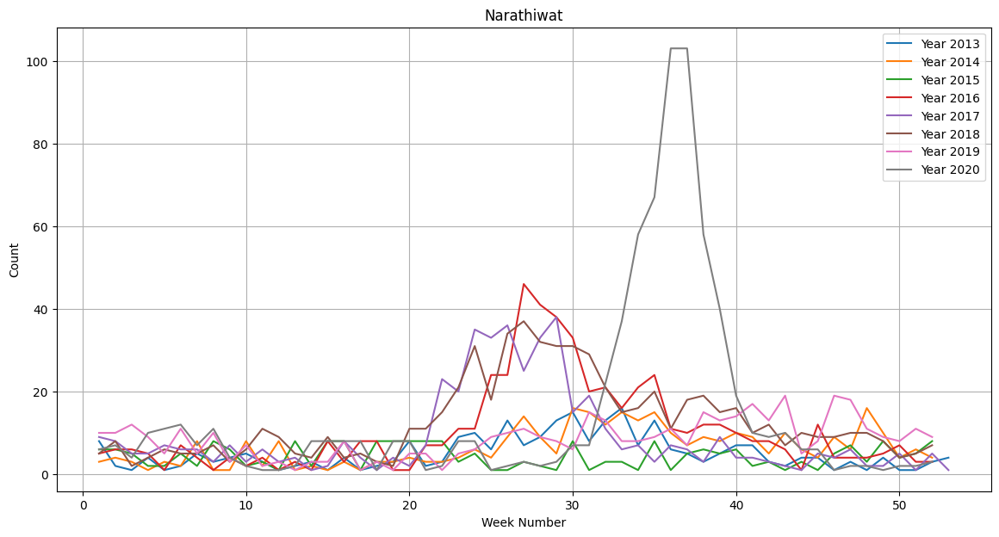


RMSE: 14.199607815750165


,model,score_test,root_mean_squared_error,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,NeuralNetFastAI,-12.165473,-12.165473,-1.932115,root_mean_squared_error,0.023598,0.037170,1.809080,0.023598,0.037170,1.809080,1,True,7
1,NeuralNetTorch,-13.754377,-13.754377,-2.080033,root_mean_squared_error,0.016433,0.011704,2.578169,0.016433,0.011704,2.578169,1,True,9
2,WeightedEnsemble_L2,-14.199608,-14.199608,-1.605001,root_mean_squared_error,1.062538,0.381386,17.924838,0.026577,0.000738,0.028086,2,True,11
3,KNeighborsDist,-15.770156,-15.770156,-3.995163,root_mean_squared_error,0.014353,0.034113,0.030894,0.014353,0.034113,0.030894,1,True,2
4,KNeighborsUnif,-15.851401,-15.851401,-4.122647,root_mean_squared_error,0.015199,0.020326,0.025059,0.015199,0.020326,0.025059,1,True,1
5,RandomForestMSE,-16.894216,-16.894216,-2.523612,root_mean_squared_error,0.084383,0.066716,1.165471,0.084383,0.066716,1.165471,1,True,5
6,ExtraTreesMSE,-16.940324,-16.940324,-2.603664,root_mean_squared_error,0.090335,0.095811,1.079894,0.090335,0.095811,1.079894,1,True,6
7,LightGBMLarge,-17.675194,-17.675194,-2.106771,root_mean_squared_error,0.995930,0.331774,13.509502,0.995930,0.331774,13.509502,1,True,10
8,LightGBM,-18.419769,-18.419769,-2.552731,root_mean_squared_error,0.002322,0.001312,0.474792,0.002322,0.001312,0.474792,1,True,4
9,LightGBMXT,-19.176165,-19.176165,-2.817700,root_mean_squared_error,0.002550,0.001420,0.703948,0.002550,0.001420,0.703948,1,True,3


In [82]:
province = "Narathiwat"
province_df = train_df[train_df['PROVINCE']==province]
train_years = [2013,2014,2015,2016,2017,2018,2019]
val_year    = [2020]
province_train_df = province_df[province_df['Year'].isin(train_years)].copy()
province_val_df = province_df[province_df['Year'].isin(val_year)].copy()
for lag in range(1, 4):
    province_train_df.loc[:, f'Lag_{lag}'] = province_train_df['Count'].shift(lag)
    province_val_df.loc[:, f'Lag_{lag}'] = province_val_df['Count'].shift(lag)
province_train_df.loc[:, 'Moving_Avg_3'] = province_train_df['Count'].rolling(window=3).mean()
province_val_df.loc[:, 'Moving_Avg_3'] = province_val_df['Count'].rolling(window=3).mean()
province_train_df.fillna(0, inplace=True)
province_val_df.fillna(0, inplace=True)
X_train = province_train_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_train = province_train_df['Count']
X_val = province_val_df[['Year', 'PROVINCE', 'Week_no', 'Lag_1', 'Lag_2', 'Lag_3', 'Moving_Avg_3']]
y_val = province_val_df['Count']
train_data = X_train.copy()
train_data['Count'] = y_train
val_data = X_val.copy()
val_data['Count'] = y_val
Narathiwat = TabularPredictor(label='Count', problem_type='regression', eval_metric='rmse').fit(train_data)
leaderboard = Narathiwat.leaderboard(val_data, extra_metrics=['rmse'])
y_pred = Narathiwat.predict(X_val)
rmse_value = rmse(y_val, y_pred)
pplot(pd.concat([province_train_df,province_val_df]),province)
print(f"\nRMSE: {rmse_value}")
pvrecord[province] = rmse_value
leaderboard

<hr><hr>

# Predict switching

In [83]:
# df = pd.read_csv("/content/sample_submission.csv")
# for idx,row in df[3:].iterrows():
#     data = test_df[test_df['_id']==row['_id']].drop(columns=['_id','Disease'])
#     # print(data.PROVINCE)
#     province = data.PROVINCE.iloc[0]
#     # print(province)
#     if province == "Bangkok":
#         df.at[idx,'Pred'] = Bangkok.predict(data)
#     elif province == "Samut Prakan":
#         df.at[idx,'Pred'] = Samut_Prakan.predict(data)
#     elif province == "Nonthaburi":
#         df.at[idx,'Pred'] = Nonthaburi.predict(data)
#     elif province == "Pathum Thani":
#         df.at[idx,'Pred'] = Pathum_Thani.predict(data)
#     elif province == "Phra Nakhon Si Ayutthaya":
#         df.at[idx,'Pred'] = Phra_Nakhon_Si_Ayutthaya.predict(data)
#     elif province == "Ang Thong":
#         df.at[idx,'Pred'] = Ang_Thong.predict(data)
#     elif province == "Lopburi":
#         df.at[idx,'Pred'] = Lopburi.predict(data)
#     elif province == "Sing Buri":
#         df.at[idx,'Pred'] = Sing_Buri.predict(data)
#     elif province == "Chainat":
#         df.at[idx,'Pred'] = Chainat.predict(data)
#     elif province == "Saraburi":
#         df.at[idx,'Pred'] = Saraburi.predict(data)
#     elif province == "Chonburi":
#         df.at[idx,'Pred'] = Chonburi.predict(data)
#     elif province == "Rayong":
#         df.at[idx,'Pred'] = Rayong.predict(data)
#     elif province == "Chanthaburi":
#         df.at[idx,'Pred'] = Chanthaburi.predict(data)
#     elif province == "Trat":
#         df.at[idx,'Pred'] = Trat.predict(data)
#     elif province == "Chachoengsao":
#         df.at[idx,'Pred'] = Chachoengsao.predict(data)
#     elif province == "Prachinburi":
#         df.at[idx,'Pred'] = Prachinburi.predict(data)
#     elif province == "Nakhon Nayok":
#         df.at[idx,'Pred'] = Nakhon_Nayok.predict(data)
#     elif province == "Sa Kaeo":
#         df.at[idx,'Pred'] = Sa_Kaeo.predict(data)
#     elif province == "Nakhon Ratchasima":
#         df.at[idx,'Pred'] = Nakhon_Ratchasima.predict(data)
#     elif province == "Buriram":
#         df.at[idx,'Pred'] = Buriram.predict(data)
#     elif province == "Surin":
#         df.at[idx,'Pred'] = Surin.predict(data)
#     elif province == "Sisaket":
#         df.at[idx,'Pred'] = Sisaket.predict(data)
#     elif province == "Ubon Ratchathani":
#         df.at[idx,'Pred'] = Ubon_Ratchathani.predict(data)
#     elif province == "Yasothon":
#         df.at[idx,'Pred'] = Yasothon.predict(data)
#     elif province == "Chaiyaphum":
#         df.at[idx,'Pred'] = Chaiyaphum.predict(data)
#     elif province == "Amnat Charoen":
#         df.at[idx,'Pred'] = Amnat_Charoen.predict(data)
#     elif province == "Bueng Kan":
#         df.at[idx,'Pred'] = Bueng_Kan.predict(data)
#     elif province == "Nong Bua Lamphu":
#         df.at[idx,'Pred'] = Nong_Bua_Lamphu.predict(data)
#     elif province == "Khon Kaen":
#         df.at[idx,'Pred'] = Khon_Kaen.predict(data)
#     elif province == "Udon Thani":
#         df.at[idx,'Pred'] = Udon_Thani.predict(data)
#     elif province == "Loei":
#         df.at[idx,'Pred'] = Loei.predict(data)
#     elif province == "Nong Khai":
#         df.at[idx,'Pred'] = Nong_Khai.predict(data)
#     elif province == "Maha Sarakham":
#         df.at[idx,'Pred'] = Maha_Sarakham.predict(data)
#     elif province == "Roi Et":
#         df.at[idx,'Pred'] = Roi_Et.predict(data)
#     elif province == "Kalasin":
#         df.at[idx,'Pred'] = Kalasin.predict(data)
#     elif province == "Sakon Nakhon":
#         df.at[idx,'Pred'] = Sakon_Nakhon.predict(data)
#     elif province == "Nakhon Phanom":
#         df.at[idx,'Pred'] = Nakhon_Phanom.predict(data)
#     elif province == "Mukdahan":
#         df.at[idx,'Pred'] = Mukdahan.predict(data)
#     elif province == "Chiang Mai":
#         df.at[idx,'Pred'] = Chiang_Mai.predict(data)
#     elif province == "Lamphun":
#         df.at[idx,'Pred'] = Lamphun.predict(data)
#     elif province == "Lampang":
#         df.at[idx,'Pred'] = Lampang.predict(data)
#     elif province == "Uttaradit":
#         df.at[idx,'Pred'] = Uttaradit.predict(data)
#     elif province == "Phrae":
#         df.at[idx,'Pred'] = Phrae.predict(data)
#     elif province == "Nan":
#         df.at[idx,'Pred'] = Nan.predict(data)
#     elif province == "Phayao":
#         df.at[idx,'Pred'] = Phayao.predict(data)
#     elif province == "Chiang Rai":
#         df.at[idx,'Pred'] = Chiang_Rai.predict(data)
#     elif province == "Mae Hong Son":
#         df.at[idx,'Pred'] = Mae_Hong_Son.predict(data)
#     elif province == "Nakhon Sawan":
#         df.at[idx,'Pred'] = Nakhon_Sawan.predict(data)
#     elif province == "Uthai Thani":
#         df.at[idx,'Pred'] = Uthai_Thani.predict(data)
#     elif province == "Kamphaeng Phet":
#         df.at[idx,'Pred'] = Kamphaeng_Phet.predict(data)
#     elif province == "Tak":
#         df.at[idx,'Pred'] = Tak.predict(data)
#     elif province == "Sukhothai":
#         df.at[idx,'Pred'] = Sukhothai.predict(data)
#     elif province == "Phitsanulok":
#         df.at[idx,'Pred'] = Phitsanulok.predict(data)
#     elif province == "Phichit":
#         df.at[idx,'Pred'] = Phichit.predict(data)
#     elif province == "Phetchabun":
#         df.at[idx,'Pred'] = Phetchabun.predict(data)
#     elif province == "Ratchaburi":
#         df.at[idx,'Pred'] = Ratchaburi.predict(data)
#     elif province == "Kanchanaburi":
#         df.at[idx,'Pred'] = Kanchanaburi.predict(data)
#     elif province == "Suphan Buri":
#         df.at[idx,'Pred'] = Suphan_Buri.predict(data)
#     elif province == "Nakhon Pathom":
#         df.at[idx,'Pred'] = Nakhon_Pathom.predict(data)
#     elif province == "Samut Sakhon":
#         df.at[idx,'Pred'] = Samut_Sakhon.predict(data)
#     elif province == "Samut Songkhram":
#         df.at[idx,'Pred'] = Samut_Songkhram.predict(data)
#     elif province == "Phetchaburi":
#         df.at[idx,'Pred'] = Phetchaburi.predict(data)
#     elif province == "Prachuap Khiri Khan":
#         df.at[idx,'Pred'] = Prachuap_Khiri_Khan.predict(data)
#     elif province == "Nakhon Si Thammarat":
#         df.at[idx,'Pred'] = Nakhon_Si_Thammarat.predict(data)
#     elif province == "Krabi":
#         df.at[idx,'Pred'] = Krabi.predict(data)
#     elif province == "Phang Nga":
#         df.at[idx,'Pred'] = Phang_Nga.predict(data)
#     elif province == "Phuket":
#         df.at[idx,'Pred'] = Phuket.predict(data)
#     elif province == "Surat Thani":
#         df.at[idx,'Pred'] = Surat_Thani.predict(data)
#     elif province == "Ranong":
#         df.at[idx,'Pred'] = Ranong.predict(data)
#     elif province == "Chumphon":
#         df.at[idx,'Pred'] = Chumphon.predict(data)
#     elif province == "Songkhla":
#         df.at[idx,'Pred'] = Songkhla.predict(data)
#     elif province == "Satun":
#         df.at[idx,'Pred'] = Satun.predict(data)
#     elif province == "Trang":
#         df.at[idx,'Pred'] = Trang.predict(data)
#     elif province == "Phatthalung":
#         df.at[idx,'Pred'] = Phatthalung.predict(data)
#     elif province == "Pattani":
#         df.at[idx,'Pred'] = Pattani.predict(data)
#     elif province == "Yala":
#         df.at[idx,'Pred'] = Yala.predict(data)
#     elif province == "Narathiwat":
#         df.at[idx,'Pred'] = Narathiwat.predict(data)
#     else:
#         print(f"\n\n\nData issue detected in row {idx}. Interrupting process.")
#         break
#         # df.at[idx,'Pred'] = "???"

In [89]:
test_df = pd.read_csv("/content/Test_set.csv")
# Add new columns using .loc
test_df.loc[:, 'Lag_1'] = 0.0
test_df.loc[:, 'Lag_2'] = 0.0
test_df.loc[:, 'Lag_3'] = 0.0
test_df.loc[:, 'Moving_Avg_3'] = 0.0
test_df

,_id,Disease,Year,PROVINCE,Week_no,Lag_1,Lag_2,Lag_3,Moving_Avg_3
0,32187,Hand Foot Mouth,2021,Bangkok,1,0.0,0.0,0.0,0.0
1,32188,Hand Foot Mouth,2021,Bangkok,2,0.0,0.0,0.0,0.0
2,32189,Hand Foot Mouth,2021,Bangkok,3,0.0,0.0,0.0,0.0
3,32190,Hand Foot Mouth,2021,Bangkok,4,0.0,0.0,0.0,0.0
4,32191,Hand Foot Mouth,2021,Bangkok,5,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...
11198,43385,Hand Foot Mouth,2023,Narathiwat,37,0.0,0.0,0.0,0.0
11199,43386,Hand Foot Mouth,2023,Narathiwat,38,0.0,0.0,0.0,0.0
11200,43387,Hand Foot Mouth,2023,Narathiwat,39,0.0,0.0,0.0,0.0
11201,43388,Hand Foot Mouth,2023,Narathiwat,40,0.0,0.0,0.0,0.0


In [97]:
df = pd.read_csv("/content/sample_submission.csv")
for idx,row in df[3:].iterrows():
    data = test_df[test_df['_id']==row['_id']].drop(columns=['_id','Disease'])
    # print(data.PROVINCE)
    province = data.PROVINCE.iloc[0]
    # print(province)
    if province == "Bangkok":
        result = Bangkok.predict(data)
    elif province == "Samut Prakan":
        result = Samut_Prakan.predict(data)
    elif province == "Nonthaburi":
        result = Nonthaburi.predict(data)
    elif province == "Pathum Thani":
        result = Pathum_Thani.predict(data)
    elif province == "Phra Nakhon Si Ayutthaya":
        result = Phra_Nakhon_Si_Ayutthaya.predict(data)
    elif province == "Ang Thong":
        result = Ang_Thong.predict(data)
    elif province == "Lopburi":
        result = Lopburi.predict(data)
    elif province == "Sing Buri":
        result = Sing_Buri.predict(data)
    elif province == "Chainat":
        result = Chainat.predict(data)
    elif province == "Saraburi":
        result = Saraburi.predict(data)
    elif province == "Chonburi":
        result = Chonburi.predict(data)
    elif province == "Rayong":
        result = Rayong.predict(data)
    elif province == "Chanthaburi":
        result = Chanthaburi.predict(data)
    elif province == "Trat":
        result = Trat.predict(data)
    elif province == "Chachoengsao":
        result = Chachoengsao.predict(data)
    elif province == "Prachinburi":
        result = Prachinburi.predict(data)
    elif province == "Nakhon Nayok":
        result = Nakhon_Nayok.predict(data)
    elif province == "Sa Kaeo":
        result = Sa_Kaeo.predict(data)
    elif province == "Nakhon Ratchasima":
        result = Nakhon_Ratchasima.predict(data)
    elif province == "Buriram":
        result = Buriram.predict(data)
    elif province == "Surin":
        result = Surin.predict(data)
    elif province == "Sisaket":
        result = Sisaket.predict(data)
    elif province == "Ubon Ratchathani":
        result = Ubon_Ratchathani.predict(data)
    elif province == "Yasothon":
        result = Yasothon.predict(data)
    elif province == "Chaiyaphum":
        result = Chaiyaphum.predict(data)
    elif province == "Amnat Charoen":
        result = Amnat_Charoen.predict(data)
    elif province == "Bueng Kan":
        result = Bueng_Kan.predict(data)
    elif province == "Nong Bua Lamphu":
        result = Nong_Bua_Lamphu.predict(data)
    elif province == "Khon Kaen":
        result = Khon_Kaen.predict(data)
    elif province == "Udon Thani":
        result = Udon_Thani.predict(data)
    elif province == "Loei":
        result = Loei.predict(data)
    elif province == "Nong Khai":
        result = Nong_Khai.predict(data)
    elif province == "Maha Sarakham":
        result = Maha_Sarakham.predict(data)
    elif province == "Roi Et":
        result = Roi_Et.predict(data)
    elif province == "Kalasin":
        result = Kalasin.predict(data)
    elif province == "Sakon Nakhon":
        result = Sakon_Nakhon.predict(data)
    elif province == "Nakhon Phanom":
        result = Nakhon_Phanom.predict(data)
    elif province == "Mukdahan":
        result = Mukdahan.predict(data)
    elif province == "Chiang Mai":
        result = Chiang_Mai.predict(data)
    elif province == "Lamphun":
        result = Lamphun.predict(data)
    elif province == "Lampang":
        result = Lampang.predict(data)
    elif province == "Uttaradit":
        result = Uttaradit.predict(data)
    elif province == "Phrae":
        result = Phrae.predict(data)
    elif province == "Nan":
        result = Nan.predict(data)
    elif province == "Phayao":
        result = Phayao.predict(data)
    elif province == "Chiang Rai":
        result = Chiang_Rai.predict(data)
    elif province == "Mae Hong Son":
        result = Mae_Hong_Son.predict(data)
    elif province == "Nakhon Sawan":
        result = Nakhon_Sawan.predict(data)
    elif province == "Uthai Thani":
        result = Uthai_Thani.predict(data)
    elif province == "Kamphaeng Phet":
        result = Kamphaeng_Phet.predict(data)
    elif province == "Tak":
        result = Tak.predict(data)
    elif province == "Sukhothai":
        result = Sukhothai.predict(data)
    elif province == "Phitsanulok":
        result = Phitsanulok.predict(data)
    elif province == "Phichit":
        result = Phichit.predict(data)
    elif province == "Phetchabun":
        result = Phetchabun.predict(data)
    elif province == "Ratchaburi":
        result = Ratchaburi.predict(data)
    elif province == "Kanchanaburi":
        result = Kanchanaburi.predict(data)
    elif province == "Suphan Buri":
        result = Suphan_Buri.predict(data)
    elif province == "Nakhon Pathom":
        result = Nakhon_Pathom.predict(data)
    elif province == "Samut Sakhon":
        result = Samut_Sakhon.predict(data)
    elif province == "Samut Songkhram":
        result = Samut_Songkhram.predict(data)
    elif province == "Phetchaburi":
        result = Phetchaburi.predict(data)
    elif province == "Prachuap Khiri Khan":
        result = Prachuap_Khiri_Khan.predict(data)
    elif province == "Nakhon Si Thammarat":
        result = Nakhon_Si_Thammarat.predict(data)
    elif province == "Krabi":
        result = Krabi.predict(data)
    elif province == "Phang Nga":
        result = Phang_Nga.predict(data)
    elif province == "Phuket":
        result = Phuket.predict(data)
    elif province == "Surat Thani":
        result = Surat_Thani.predict(data)
    elif province == "Ranong":
        result = Ranong.predict(data)
    elif province == "Chumphon":
        result = Chumphon.predict(data)
    elif province == "Songkhla":
        result = Songkhla.predict(data)
    elif province == "Satun":
        result = Satun.predict(data)
    elif province == "Trang":
        result = Trang.predict(data)
    elif province == "Phatthalung":
        result = Phatthalung.predict(data)
    elif province == "Pattani":
        result = Pattani.predict(data)
    elif province == "Yala":
        result = Yala.predict(data)
    elif province == "Narathiwat":
        result = Narathiwat.predict(data)
    else:
        print(f"\n\n\nData issue detected in row {idx}. Interrupting process.")
        break

    # Ensure result is a scalar value
    if isinstance(result, pd.Series):
        result = result.iloc[0]

    # Ensure result is not negative
    if result < 1:
        result = 1.0

    # Assign the result to the dataframe
    df.at[idx, 'Pred'] = result

In [98]:
df

,_id,Pred
0,32187,32.000000
1,32188,13.000000
2,32189,17.000000
3,32190,29.685667
4,32191,29.839560
...,...,...
11198,43385,4.683097
11199,43386,4.616138
11200,43387,4.594314
11201,43388,4.586488


In [99]:
version = '2.1.6'
formatted_time = time.strftime("%H.%M", time.localtime())
formatted_time = str(int(formatted_time.split(".")[0])+7)+formatted_time.split(".")[1]
formatted_time
csv_name = f'v.{version}.{formatted_time}.csv'
print(csv_name)
df.to_csv(csv_name,index=False)

v.2.1.6.2712.csv


In [100]:
pvrecord

{'Bangkok': 21.6155148122598,
 'Samut Prakan': 3.3944466442966936,
 'Nonthaburi': 2.023187642429028,
 'Pathum Thani': 2.1304585961683307,
 'Phra Nakhon Si Ayutthaya': 2.123290632423773,
 'Ang Thong': 0.9670711168195607,
 'Lopburi': 1.7906862385845088,
 'Sing Buri': 1.112454920458186,
 'Chainat': 1.1486345953229538,
 'Saraburi': 2.4741065824312343,
 'Chonburi': 4.661940398322936,
 'Rayong': 3.8114428120179986,
 'Chanthaburi': 4.154991723962313,
 'Trat': 1.6122247300776535,
 'Chachoengsao': 2.561720513017153,
 'Prachinburi': 6.894694140583732,
 'Nakhon Nayok': 1.0740776576204314,
 'Sa Kaeo': 1.4712557441481409,
 'Nakhon Ratchasima': 12.68009854832767,
 'Buriram': 9.926598192193035,
 'Surin': 31.23519182185033,
 'Sisaket': 20.712085337864636,
 'Ubon Ratchathani': 10.072394225854802,
 'Yasothon': 1.580889487410023,
 'Chaiyaphum': 3.5956714699044117,
 'Amnat Charoen': 0.9797916706265546,
 'Bueng Kan': 1.5723039779737367,
 'Nong Bua Lamphu': 1.3307910891235974,
 'Khon Kaen': 8.08589779933979

In [101]:
import matplotlib.pyplot as plt

Total RMSE: 406.20816927395373


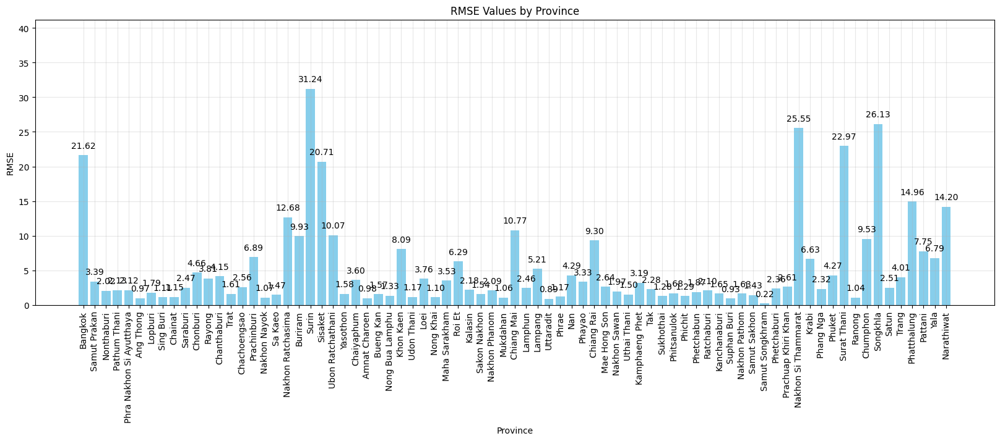

In [102]:
total_rmse = sum(pvrecord.values())
print(f"Total RMSE: {total_rmse}")

# Creating a bar plot
fig, ax = plt.subplots(figsize=(20, 6))
ax.bar(pvrecord.keys(), pvrecord.values(), color='skyblue')
ax.set_xlabel('Province')
ax.set_ylabel('RMSE')
ax.set_title('RMSE Values by Province')
ax.set_ylim(0, max(pvrecord.values()) + 10)

# Rotate the x-axis labels
plt.xticks(rotation=90)

# Adding the RMSE values on top of the bars
for i, v in enumerate(pvrecord.values()):
    ax.text(i, v + 1, f'{v:.2f}', ha='center')

# Display the plot
plt.grid(alpha=0.3)
plt.show()


                          pvrecord1  pvrecord2  Difference
Bangkok                   39.237940  21.615515   17.622425
Samut Prakan              10.166167   3.394447    6.771720
Nonthaburi                 6.438547   2.023188    4.415359
Pathum Thani               7.223014   2.130459    5.092555
Phra Nakhon Si Ayutthaya   8.790417   2.123291    6.667126
...                             ...        ...         ...
Trang                      6.625346   4.011660    2.613686
Phatthalung                5.027620  14.960786   -9.933166
Pattani                    4.470106   7.754023   -3.283918
Yala                       4.404534   6.788124   -2.383590
Narathiwat                 3.619616  14.199608  -10.579992

[77 rows x 3 columns]


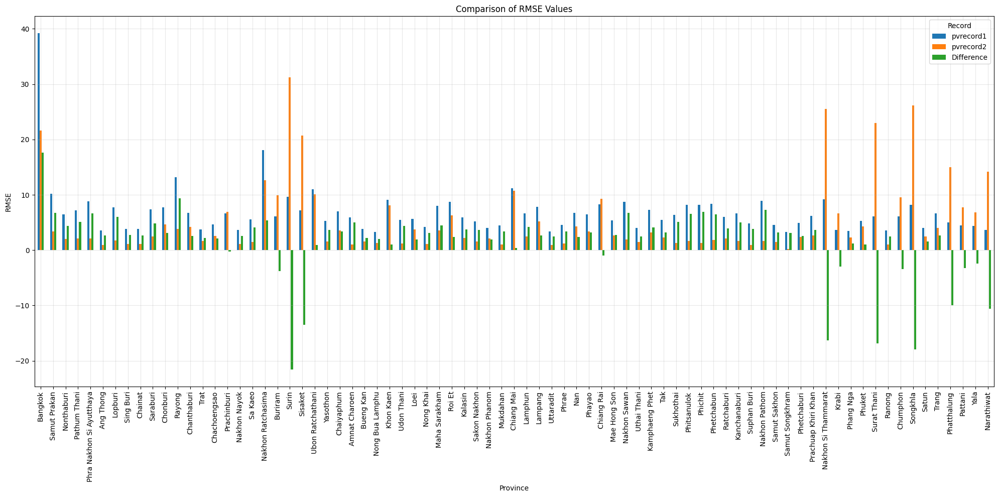

In [104]:
pvrecord0  = {'Bangkok': 76.36063676449949,
 'Samut Prakan': 13.049635977070057,
 'Nonthaburi': 7.249497713985841,
 'Pathum Thani': 8.574577749408144,
 'Phra Nakhon Si Ayutthaya': 8.763172056558089,
 'Ang Thong': 3.5622489642936315,
 'Lopburi': 7.394539554350971,
 'Sing Buri': 6.253745392561713,
 'Chainat': 4.850372128317462,
 'Saraburi': 9.004934429518402,
 'Chonburi': 10.784751151284173,
 'Rayong': 29.29362612877891,
 'Chanthaburi': 9.039207586402009,
 'Trat': 8.967513750095625,
 'Chachoengsao': 10.776458397495487,
 'Prachinburi': 10.575305865941772,
 'Nakhon Nayok': 3.652860249914554,
 'Sa Kaeo': 8.265378298643776,
 'Nakhon Ratchasima': 24.678096716895894,
 'Buriram': 10.444504297959122,
 'Surin': 24.616549364792785,
 'Sisaket': 12.624889186982282,
 'Ubon Ratchathani': 18.02407231485729,
 'Yasothon': 5.259409681477039,
 'Chaiyaphum': 19.807608785001023,
 'Amnat Charoen': 5.878235959045015,
 'Bueng Kan': 3.7951607901835005,
 'Nong Bua Lamphu': 3.327853211591088,
 'Khon Kaen': 18.12098161888682,
 'Udon Thani': 6.412187338357021,
 'Loei': 5.8572859313625605,
 'Nong Khai': 4.296222163775307,
 'Maha Sarakham': 7.971467665882491,
 'Roi Et': 9.630361738476637,
 'Kalasin': 6.6386293797418015,
 'Sakon Nakhon': 5.16666162320079,
 'Nakhon Phanom': 4.059842034208891,
 'Mukdahan': 4.6688712445788125,
 'Chiang Mai': 15.419972781224041,
 'Lamphun': 7.53656421144407,
 'Lampang': 7.957290790165344,
 'Uttaradit': 3.397264339792317,
 'Phrae': 4.495905692917569,
 'Nan': 9.740079675824619,
 'Phayao': 6.372662040035755,
 'Chiang Rai': 11.936946678828246,
 'Mae Hong Son': 5.371809629955286,
 'Nakhon Sawan': 11.906167302534225,
 'Uthai Thani': 3.9118348052198804,
 'Kamphaeng Phet': 9.525922515895905,
 'Tak': 5.464342176058535,
 'Sukhothai': 9.421698008380176,
 'Phitsanulok': 9.6757096172131,
 'Phichit': 8.118654864730004,
 'Phetchabun': 8.282681051272142,
 'Ratchaburi': 5.9871252340905965,
 'Kanchanaburi': 6.699083833956905,
 'Suphan Buri': 4.831099975430087,
 'Nakhon Pathom': 9.182769187059774,
 'Samut Sakhon': 4.596189361292357,
 'Samut Songkhram': 3.317848658454171,
 'Phetchaburi': 4.91742565067919,
 'Prachuap Khiri Khan': 9.82226000037338,
 'Nakhon Si Thammarat': 14.892790755064764,
 'Krabi': 5.511365974780709,
 'Phang Nga': 3.48083277749657,
 'Phuket': 5.265380505321653,
 'Surat Thani': 15.433859756576167,
 'Ranong': 3.5370765485472693,
 'Chumphon': 7.3176919374148035,
 'Songkhla': 11.556063031083653,
 'Satun': 4.058941239721519,
 'Trang': 6.62534554042965,
 'Phatthalung': 6.907408901052155,
 'Pattani': 4.455146604571581,
 'Yala': 5.440995573277607,
 'Narathiwat': 4.089186511786015}

pvrecord1  = {'Bangkok': 39.23794010974002,
 'Samut Prakan': 10.166167116762558,
 'Nonthaburi': 6.438546710645192,
 'Pathum Thani': 7.223013573266722,
 'Phra Nakhon Si Ayutthaya': 8.790417107404064,
 'Ang Thong': 3.588964622360581,
 'Lopburi': 7.7765270352184315,
 'Sing Buri': 3.871741006042545,
 'Chainat': 3.814785125760958,
 'Saraburi': 7.342297229416183,
 'Chonburi': 7.737617588243486,
 'Rayong': 13.218722445420894,
 'Chanthaburi': 6.719756876386463,
 'Trat': 3.7734066171864917,
 'Chachoengsao': 4.652566579209719,
 'Prachinburi': 6.6056278793465,
 'Nakhon Nayok': 3.6528602519031965,
 'Sa Kaeo': 5.575370759440385,
 'Nakhon Ratchasima': 18.058206829415482,
 'Buriram': 6.09719570249447,
 'Surin': 9.651037522096336,
 'Sisaket': 7.1902850356626775,
 'Ubon Ratchathani': 10.9947399822635,
 'Yasothon': 5.259409681477039,
 'Chaiyaphum': 6.986343350571975,
 'Amnat Charoen': 5.965155752019958,
 'Bueng Kan': 3.795099026970346,
 'Nong Bua Lamphu': 3.327853211591088,
 'Khon Kaen': 9.085570610846142,
 'Udon Thani': 5.506419662001304,
 'Loei': 5.68791236110198,
 'Nong Khai': 4.221642355429842,
 'Maha Sarakham': 7.971294758469244,
 'Roi Et': 8.705422231574858,
 'Kalasin': 5.883256080259316,
 'Sakon Nakhon': 5.173248790364447,
 'Nakhon Phanom': 4.029618858229757,
 'Mukdahan': 4.433071167366718,
 'Chiang Mai': 11.168174967712858,
 'Lamphun': 6.613175825838823,
 'Lampang': 7.8257110785908806,
 'Uttaradit': 3.407559889807749,
 'Phrae': 4.554907928774935,
 'Nan': 6.6971402509959965,
 'Phayao': 6.503879832812334,
 'Chiang Rai': 8.292998313562533,
 'Mae Hong Son': 5.356883066846493,
 'Nakhon Sawan': 8.71397352735358,
 'Uthai Thani': 3.970558824132814,
 'Kamphaeng Phet': 7.294665567627883,
 'Tak': 5.464342427832331,
 'Sukhothai': 6.380434604275281,
 'Phitsanulok': 8.204286529281493,
 'Phichit': 8.185863175596678,
 'Phetchabun': 8.367170420732949,
 'Ratchaburi': 5.9871252340905965,
 'Kanchanaburi': 6.67740614140352,
 'Suphan Buri': 4.794184458062974,
 'Nakhon Pathom': 8.896198958690979,
 'Samut Sakhon': 4.596189361292357,
 'Samut Songkhram': 3.3178486706368284,
 'Phetchaburi': 4.91742565067919,
 'Prachuap Khiri Khan': 6.219526766900077,
 'Nakhon Si Thammarat': 9.219175949927125,
 'Krabi': 3.630385827362823,
 'Phang Nga': 3.48083277749657,
 'Phuket': 5.265380505321653,
 'Surat Thani': 6.137177691147416,
 'Ranong': 3.5370765485472693,
 'Chumphon': 6.112417766452195,
 'Songkhla': 8.192380983732399,
 'Satun': 4.058941239721519,
 'Trang': 6.62534554042965,
 'Phatthalung': 5.027619864847653,
 'Pattani': 4.470105758413418,
 'Yala': 4.404534202722687,
 'Narathiwat': 3.6196155450344247}

pvrecord2 = {'Bangkok': 21.6155148122598,
 'Samut Prakan': 3.3944466442966936,
 'Nonthaburi': 2.023187642429028,
 'Pathum Thani': 2.1304585961683307,
 'Phra Nakhon Si Ayutthaya': 2.123290632423773,
 'Ang Thong': 0.9670711168195607,
 'Lopburi': 1.7906862385845088,
 'Sing Buri': 1.112454920458186,
 'Chainat': 1.1486345953229538,
 'Saraburi': 2.4741065824312343,
 'Chonburi': 4.661940398322936,
 'Rayong': 3.8114428120179986,
 'Chanthaburi': 4.154991723962313,
 'Trat': 1.6122247300776535,
 'Chachoengsao': 2.561720513017153,
 'Prachinburi': 6.894694140583732,
 'Nakhon Nayok': 1.0740776576204314,
 'Sa Kaeo': 1.4712557441481409,
 'Nakhon Ratchasima': 12.68009854832767,
 'Buriram': 9.926598192193035,
 'Surin': 31.23519182185033,
 'Sisaket': 20.712085337864636,
 'Ubon Ratchathani': 10.072394225854802,
 'Yasothon': 1.580889487410023,
 'Chaiyaphum': 3.5956714699044117,
 'Amnat Charoen': 0.9797916706265546,
 'Bueng Kan': 1.5723039779737367,
 'Nong Bua Lamphu': 1.3307910891235974,
 'Khon Kaen': 8.085897799339794,
 'Udon Thani': 1.167462077552045,
 'Loei': 3.7583560500957116,
 'Nong Khai': 1.0979376124307325,
 'Maha Sarakham': 3.5254873624798875,
 'Roi Et': 6.2877829030512755,
 'Kalasin': 2.184077897293447,
 'Sakon Nakhon': 1.5393463698699374,
 'Nakhon Phanom': 2.085918151367566,
 'Mukdahan': 1.055630406826392,
 'Chiang Mai': 10.771599815300954,
 'Lamphun': 2.4581773171597314,
 'Lampang': 5.206284340428799,
 'Uttaradit': 0.8943704622286672,
 'Phrae': 1.174548511164456,
 'Nan': 4.290140908527044,
 'Phayao': 3.333670187311755,
 'Chiang Rai': 9.298064047216055,
 'Mae Hong Son': 2.6439388895959,
 'Nakhon Sawan': 1.9683477321530436,
 'Uthai Thani': 1.50217077621016,
 'Kamphaeng Phet': 3.190883201217457,
 'Tak': 2.2848638240261017,
 'Sukhothai': 1.2808851428622705,
 'Phitsanulok': 1.6779362531897022,
 'Phichit': 1.2943102281414638,
 'Phetchabun': 1.8661826660724872,
 'Ratchaburi': 2.0957481723906524,
 'Kanchanaburi': 1.652356657653298,
 'Suphan Buri': 0.9253846706736347,
 'Nakhon Pathom': 1.629491843572152,
 'Samut Sakhon': 1.4290450097175769,
 'Samut Songkhram': 0.22436360099259522,
 'Phetchaburi': 2.3577338396019565,
 'Prachuap Khiri Khan': 2.610216401085868,
 'Nakhon Si Thammarat': 25.546459070365202,
 'Krabi': 6.625753079405019,
 'Phang Nga': 2.3182215624317744,
 'Phuket': 4.270444838739774,
 'Surat Thani': 22.96867020437724,
 'Ranong': 1.04100102713792,
 'Chumphon': 9.531652581144447,
 'Songkhla': 26.12875152596002,
 'Satun': 2.5063877949300797,
 'Trang': 4.011659615827312,
 'Phatthalung': 14.960786348737983,
 'Pattani': 7.754023325621289,
 'Yala': 6.788124032651864,
 'Narathiwat': 14.199607815750165}
 # Create a DataFrame from the dictionaries
comparison_df = pd.DataFrame([pvrecord1, pvrecord2], index=['pvrecord1', 'pvrecord2']).T
comparison_df['Difference'] = comparison_df['pvrecord1'] - comparison_df['pvrecord2']

# Display the DataFrame
print(comparison_df)

# Create a bar plot to visualize the comparison
comparison_df.plot(kind='bar', figsize=(20, 10))
plt.title('Comparison of RMSE Values')
plt.xlabel('Province')
plt.ylabel('RMSE')
plt.xticks(rotation=90)
plt.legend(title='Record')
plt.tight_layout()
plt.grid(alpha=0.3)
# Show the plot
plt.show()